In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import copy

import math
import torch
from torch.nn.modules.transformer import TransformerEncoder, TransformerEncoderLayer
from torch.nn.modules import LayerNorm, Linear, ReLU
import torch.nn as nn
import torch.nn.functional as F
import sklearn.metrics
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import pickle
from torch.utils.data import DataLoader

from torch.utils.data import DataLoader
import torch.nn.functional as F
import numpy as np
import torch
from sklearn.metrics import pairwise_distances
from sklearn.neighbors import NearestNeighbors


device = 'cuda' if torch.cuda.is_available() else 'cpu'


# Data Loader

In [2]:
X = np.load('/kaggle/input/active-learning-subset/tar_image_subset.npy') 
y = np.load('/kaggle/input/active-learning-subset/label_target_subset.npy')


test_size = 20/100
X_pool, X_val, y_pool, y_val = train_test_split(X, y, test_size=test_size, stratify=y, random_state=42)

print(f"X shape: {X.shape}")
print(f"y shape: {y.shape}")
print(f"X_val shape: {X_val.shape}")
print(f"y_val  shape: {y_val .shape}")


X shape: (20000, 6, 28)
y shape: (20000,)
X_val shape: (4000, 6, 28)
y_val  shape: (4000,)


In [3]:
y_sample = y
X_sample = X

# Label distribution
label_counts = Counter(y_sample)
df_labels = pd.DataFrame.from_dict(label_counts, orient='index').sort_index()
df_labels.columns = ['count']
df_labels['percent'] = 100 * df_labels['count'] / len(y_sample)
print("\nLabel distribution:")
print(df_labels)

channel_variance = np.var(X_sample, axis=2).mean(axis=0)
channel_mean = X_sample.mean(axis=(0, 2))
channel_std = X_sample.std(axis=(0, 2))
df_stats = pd.DataFrame({
    'channel': range(6),
    'mean': channel_mean,
    'std_dev': channel_std,
    'variance': channel_variance
})
print("\nMean, Std Dev and Variance per Channel:")
print(df_stats)


Label distribution:
   count  percent
0   9081   45.405
1   2603   13.015
2   8316   41.580

Mean, Std Dev and Variance per Channel:
   channel      mean   std_dev  variance
0        0  0.004546  0.999189  0.730689
1        1  0.004955  0.999538  0.721030
2        2  0.003958  1.000457  0.755685
3        3  0.001807  1.000751  0.783507
4        4  0.001153  1.000271  0.634434
5        5  0.001723  1.000909  0.731176


In [4]:
# Total number of samples
total_samples = sum(label_counts.values())

# Number of classes
num_classes = max(label_counts.keys()) + 1  # assuming labels start from 0

# Compute weight for each class as inverse frequency
class_weights = []
for i in range(num_classes):
    count = label_counts.get(i, 0)
    if count == 0:
        class_weights.append(0.0)  # or very small value like 1e-6
    else:
        class_weights.append(total_samples / (num_classes * count))

# Convert to torch tensor for CE loss
class_weights = torch.tensor(class_weights, dtype=torch.float32).to(device)


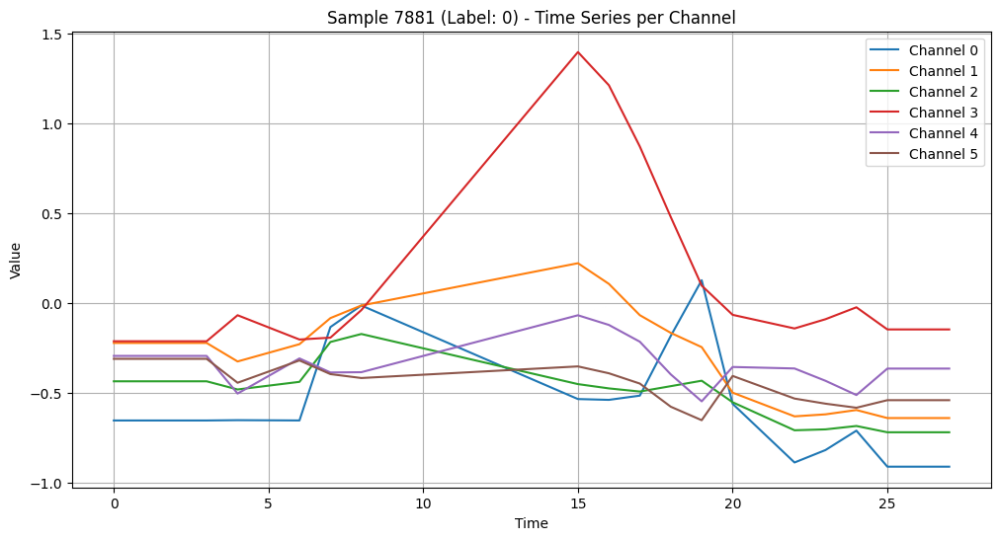

In [5]:
i = np.random.randint(0, len(X))
sample = X[i]  # Shape: (6, T)

plt.figure(figsize=(12, 6))
for c in range(6):
    plt.plot(sample[c], label=f'Channel {c}')
plt.title(f"Sample {i} (Label: {y[i]}) - Time Series per Channel")
plt.xlabel("Time")
plt.ylabel("Value")
plt.legend()
plt.grid(True)
plt.show()

# Dataloader

In [6]:
class Dataset():
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.long)

    def __getitem__(self, index):
        return {
            "x": self.X[index],  # shape: [C, T]
            "y": self.y[index]
        }

    def __len__(self):
        return len(self.X)

# Model

In [7]:
################ CNN Backbone 
def conv_block(in_channels: int, out_channels: int, dropout=0.3) -> nn.Module:
    return nn.Sequential(
        nn.Conv1d(in_channels, out_channels, 5, padding='same'),
        nn.BatchNorm1d(out_channels),
        nn.ReLU(),
        nn.Dropout(dropout),
    )

class cnn(nn.Module):
    def __init__(self):
        super(cnn, self).__init__()
        self.conv1 = conv_block(6, 64)
        self.conv2 = conv_block(64, 128)
        self.conv3 = conv_block(128, 256)
        self.conv4 = conv_block(256, 512)
        self.conv5 = conv_block(512, 1024)
        self.global_pool = nn.AdaptiveAvgPool1d(1)

    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.global_pool(x)
        x = x.view(x.size(0), -1)
        return x

 
################ Fully connected network
class FC(nn.Module):
    def __init__(self, input_dim):
        super(FC, self).__init__()
        self.dropout = nn.Dropout(0.5)
        self.fco = nn.Linear(input_dim, 3)

    def forward(self, x):
        x = self.dropout(x)
        x = self.fco(x)
        return x



class FullModel(nn.Module):
    def __init__(self, backbone, fc):
        super().__init__()
        self.backbone = backbone
        self.fc = fc

    def forward(self, x):
        feat = self.backbone(x)
        out = self.fc(feat)
        return feat, out

# Loading weights

In [8]:
#pretrained weights
map_location=torch.device(device)

backbone = cnn()
fc = FC(1024)

#loading backbone weights
state_dict = torch.load('/kaggle/input/active-learning-subset/backboneSiteA2019.pth', map_location=map_location)
# Remove "module." prefix
new_state_dict = {}
for k, v in state_dict.items():
    new_key = k.replace("module.", "")  # remove module. prefix
    new_state_dict[new_key] = v

backbone.load_state_dict(new_state_dict)

#loading fc weights
state_dict = torch.load('/kaggle/input/active-learning-subset/fcSiteA2019.pth', map_location=map_location)
# Remove "module." prefix
new_state_dict = {}
for k, v in state_dict.items():
    new_key = k.replace("module.", "")  # remove module. prefix
    new_state_dict[new_key] = v

fc.load_state_dict(new_state_dict)

model = FullModel(backbone, fc).to(device)
initial_state_dict = copy.deepcopy(model.state_dict())

# Train/eval loop

In [9]:
def train_one_epoch(model, dataloader, optimizer, criterion, device):
    model.train()
    total_loss, all_preds, all_targets = 0, [], []

    for batch in dataloader:
        x, y = batch["x"].to(device), batch["y"].to(device)

        optimizer.zero_grad()
        _, out = model(x)
        loss = criterion(out, y)
        loss.backward()
        optimizer.step()

        total_loss += loss.item() * len(x)
        preds = torch.argmax(out, dim=1)
        all_preds.extend(preds.cpu().numpy())
        all_targets.extend(y.cpu().numpy())

    avg_loss = total_loss / len(dataloader.dataset)
    acc = np.mean(np.array(all_preds) == np.array(all_targets))
    f1s = sklearn.metrics.f1_score(all_targets, all_preds, average=None)
    return avg_loss, acc, f1s, np.mean(f1s)



def _eval_perf(model, dataloader, device, criterion=None):
    model.eval()
    pred, gt = [], []
    total_loss = 0

    with torch.no_grad():
        for batch in dataloader:
            x, y = batch["x"].to(device), batch["y"].to(device)
            _, outputs = model(x)
            preds = torch.argmax(outputs, dim=1)
            if criterion:
                total_loss += criterion(outputs, y).item() * len(x)

            pred.extend(preds.cpu().numpy())
            gt.extend(y.cpu().numpy())

    acc = np.mean(np.array(pred) == np.array(gt))
    f1s = sklearn.metrics.f1_score(gt, pred, average=None)
    avg_f1 = np.mean(f1s)

    if criterion:
        avg_loss = total_loss / len(dataloader.dataset)
        return avg_loss, f1s, acc, avg_f1
    else:
        return 0, f1s, acc, avg_f1



class LabelSmoothingCrossEntropy(nn.Module):
    def __init__(self, weight=None, smoothing=0.1):
        super().__init__()
        self.weight = weight
        self.smoothing = smoothing
        self.confidence = 1.0 - smoothing

    def forward(self, pred, target):
        log_probs = F.log_softmax(pred, dim=-1)
        nll_loss = -log_probs.gather(dim=-1, index=target.unsqueeze(1)).squeeze(1)
        smooth_loss = -log_probs.mean(dim=-1)
        loss = self.confidence * nll_loss + self.smoothing * smooth_loss
        if self.weight is not None:
            loss = loss * self.weight[target]
        return loss.mean()

# Active Learning methods

In [10]:
def plot_round_metrics(history):
    round_id = len(history["epoch_metrics"]) - 1
    epoch_stats = history["epoch_metrics"][round_id]
    epochs = list(range(1, len(epoch_stats) + 1))

    train_loss = [e["train_loss"] for e in epoch_stats]
    val_loss = [e["val_loss"] for e in epoch_stats]
    train_acc = [e["train_acc"] for e in epoch_stats]
    train_f1 = [e["train_avg_f1"] for e in epoch_stats]
    val_acc = [e["val_acc"] for e in epoch_stats]
    val_f1 = [e["val_avg_f1"] for e in epoch_stats]

    plt.figure(figsize=(15, 4))

    # Loss plot
    plt.subplot(1, 3, 1)
    plt.plot(epochs, train_loss, label="Train Loss")
    plt.plot(epochs, val_loss, label="Val Loss")
    plt.title(f"[Round {round_id+1}] Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()

    # Accuracy plot
    plt.subplot(1, 3, 2)
    plt.plot(epochs, train_acc, label="Train Acc")
    plt.plot(epochs, val_acc, label="Val Acc")
    plt.title(f"[Round {round_id+1}] Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend()

    # Avg F1 plot
    plt.subplot(1, 3, 3)
    plt.plot(epochs, train_f1, label="Train F1")
    plt.plot(epochs, val_f1, label="Val F1")
    plt.title(f"[Round {round_id+1}] Avg F1")
    plt.xlabel("Epoch")
    plt.ylabel("Avg F1")
    plt.legend()

    plt.tight_layout()
    plt.show()



def plot_final_performance(history):
    samples = history["samples"]
    val_acc = history["round_val_acc"]
    val_f1 = history["round_val_avg_f1"]

    plt.figure(figsize=(10, 4))

    plt.subplot(1, 2, 1)
    plt.plot(samples, val_acc, marker='o')
    plt.title("Val Accuracy vs Labeled Samples")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Accuracy")

    plt.subplot(1, 2, 2)
    plt.plot(samples, val_f1, marker='o')
    plt.title("Val Avg F1 vs Labeled Samples")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Avg F1")

    plt.tight_layout()
    plt.show()


In [11]:
def query_samples(model, dataset, query_size, strategy, device, already_selected_idx=None):
    model.eval()
    dataloader = DataLoader(dataset, batch_size=128)
    all_scores = []
    all_features = []
    if already_selected_idx is None:
        already_selected_idx = []

    with torch.no_grad():
        for batch in dataloader:
            x = batch["x"].to(device)
            features, out = model(x)
            probs = F.softmax(out, dim=1)

            if strategy in ["entropy", "least_confident", "margin", "random", "entropy_diversity"]:
                score = None
                if strategy in ["entropy", "entropy_diversity"]:
                    score = -torch.sum(probs * torch.log(probs + 1e-10), dim=1)
                elif strategy == "least_confident":
                    score = 1 - probs.max(dim=1)[0]
                elif strategy == "margin":
                    sorted_probs, _ = probs.sort(dim=1, descending=True)
                    score = -(sorted_probs[:, 0] - sorted_probs[:, 1])
                elif strategy == "random":
                    score = torch.rand(len(x), device=device)

                all_scores.extend(score.cpu().numpy())

            if strategy in ["diversity", "density", "entropy_diversity"]:
                all_features.append(features.cpu().numpy())

    if strategy in ["entropy", "least_confident", "margin", "random"]:
        indices = np.argsort(all_scores)[-query_size:]
        return indices

    all_features = np.concatenate(all_features, axis=0)

    if strategy == "diversity":
        # Core-set (k-Center Greedy)
        if already_selected_idx is None or len(already_selected_idx) == 0:
            selected = [np.random.randint(len(all_features))]
        else:
            selected = already_selected_idx.copy()

        selected_features = all_features[selected]
        remaining = list(set(range(len(all_features))) - set(selected))

        for _ in range(query_size):
            dists = pairwise_distances(all_features[remaining], selected_features, metric="euclidean")
            min_dists = np.min(dists, axis=1)
            next_idx = remaining[np.argmax(min_dists)]
            selected.append(next_idx)
            selected_features = np.vstack([selected_features, all_features[next_idx].reshape(1, -1)])
            remaining.remove(next_idx)

        new_indices = list(set(selected) - set(already_selected_idx))[-query_size:]
        return np.array(new_indices)

    elif strategy == "density":
        if all_features.shape[1] > 64:
            from sklearn.decomposition import PCA
            pca = PCA(n_components=64)
            all_features = pca.fit_transform(all_features)

        all_features = all_features.astype(np.float32)
        nbrs = NearestNeighbors(n_neighbors=6, algorithm='auto', metric='euclidean').fit(all_features)
        distances, _ = nbrs.kneighbors(all_features)
        avg_neighbor_dist = distances[:, 1:].mean(axis=1)
        density_scores = -avg_neighbor_dist
        indices = np.argsort(density_scores)[-query_size:]
        return indices

    elif strategy == "entropy_diversity":
        # Hybrid: Select top-2×query_size most uncertain samples, then apply core-set
        all_scores = np.array(all_scores)
        all_features = np.array(all_features)

        top_uncertain_idx = np.argsort(all_scores)[-2 * query_size:]
        uncertain_features = all_features[top_uncertain_idx]

        # Core-set on uncertain samples
        selected = [np.random.randint(len(uncertain_features))]
        selected_features = uncertain_features[selected]
        remaining = list(set(range(len(uncertain_features))) - set(selected))

        for _ in range(query_size - 1):
            dists = pairwise_distances(uncertain_features[remaining], selected_features, metric="euclidean")
            min_dists = np.min(dists, axis=1)
            next_idx = remaining[np.argmax(min_dists)]
            selected.append(next_idx)
            selected_features = np.vstack([selected_features, uncertain_features[next_idx].reshape(1, -1)])
            remaining.remove(next_idx)

        final_indices = top_uncertain_idx[selected]
        return np.array(final_indices)


# Active Learning Loop

In [12]:
def active_learning_loop(model, labeled_dataset, unlabeled_dataset, val_dataset, strategy, device, iters=10, query_size=100, final_epochs=5):
    
    criterion = LabelSmoothingCrossEntropy(weight=class_weights, smoothing=0.1)
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)

    
    history = {
        "strategy": strategy,
        "samples": [],
        "epoch_metrics": [],
        "round_val_acc": [],
        "round_val_avg_f1": []
    }

    for it in range(iters):
        print(f"\n[AL Round {it+1}/{iters}] — Labeled samples: {len(labeled_dataset)}")

        train_loader = DataLoader(labeled_dataset, batch_size=64, shuffle=True)
        val_loader = DataLoader(val_dataset, batch_size=64)

        epoch_stats = []

        if it <= 3:
            epochs = 5
        elif 4 <= it <= 10:
            epochs = 10
        elif 11 <= it:
            epochs = final_epochs
        else:
            epochs = final_epochs
        
        for ep in tqdm(range(epochs), desc="Epoch", leave=False):
            tr_loss, tr_acc, tr_f1s, tr_avgf1 = train_one_epoch(model, train_loader, optimizer, criterion, device)
            val_loss, val_f1s, val_acc, val_avgf1 = _eval_perf(model, val_loader, device, criterion)

            epoch_stats.append({
                "train_loss": tr_loss,
                "train_acc": tr_acc,
                "train_avg_f1": tr_avgf1,
                "val_loss": val_loss,
                "val_acc": val_acc,
                "val_avg_f1": val_avgf1
            })

        history["samples"].append(len(labeled_dataset))
        history["epoch_metrics"].append(epoch_stats)
        history["round_val_acc"].append(val_acc)
        history["round_val_avg_f1"].append(val_avgf1)

        # Query next samples
        if len(unlabeled_dataset) < query_size:
            print("Unlabeled pool exhausted.")
            break

        selected_idxs = query_samples(model, unlabeled_dataset, query_size, strategy, device)

        new_x = [unlabeled_dataset.X[i] for i in selected_idxs]
        new_y = [unlabeled_dataset.y[i] for i in selected_idxs]

        labeled_dataset.X = torch.cat([labeled_dataset.X, torch.stack(new_x)], dim=0)
        labeled_dataset.y = torch.cat([labeled_dataset.y, torch.tensor(new_y)], dim=0)

        keep_idxs = list(set(range(len(unlabeled_dataset))) - set(selected_idxs))
        unlabeled_dataset.X = torch.stack([unlabeled_dataset.X[i] for i in keep_idxs])
        unlabeled_dataset.y = torch.tensor([unlabeled_dataset.y[i] for i in keep_idxs])

        print(f"\nEpoch {epochs}/{epochs}")
        print(f"Train — Loss: {tr_loss:.4f} | Acc: {tr_acc:.4f} | Avg F1: {tr_avgf1:.4f}")
        print(f"Val   — Loss: {val_loss:.4f} | Acc: {val_acc:.4f} | Avg F1: {val_avgf1:.4f}")

        
        plot_round_metrics(history)

    plot_final_performance(history)
    return history


X_labeled shape: (100, 6, 28)
y_labeled shape: (100,)
X_unlabeled shape: (15900, 6, 28)
y_unlabeled shape: (15900,)

=== Running strategy: RANDOM ===

[AL Round 1/20] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.5555 | Acc: 0.3500 | Avg F1: 0.3469
Val   — Loss: 1.2659 | Acc: 0.6398 | Avg F1: 0.6186


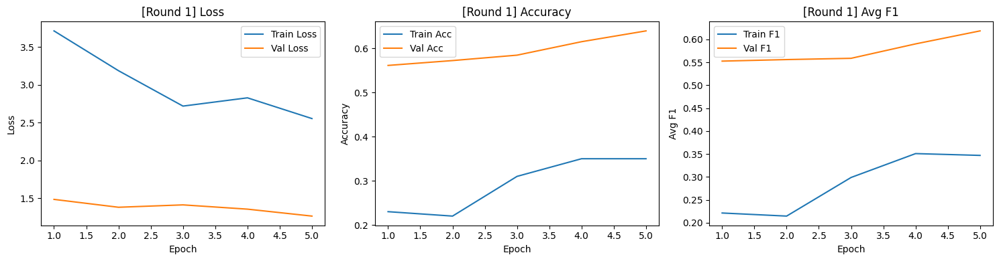


[AL Round 2/20] — Labeled samples: 110



Epoch 5/5
Train — Loss: 2.3466 | Acc: 0.4455 | Avg F1: 0.4447
Val   — Loss: 1.6213 | Acc: 0.6060 | Avg F1: 0.5924


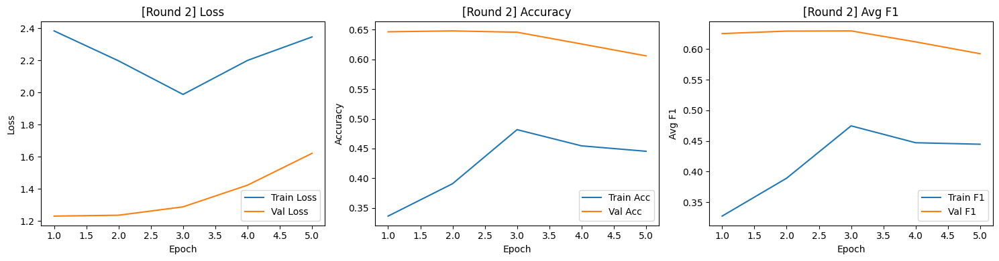


[AL Round 3/20] — Labeled samples: 120



Epoch 5/5
Train — Loss: 1.6757 | Acc: 0.6083 | Avg F1: 0.5970
Val   — Loss: 2.3365 | Acc: 0.6218 | Avg F1: 0.5842


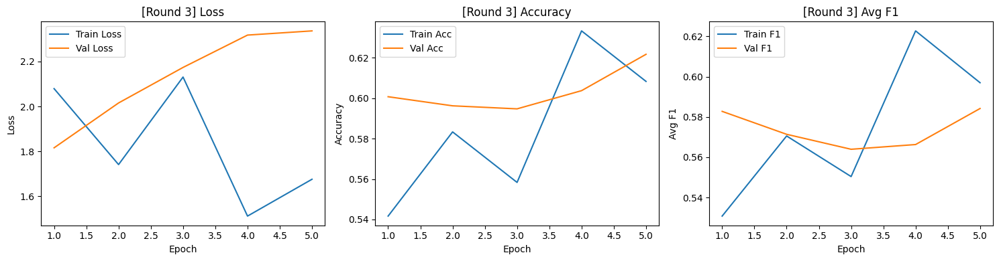


[AL Round 4/20] — Labeled samples: 130



Epoch 5/5
Train — Loss: 1.4938 | Acc: 0.5846 | Avg F1: 0.5731
Val   — Loss: 2.8513 | Acc: 0.6218 | Avg F1: 0.5877


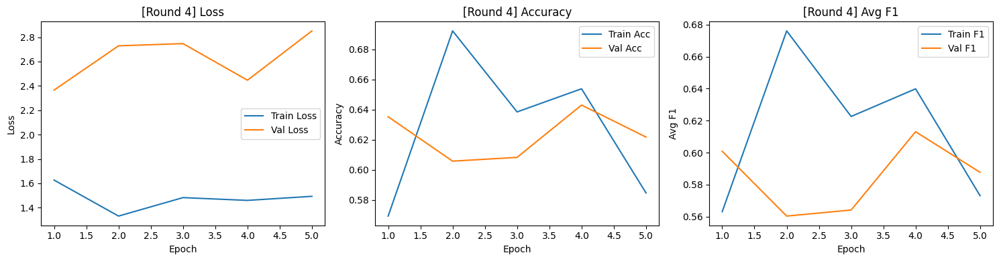


[AL Round 5/20] — Labeled samples: 140



Epoch 10/10
Train — Loss: 1.2862 | Acc: 0.7286 | Avg F1: 0.7083
Val   — Loss: 1.5082 | Acc: 0.7492 | Avg F1: 0.7308


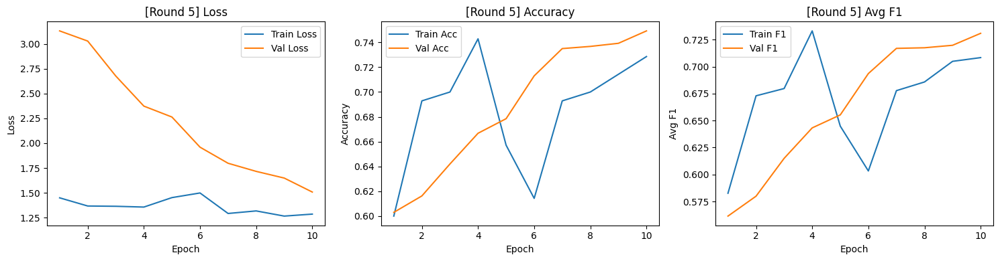


[AL Round 6/20] — Labeled samples: 150



Epoch 10/10
Train — Loss: 1.1486 | Acc: 0.7000 | Avg F1: 0.6868
Val   — Loss: 1.6431 | Acc: 0.7358 | Avg F1: 0.7144


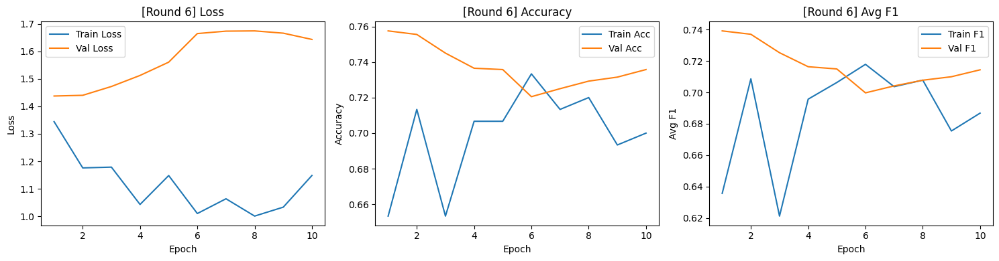


[AL Round 7/20] — Labeled samples: 160



Epoch 10/10
Train — Loss: 1.1087 | Acc: 0.7000 | Avg F1: 0.6959
Val   — Loss: 1.4367 | Acc: 0.7588 | Avg F1: 0.7469


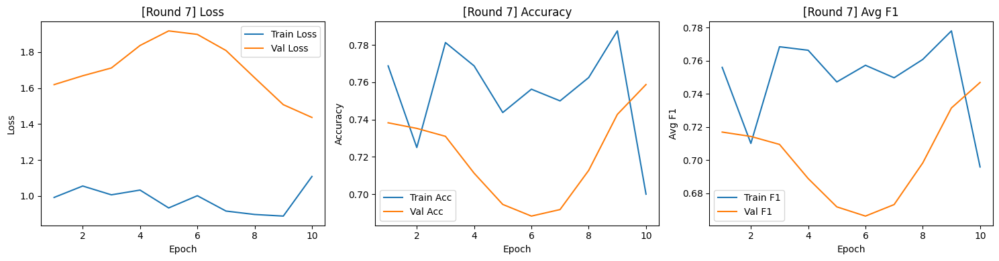


[AL Round 8/20] — Labeled samples: 170



Epoch 10/10
Train — Loss: 0.8848 | Acc: 0.7471 | Avg F1: 0.7463
Val   — Loss: 1.3990 | Acc: 0.7320 | Avg F1: 0.7101


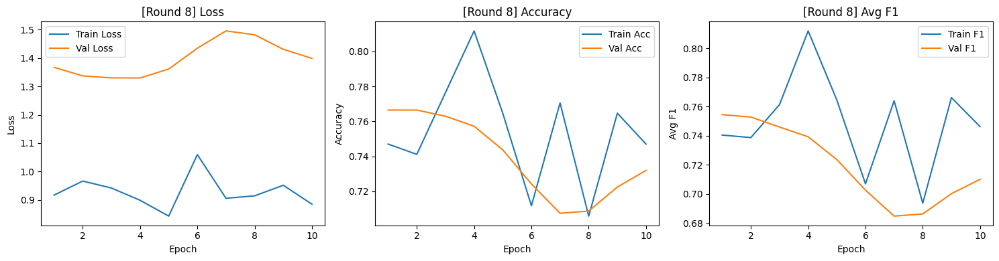


[AL Round 9/20] — Labeled samples: 180



Epoch 10/10
Train — Loss: 0.7877 | Acc: 0.7667 | Avg F1: 0.7652
Val   — Loss: 1.1535 | Acc: 0.7785 | Avg F1: 0.7618


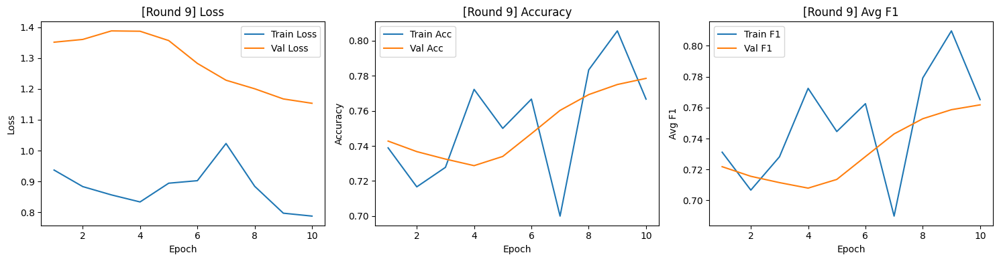


[AL Round 10/20] — Labeled samples: 190



Epoch 10/10
Train — Loss: 0.8180 | Acc: 0.7789 | Avg F1: 0.7726
Val   — Loss: 1.0410 | Acc: 0.7820 | Avg F1: 0.7682


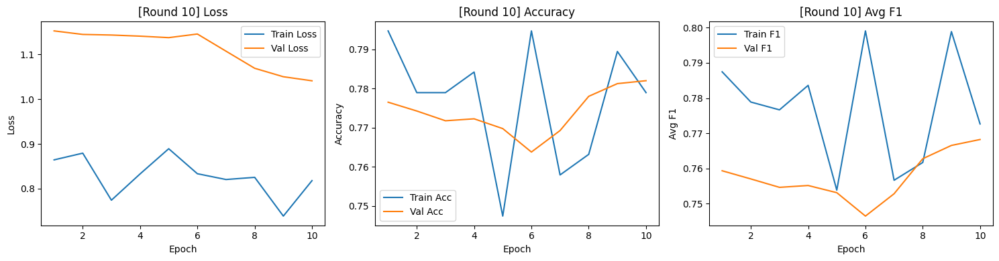


[AL Round 11/20] — Labeled samples: 200



Epoch 10/10
Train — Loss: 0.8104 | Acc: 0.7650 | Avg F1: 0.7640
Val   — Loss: 1.0864 | Acc: 0.7508 | Avg F1: 0.7442


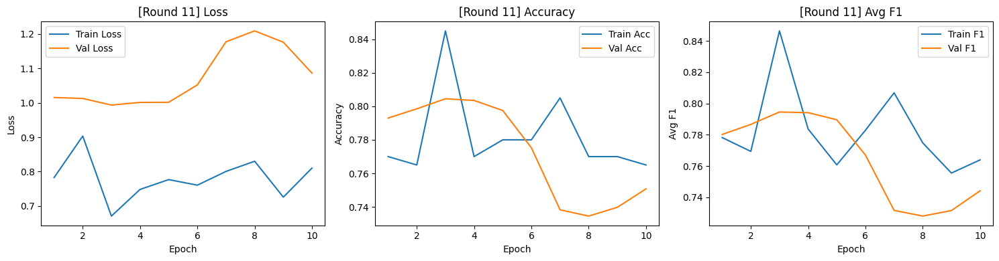


[AL Round 12/20] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.7093 | Acc: 0.7952 | Avg F1: 0.7996
Val   — Loss: 0.9461 | Acc: 0.7935 | Avg F1: 0.7917


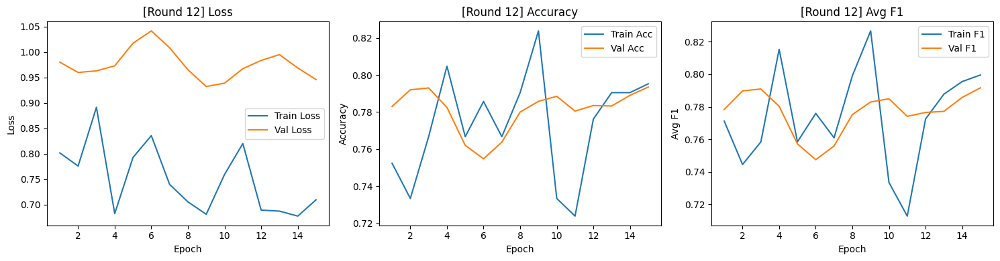


[AL Round 13/20] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.7076 | Acc: 0.7955 | Avg F1: 0.7930
Val   — Loss: 0.9094 | Acc: 0.8075 | Avg F1: 0.8081


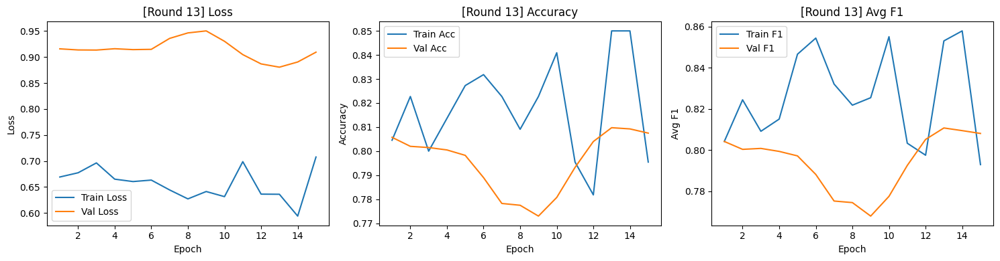


[AL Round 14/20] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.6133 | Acc: 0.8130 | Avg F1: 0.8308
Val   — Loss: 0.9316 | Acc: 0.7552 | Avg F1: 0.7594


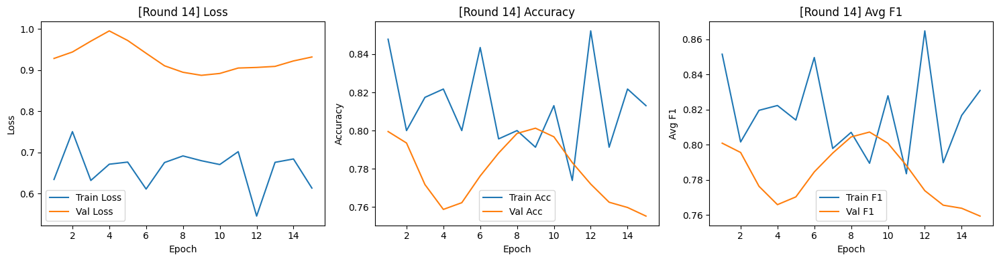


[AL Round 15/20] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.6625 | Acc: 0.8458 | Avg F1: 0.8476
Val   — Loss: 0.8627 | Acc: 0.7837 | Avg F1: 0.7871


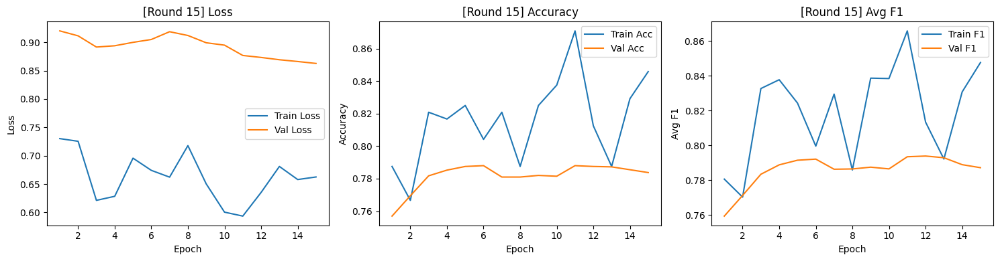


[AL Round 16/20] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.5806 | Acc: 0.8600 | Avg F1: 0.8662
Val   — Loss: 0.8825 | Acc: 0.7780 | Avg F1: 0.7902


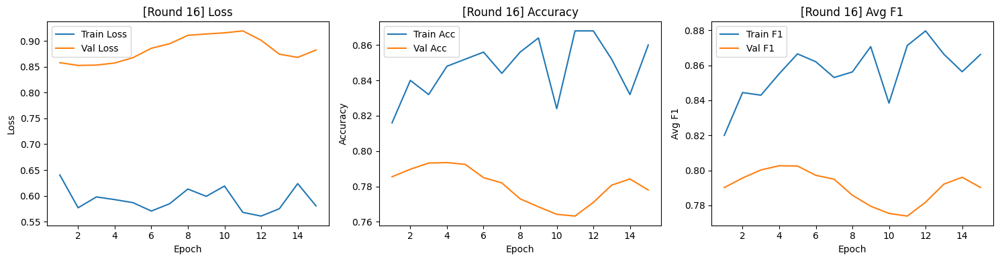


[AL Round 17/20] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.5580 | Acc: 0.8769 | Avg F1: 0.8725
Val   — Loss: 1.0781 | Acc: 0.7090 | Avg F1: 0.7152


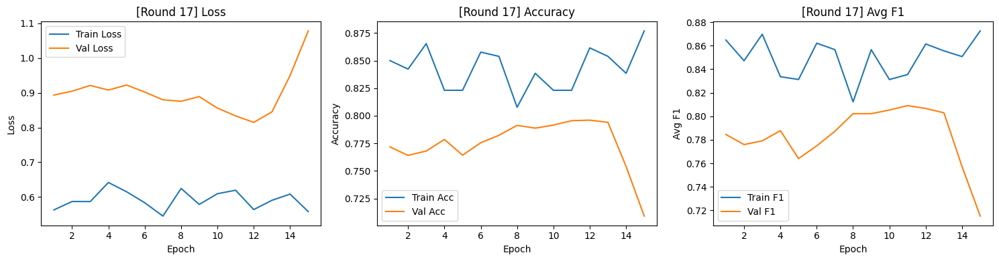


[AL Round 18/20] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.5173 | Acc: 0.8778 | Avg F1: 0.8789
Val   — Loss: 0.8287 | Acc: 0.7910 | Avg F1: 0.7982


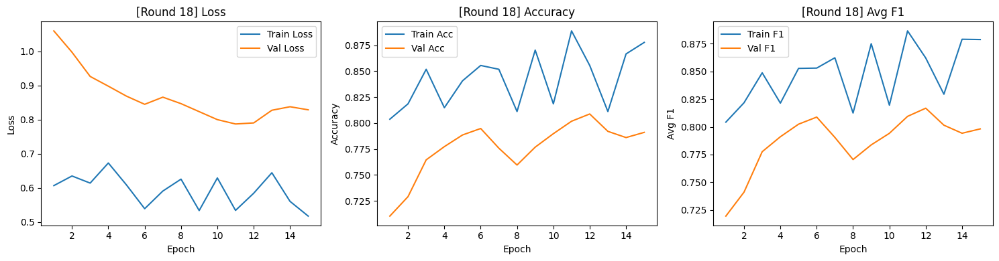


[AL Round 19/20] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.5990 | Acc: 0.8321 | Avg F1: 0.8418
Val   — Loss: 0.8097 | Acc: 0.7945 | Avg F1: 0.8058


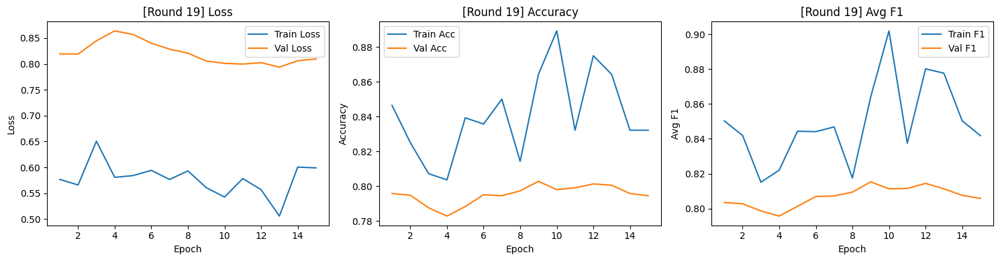


[AL Round 20/20] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.5281 | Acc: 0.8897 | Avg F1: 0.8950
Val   — Loss: 0.7691 | Acc: 0.8123 | Avg F1: 0.8197


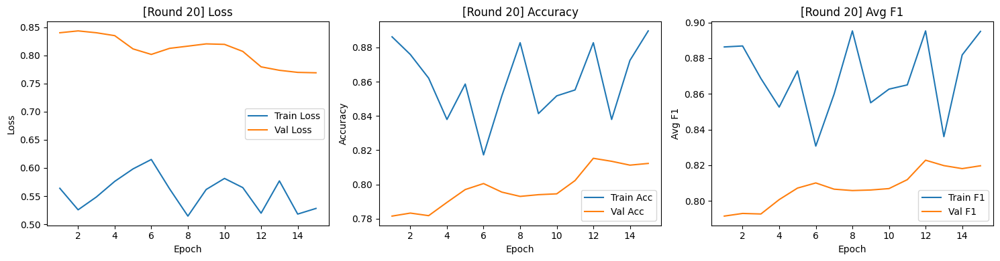

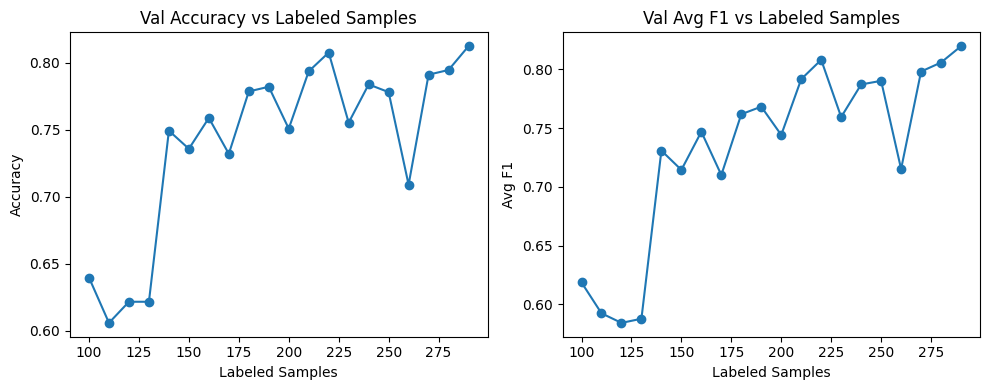


=== Running strategy: MARGIN ===

[AL Round 1/20] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.7891 | Acc: 0.3200 | Avg F1: 0.3173
Val   — Loss: 1.1196 | Acc: 0.6645 | Avg F1: 0.6484


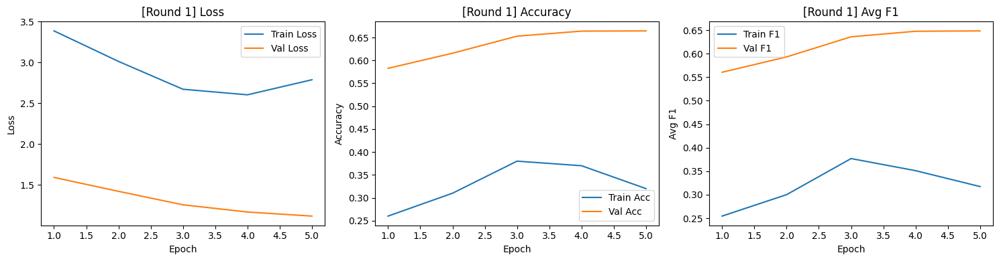


[AL Round 2/20] — Labeled samples: 110



Epoch 5/5
Train — Loss: 2.0752 | Acc: 0.4364 | Avg F1: 0.4340
Val   — Loss: 1.6276 | Acc: 0.6282 | Avg F1: 0.6110


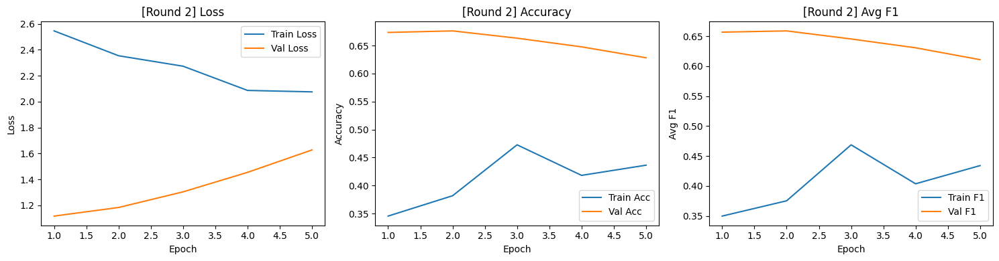


[AL Round 3/20] — Labeled samples: 120



Epoch 5/5
Train — Loss: 1.7559 | Acc: 0.5750 | Avg F1: 0.5595
Val   — Loss: 2.6309 | Acc: 0.5865 | Avg F1: 0.5530


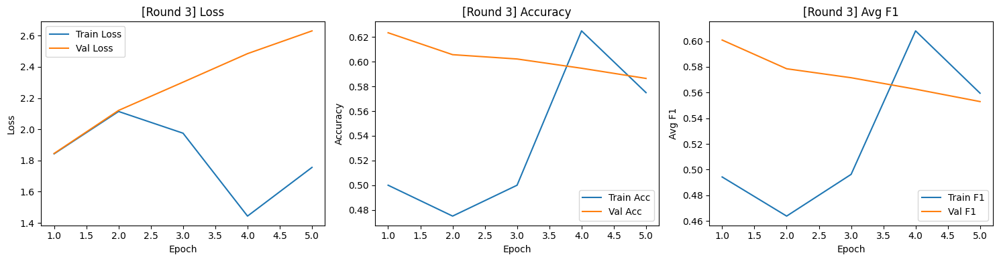


[AL Round 4/20] — Labeled samples: 130



Epoch 5/5
Train — Loss: 1.4063 | Acc: 0.6462 | Avg F1: 0.6111
Val   — Loss: 2.3190 | Acc: 0.6422 | Avg F1: 0.6230


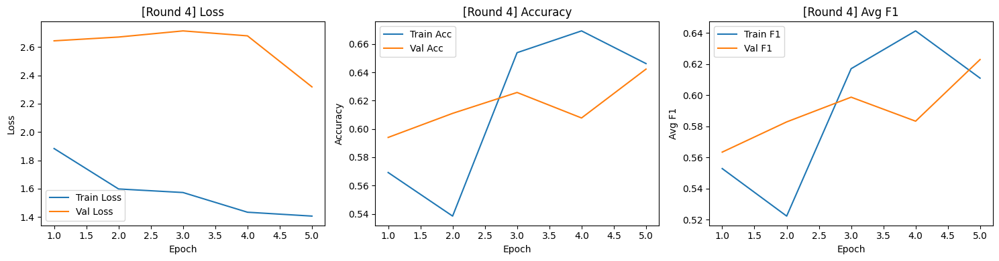


[AL Round 5/20] — Labeled samples: 140



Epoch 10/10
Train — Loss: 1.2148 | Acc: 0.7286 | Avg F1: 0.6998
Val   — Loss: 2.1067 | Acc: 0.6765 | Avg F1: 0.6571


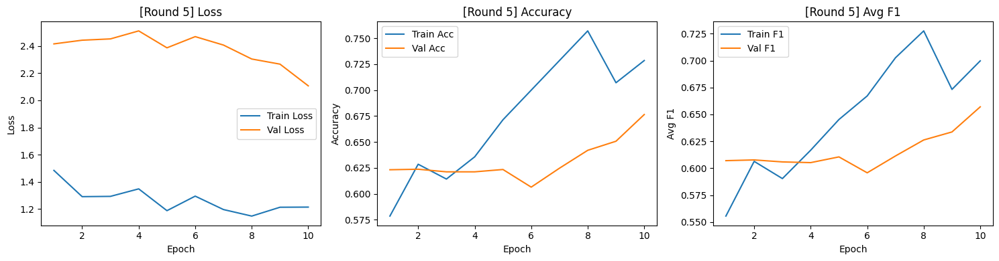


[AL Round 6/20] — Labeled samples: 150



Epoch 10/10
Train — Loss: 1.0343 | Acc: 0.7067 | Avg F1: 0.6894
Val   — Loss: 1.8080 | Acc: 0.7163 | Avg F1: 0.6941


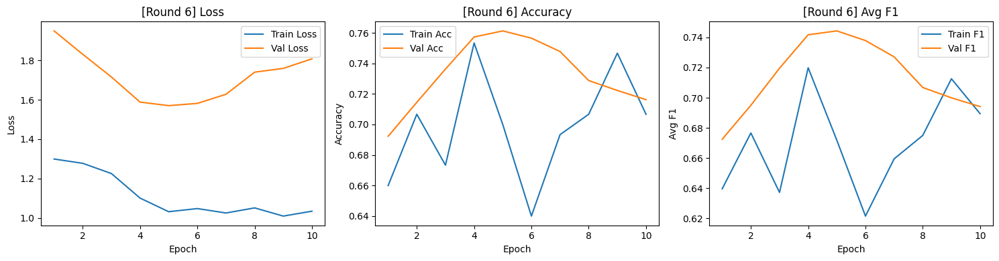


[AL Round 7/20] — Labeled samples: 160



Epoch 10/10
Train — Loss: 0.9332 | Acc: 0.7500 | Avg F1: 0.7166
Val   — Loss: 1.6598 | Acc: 0.7510 | Avg F1: 0.7338


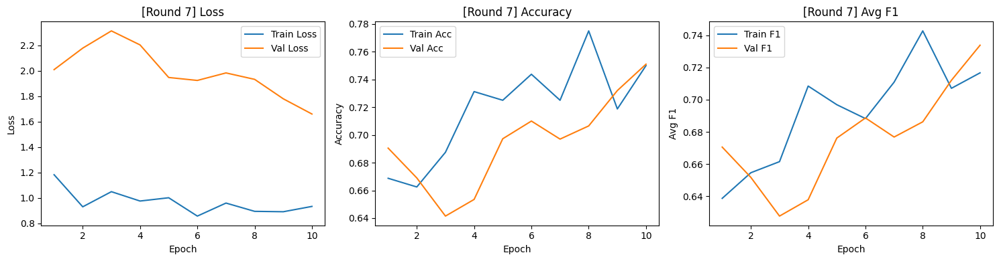


[AL Round 8/20] — Labeled samples: 170



Epoch 10/10
Train — Loss: 0.8469 | Acc: 0.7824 | Avg F1: 0.7733
Val   — Loss: 1.4271 | Acc: 0.7660 | Avg F1: 0.7512


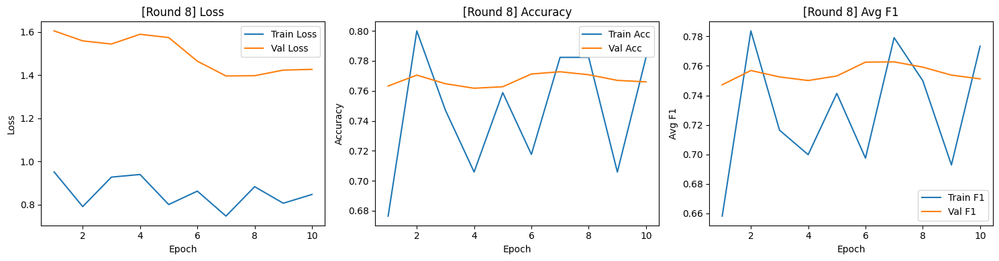


[AL Round 9/20] — Labeled samples: 180



Epoch 10/10
Train — Loss: 0.8241 | Acc: 0.7389 | Avg F1: 0.7128
Val   — Loss: 1.3387 | Acc: 0.7492 | Avg F1: 0.7373


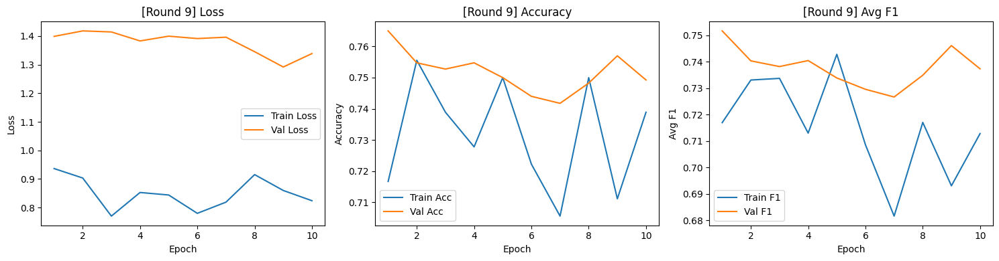


[AL Round 10/20] — Labeled samples: 190



Epoch 10/10
Train — Loss: 0.7211 | Acc: 0.7579 | Avg F1: 0.7421
Val   — Loss: 1.1963 | Acc: 0.7798 | Avg F1: 0.7730


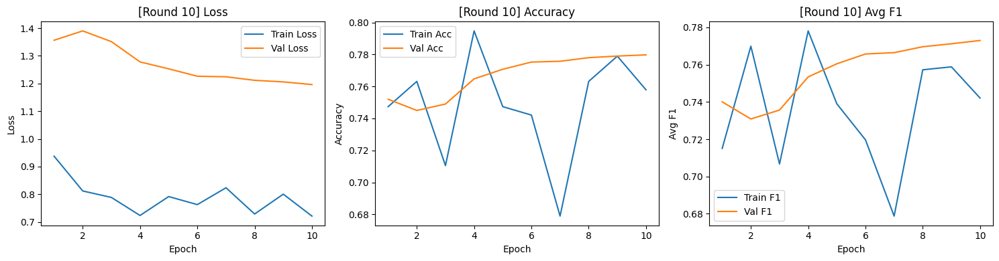


[AL Round 11/20] — Labeled samples: 200



Epoch 10/10
Train — Loss: 0.7384 | Acc: 0.7800 | Avg F1: 0.7660
Val   — Loss: 1.0307 | Acc: 0.7937 | Avg F1: 0.7885


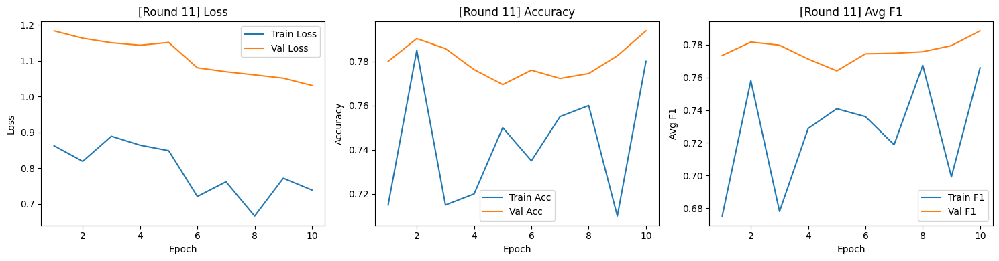


[AL Round 12/20] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.6510 | Acc: 0.7667 | Avg F1: 0.7560
Val   — Loss: 0.9417 | Acc: 0.7830 | Avg F1: 0.7784


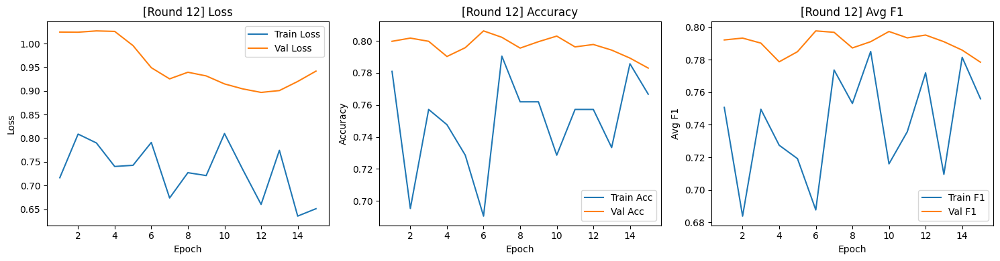


[AL Round 13/20] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.6499 | Acc: 0.7773 | Avg F1: 0.7721
Val   — Loss: 0.9224 | Acc: 0.7843 | Avg F1: 0.7891


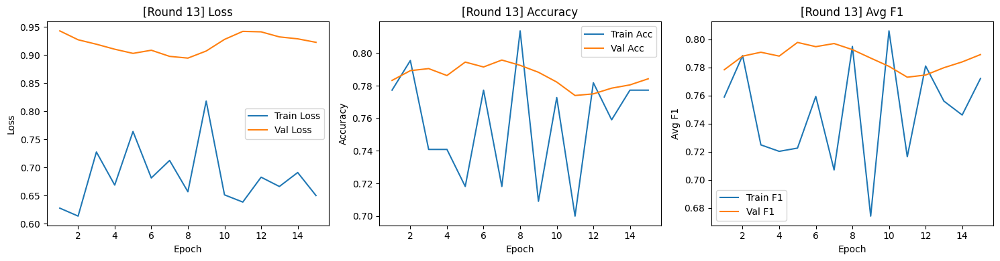


[AL Round 14/20] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.6230 | Acc: 0.8000 | Avg F1: 0.7953
Val   — Loss: 0.9358 | Acc: 0.7622 | Avg F1: 0.7682


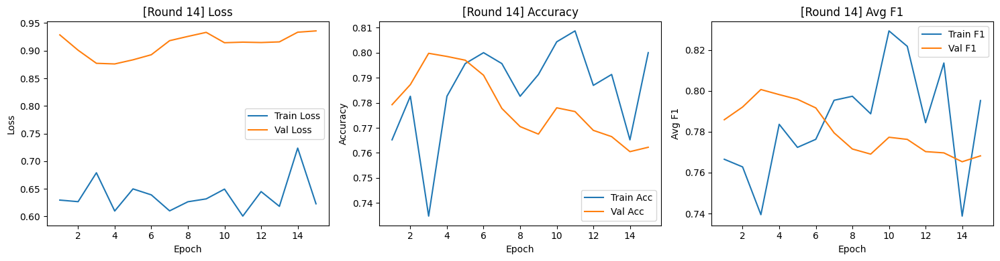


[AL Round 15/20] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.6523 | Acc: 0.7375 | Avg F1: 0.7305
Val   — Loss: 0.8642 | Acc: 0.7870 | Avg F1: 0.7937


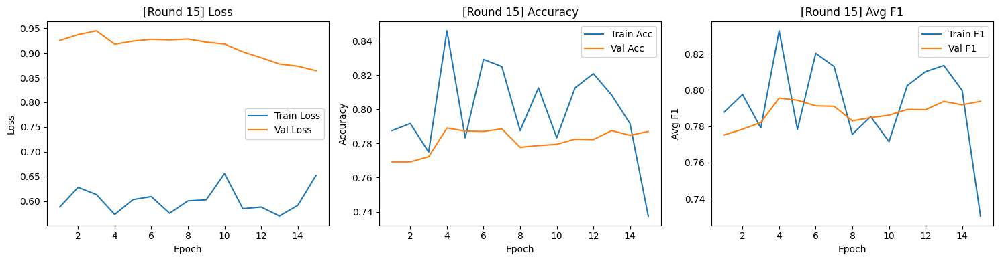


[AL Round 16/20] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.5589 | Acc: 0.8160 | Avg F1: 0.7960
Val   — Loss: 0.8765 | Acc: 0.7867 | Avg F1: 0.7931


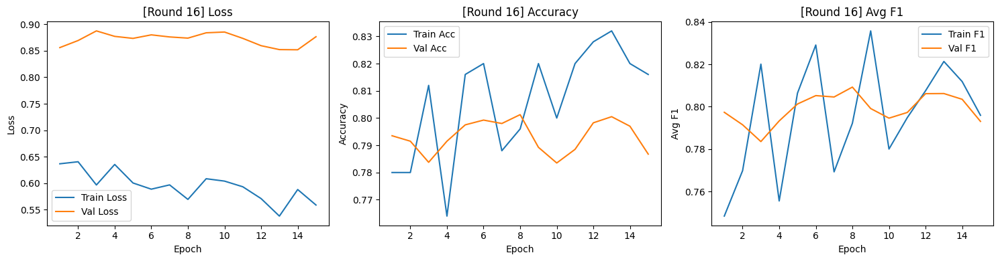


[AL Round 17/20] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.5861 | Acc: 0.7885 | Avg F1: 0.7834
Val   — Loss: 0.9920 | Acc: 0.7478 | Avg F1: 0.7601


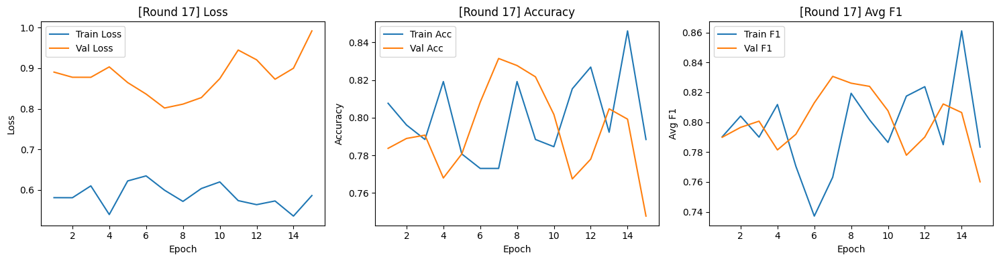


[AL Round 18/20] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.5941 | Acc: 0.8000 | Avg F1: 0.7954
Val   — Loss: 0.9312 | Acc: 0.7692 | Avg F1: 0.7801


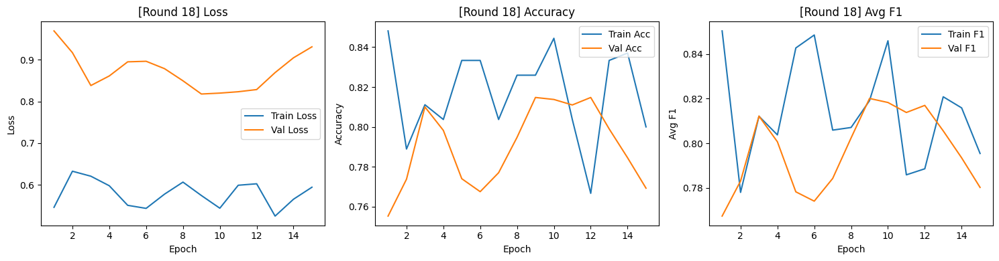


[AL Round 19/20] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.6274 | Acc: 0.7893 | Avg F1: 0.7766
Val   — Loss: 0.8465 | Acc: 0.8095 | Avg F1: 0.8138


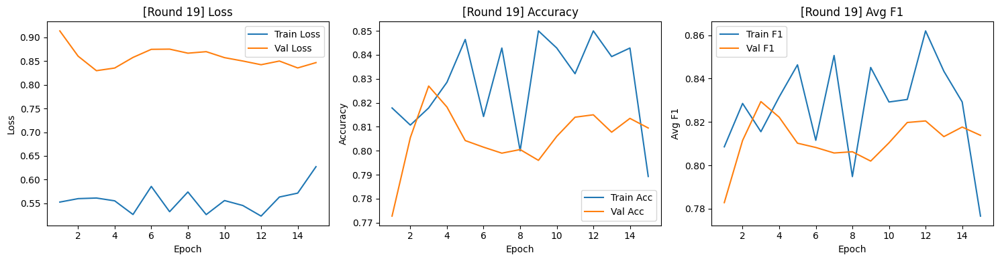


[AL Round 20/20] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.5418 | Acc: 0.8517 | Avg F1: 0.8483
Val   — Loss: 0.8362 | Acc: 0.8027 | Avg F1: 0.8043


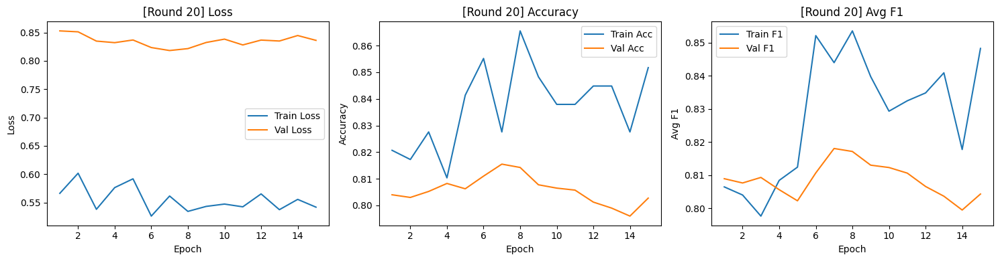

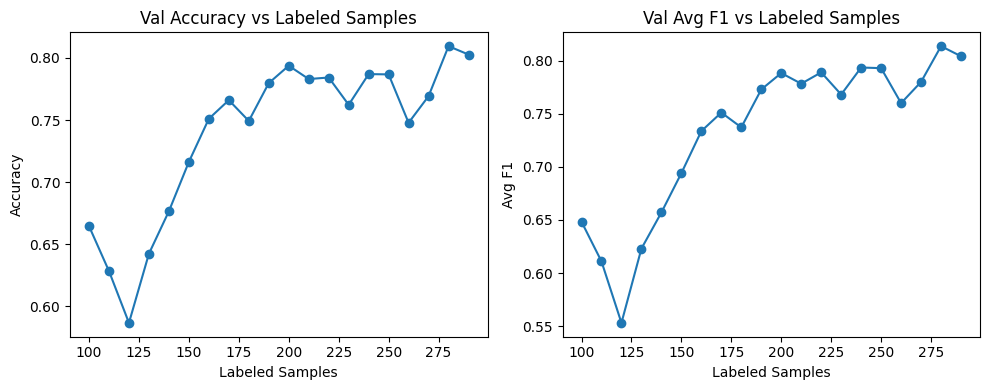


=== Running strategy: LEAST_CONFIDENT ===

[AL Round 1/20] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.5768 | Acc: 0.3500 | Avg F1: 0.3420
Val   — Loss: 1.1399 | Acc: 0.6875 | Avg F1: 0.6721


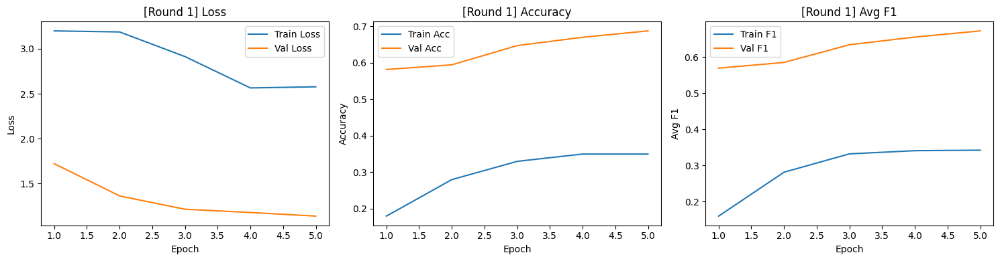


[AL Round 2/20] — Labeled samples: 110



Epoch 5/5
Train — Loss: 2.1736 | Acc: 0.4455 | Avg F1: 0.4447
Val   — Loss: 1.6799 | Acc: 0.6170 | Avg F1: 0.5929


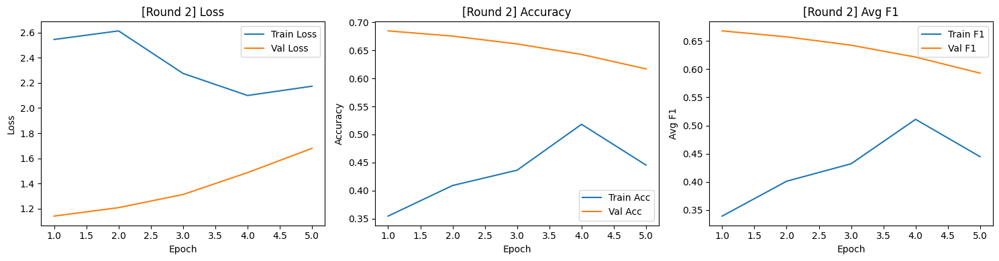


[AL Round 3/20] — Labeled samples: 120



Epoch 5/5
Train — Loss: 1.8684 | Acc: 0.5000 | Avg F1: 0.4834
Val   — Loss: 2.4884 | Acc: 0.5913 | Avg F1: 0.5545


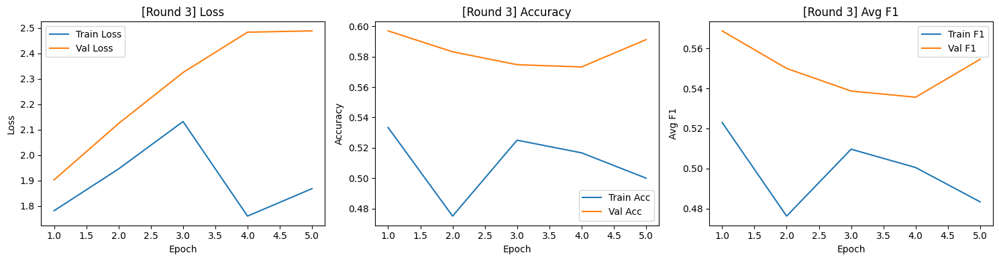


[AL Round 4/20] — Labeled samples: 130



Epoch 5/5
Train — Loss: 1.6292 | Acc: 0.5769 | Avg F1: 0.5603
Val   — Loss: 2.4546 | Acc: 0.6225 | Avg F1: 0.6022


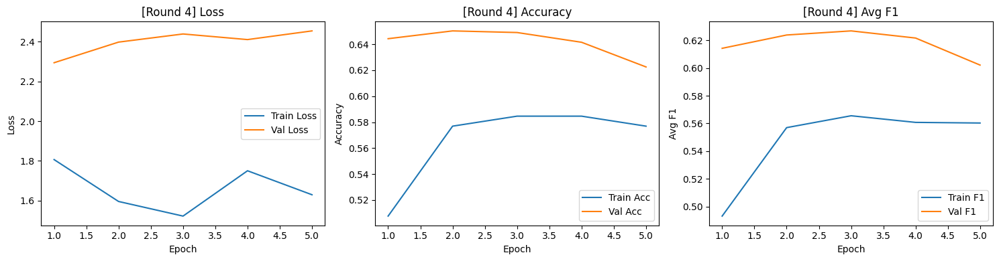


[AL Round 5/20] — Labeled samples: 140



Epoch 10/10
Train — Loss: 1.0922 | Acc: 0.6857 | Avg F1: 0.6614
Val   — Loss: 1.7290 | Acc: 0.7620 | Avg F1: 0.7404


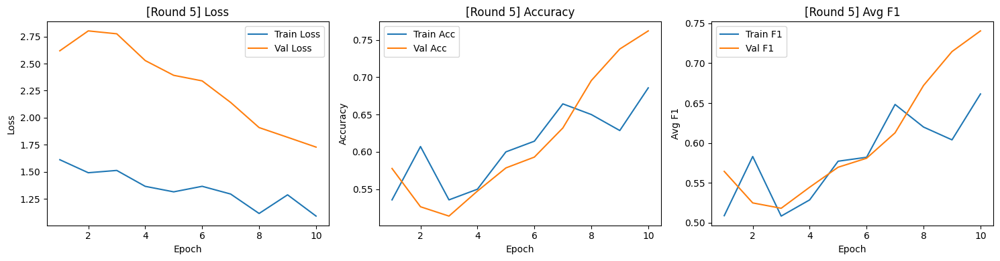


[AL Round 6/20] — Labeled samples: 150



Epoch 10/10
Train — Loss: 1.0732 | Acc: 0.7267 | Avg F1: 0.7050
Val   — Loss: 1.6349 | Acc: 0.7817 | Avg F1: 0.7626


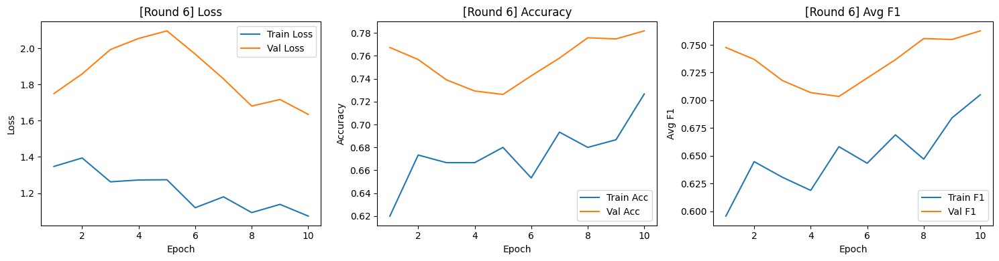


[AL Round 7/20] — Labeled samples: 160



Epoch 10/10
Train — Loss: 0.9772 | Acc: 0.7188 | Avg F1: 0.6963
Val   — Loss: 1.5089 | Acc: 0.7955 | Avg F1: 0.7774


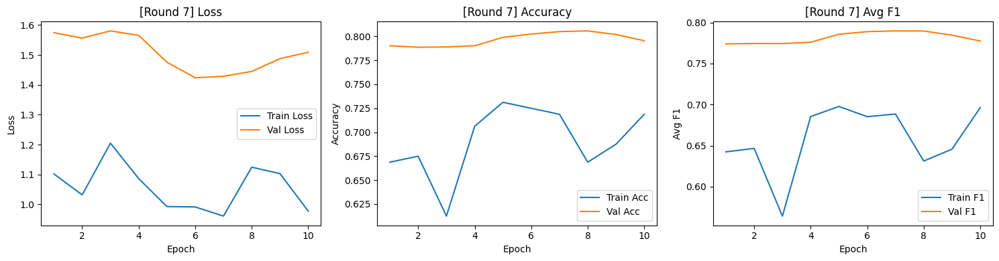


[AL Round 8/20] — Labeled samples: 170



Epoch 10/10
Train — Loss: 1.0492 | Acc: 0.6882 | Avg F1: 0.6822
Val   — Loss: 1.4058 | Acc: 0.7845 | Avg F1: 0.7675


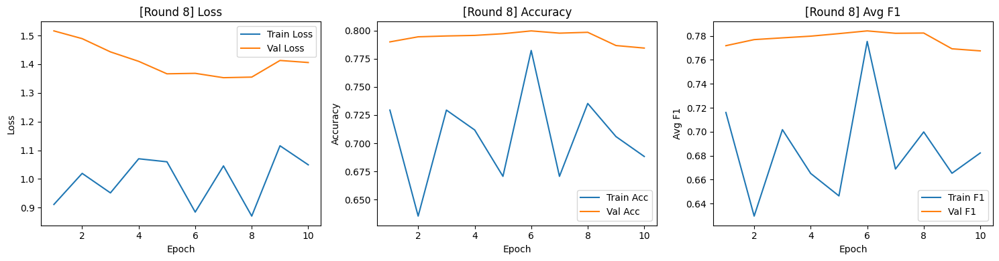


[AL Round 9/20] — Labeled samples: 180



Epoch 10/10
Train — Loss: 0.7385 | Acc: 0.7333 | Avg F1: 0.7366
Val   — Loss: 1.2162 | Acc: 0.8035 | Avg F1: 0.7902


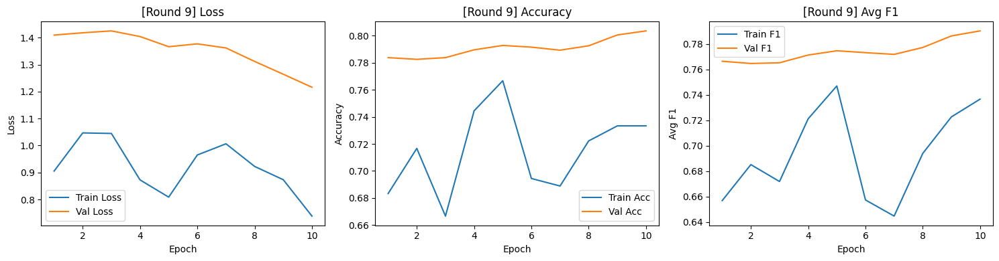


[AL Round 10/20] — Labeled samples: 190



Epoch 10/10
Train — Loss: 1.0097 | Acc: 0.6895 | Avg F1: 0.6356
Val   — Loss: 1.3090 | Acc: 0.7760 | Avg F1: 0.7574


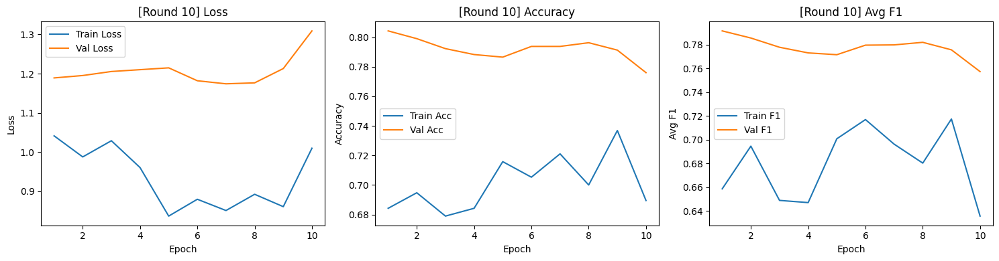


[AL Round 11/20] — Labeled samples: 200



Epoch 10/10
Train — Loss: 0.8560 | Acc: 0.7000 | Avg F1: 0.6804
Val   — Loss: 1.1546 | Acc: 0.8040 | Avg F1: 0.7984


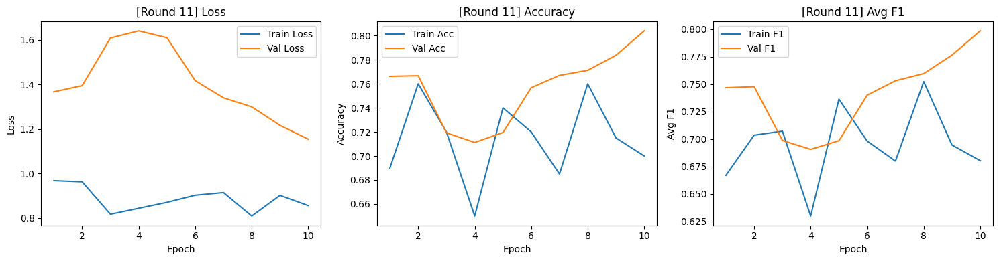


[AL Round 12/20] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.8007 | Acc: 0.7190 | Avg F1: 0.6912
Val   — Loss: 1.1301 | Acc: 0.7895 | Avg F1: 0.7833


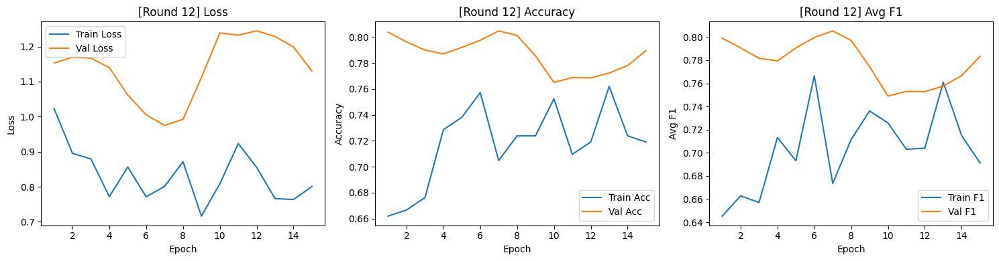


[AL Round 13/20] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.8169 | Acc: 0.7500 | Avg F1: 0.7262
Val   — Loss: 0.9563 | Acc: 0.8127 | Avg F1: 0.8108


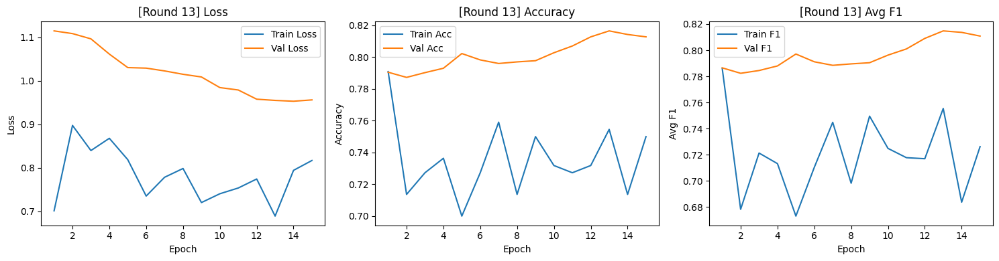


[AL Round 14/20] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.7472 | Acc: 0.7391 | Avg F1: 0.7246
Val   — Loss: 0.9264 | Acc: 0.8083 | Avg F1: 0.8074


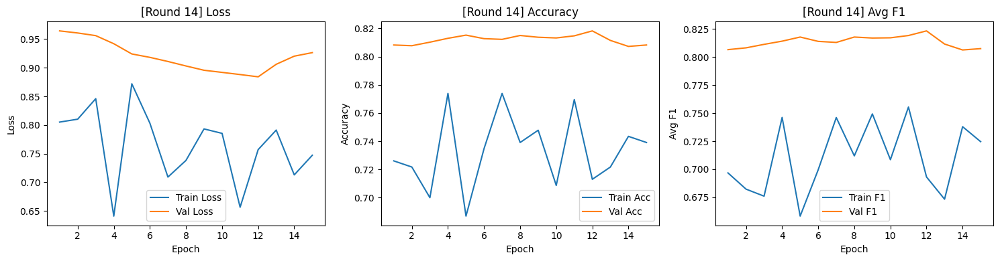


[AL Round 15/20] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.6884 | Acc: 0.7375 | Avg F1: 0.7205
Val   — Loss: 0.8876 | Acc: 0.8157 | Avg F1: 0.8185


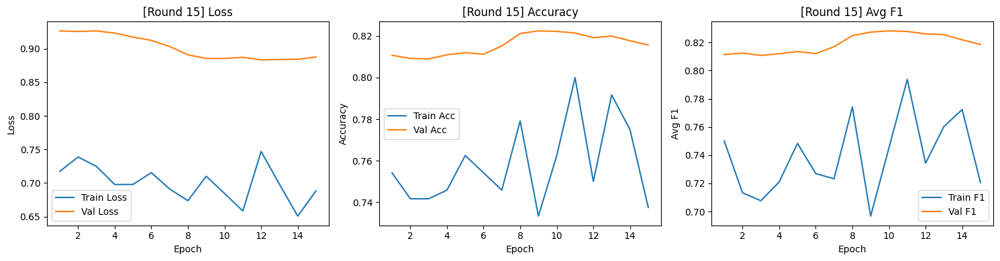


[AL Round 16/20] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.7180 | Acc: 0.7480 | Avg F1: 0.7273
Val   — Loss: 0.8798 | Acc: 0.8320 | Avg F1: 0.8340


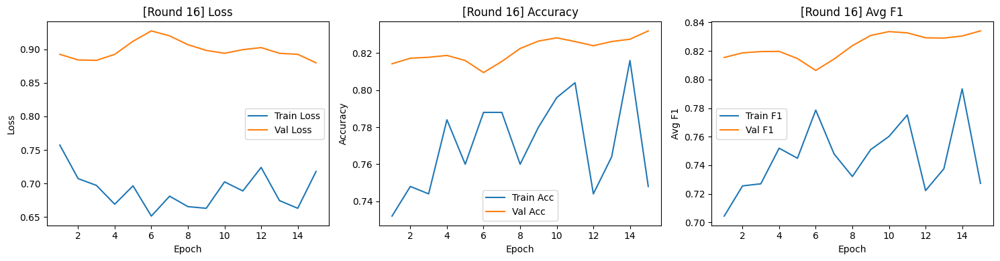


[AL Round 17/20] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.7028 | Acc: 0.7692 | Avg F1: 0.7485
Val   — Loss: 0.8540 | Acc: 0.8235 | Avg F1: 0.8251


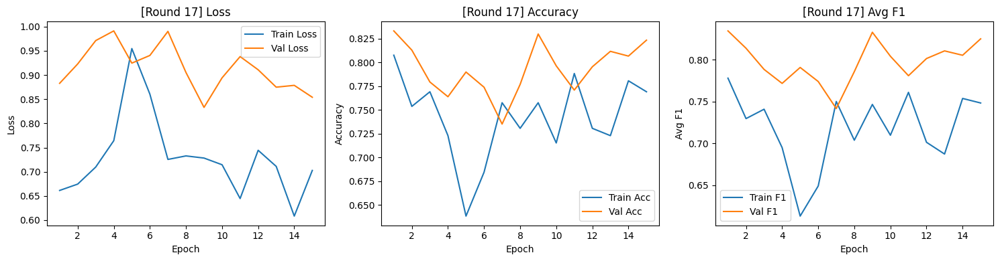


[AL Round 18/20] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.6907 | Acc: 0.7741 | Avg F1: 0.7589
Val   — Loss: 0.8523 | Acc: 0.7990 | Avg F1: 0.8067


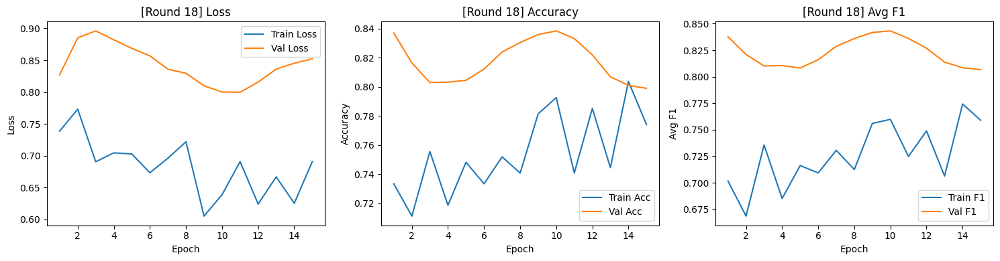


[AL Round 19/20] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.7007 | Acc: 0.7464 | Avg F1: 0.7258
Val   — Loss: 0.7930 | Acc: 0.8267 | Avg F1: 0.8321


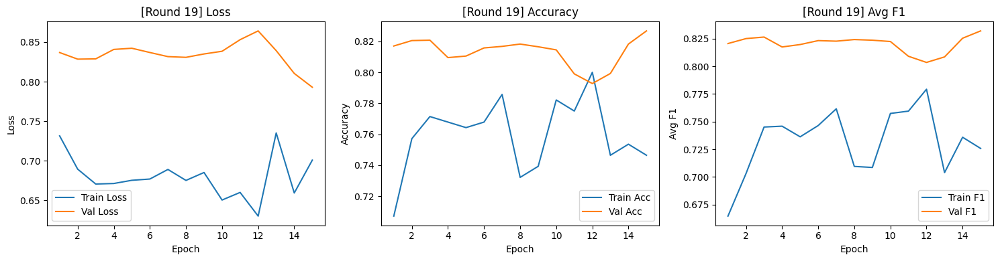


[AL Round 20/20] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.6223 | Acc: 0.8034 | Avg F1: 0.7853
Val   — Loss: 0.8113 | Acc: 0.8115 | Avg F1: 0.8158


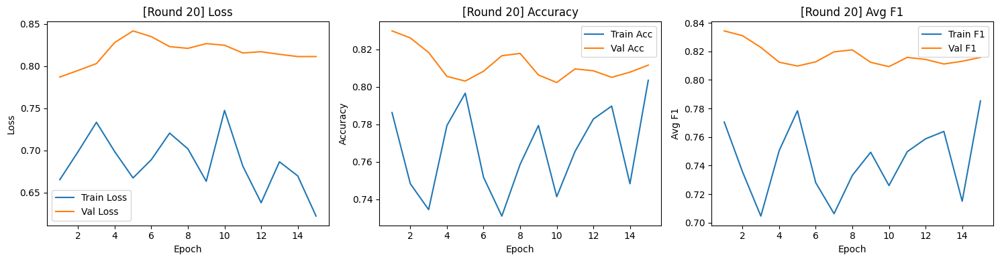

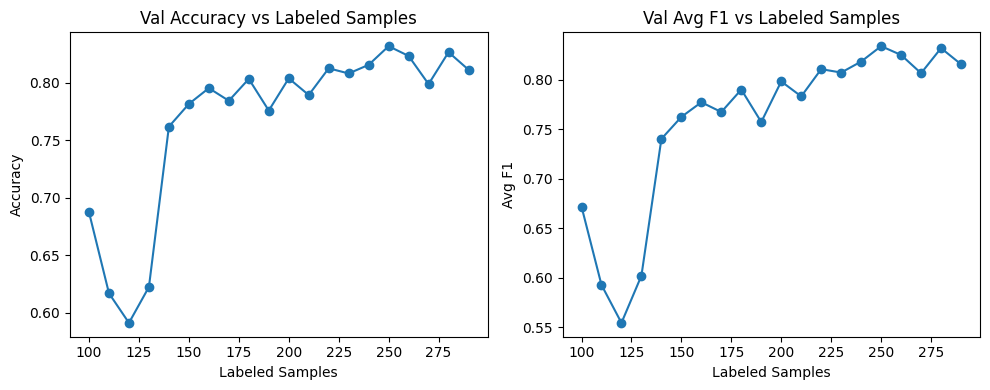


=== Running strategy: DENSITY ===

[AL Round 1/20] — Labeled samples: 100



Epoch 5/5
Train — Loss: 2.5290 | Acc: 0.3700 | Avg F1: 0.3768
Val   — Loss: 1.1449 | Acc: 0.6505 | Avg F1: 0.6316


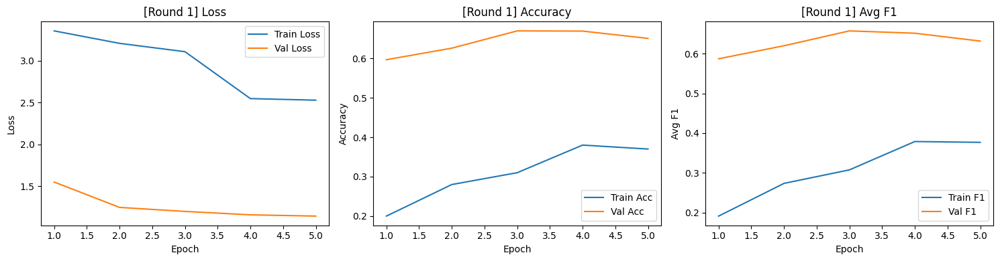


[AL Round 2/20] — Labeled samples: 110



Epoch 5/5
Train — Loss: 2.0448 | Acc: 0.5000 | Avg F1: 0.4887
Val   — Loss: 1.7959 | Acc: 0.5310 | Avg F1: 0.5245


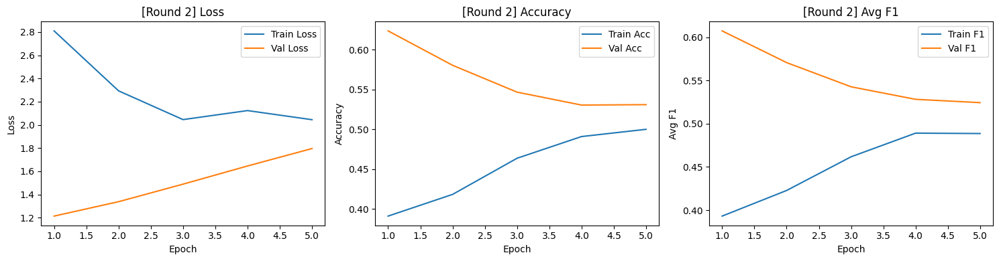


[AL Round 3/20] — Labeled samples: 120



Epoch 5/5
Train — Loss: 1.6786 | Acc: 0.6417 | Avg F1: 0.6197
Val   — Loss: 3.1495 | Acc: 0.5245 | Avg F1: 0.4854


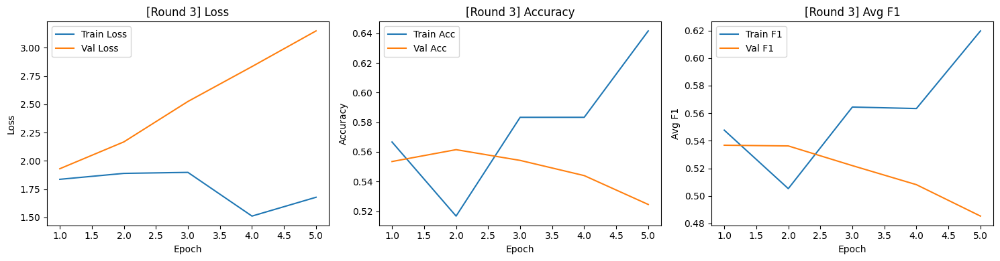


[AL Round 4/20] — Labeled samples: 130



Epoch 5/5
Train — Loss: 1.4629 | Acc: 0.6077 | Avg F1: 0.5830
Val   — Loss: 5.1549 | Acc: 0.5238 | Avg F1: 0.4512


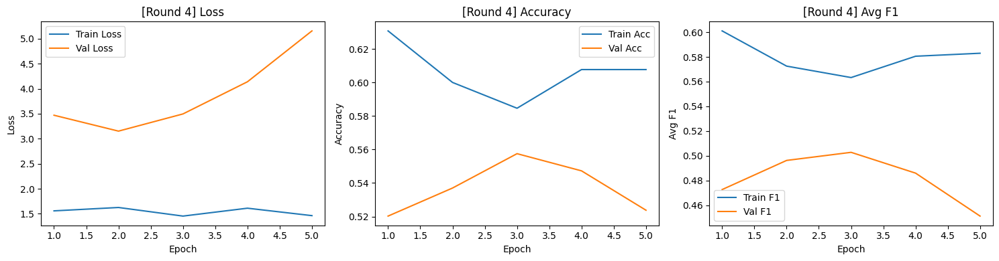


[AL Round 5/20] — Labeled samples: 140



Epoch 10/10
Train — Loss: 1.1626 | Acc: 0.7143 | Avg F1: 0.6604
Val   — Loss: 2.4374 | Acc: 0.6763 | Avg F1: 0.6584


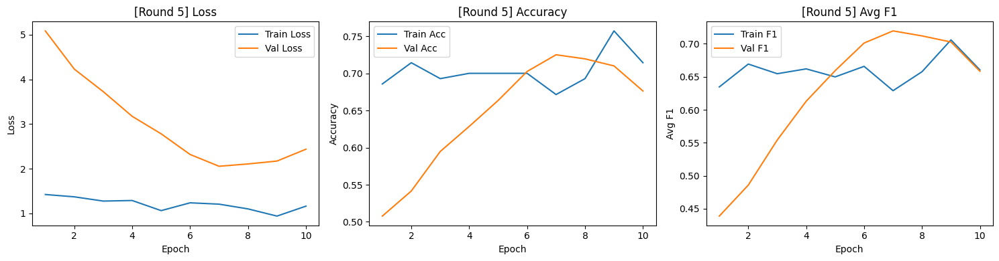


[AL Round 6/20] — Labeled samples: 150



Epoch 10/10
Train — Loss: 1.0114 | Acc: 0.7733 | Avg F1: 0.7246
Val   — Loss: 2.4347 | Acc: 0.6897 | Avg F1: 0.6914


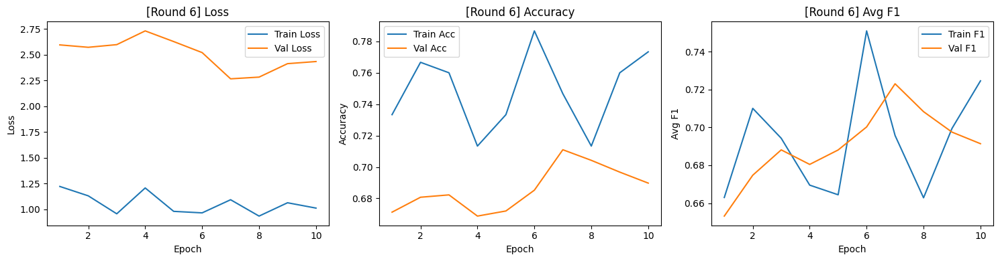


[AL Round 7/20] — Labeled samples: 160



Epoch 10/10
Train — Loss: 0.7655 | Acc: 0.8125 | Avg F1: 0.7566
Val   — Loss: 1.4564 | Acc: 0.7620 | Avg F1: 0.7658


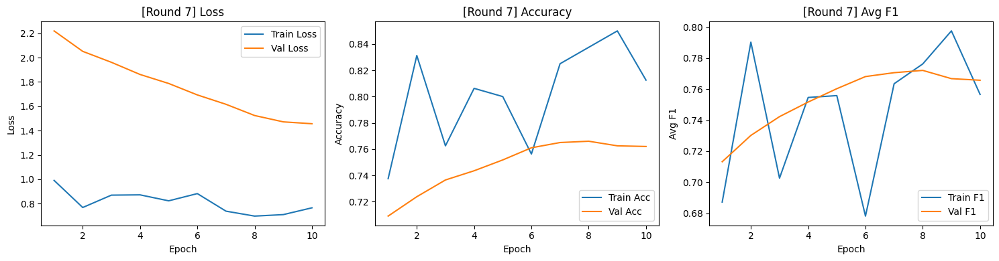


[AL Round 8/20] — Labeled samples: 170



Epoch 10/10
Train — Loss: 0.6817 | Acc: 0.8059 | Avg F1: 0.7594
Val   — Loss: 1.3577 | Acc: 0.7588 | Avg F1: 0.7618


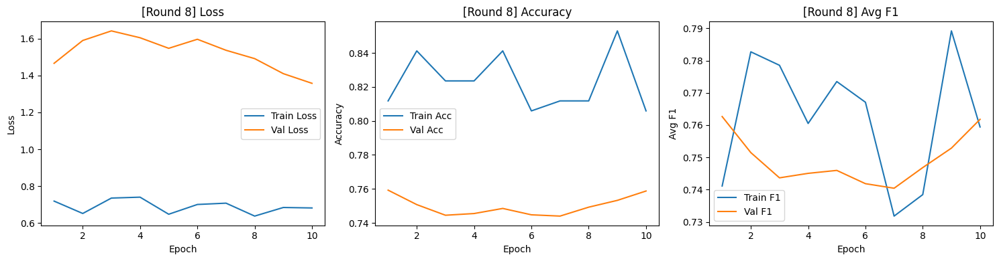


[AL Round 9/20] — Labeled samples: 180



Epoch 10/10
Train — Loss: 0.6346 | Acc: 0.8278 | Avg F1: 0.7623
Val   — Loss: 1.1789 | Acc: 0.7350 | Avg F1: 0.7454


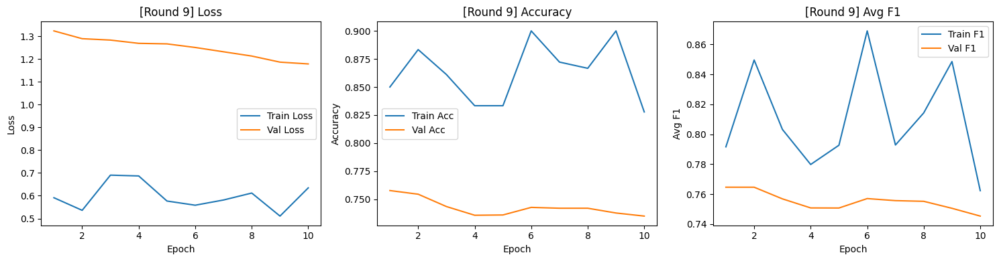


[AL Round 10/20] — Labeled samples: 190



Epoch 10/10
Train — Loss: 0.5778 | Acc: 0.8263 | Avg F1: 0.7736
Val   — Loss: 1.1131 | Acc: 0.7360 | Avg F1: 0.7475


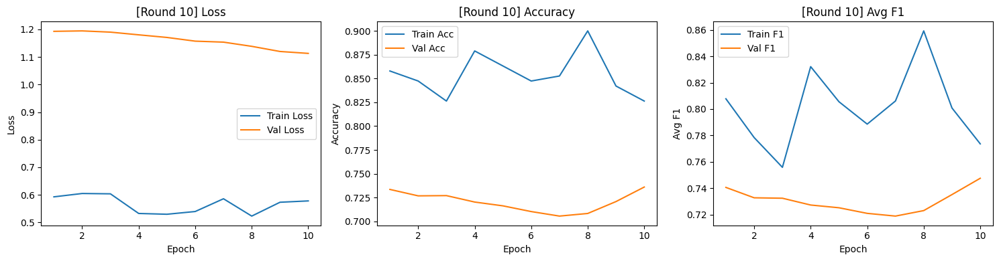


[AL Round 11/20] — Labeled samples: 200



Epoch 10/10
Train — Loss: 0.4752 | Acc: 0.8800 | Avg F1: 0.8416
Val   — Loss: 1.1256 | Acc: 0.7240 | Avg F1: 0.7356


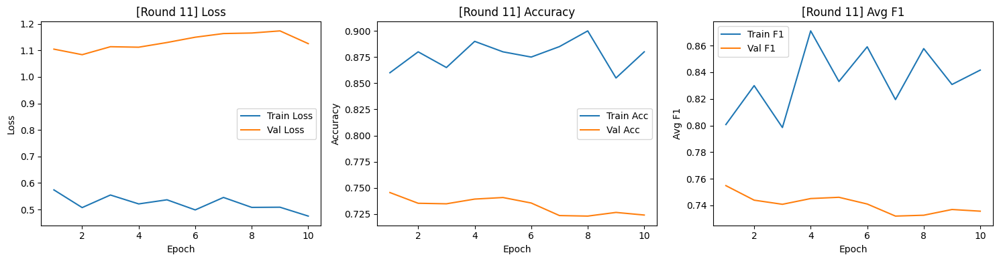


[AL Round 12/20] — Labeled samples: 210



Epoch 15/15
Train — Loss: 0.4306 | Acc: 0.9524 | Avg F1: 0.9339
Val   — Loss: 0.9694 | Acc: 0.7642 | Avg F1: 0.7698


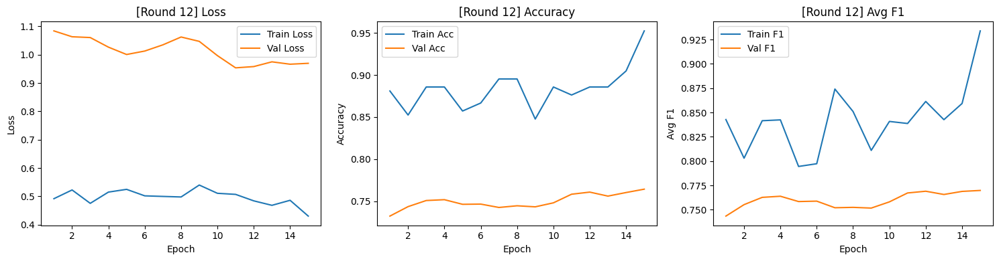


[AL Round 13/20] — Labeled samples: 220



Epoch 15/15
Train — Loss: 0.4686 | Acc: 0.9045 | Avg F1: 0.8776
Val   — Loss: 0.9256 | Acc: 0.7538 | Avg F1: 0.7548


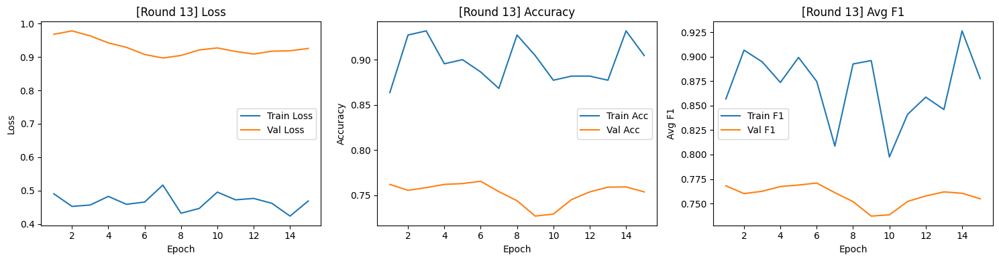


[AL Round 14/20] — Labeled samples: 230



Epoch 15/15
Train — Loss: 0.4592 | Acc: 0.8957 | Avg F1: 0.8658
Val   — Loss: 0.9202 | Acc: 0.7380 | Avg F1: 0.7460


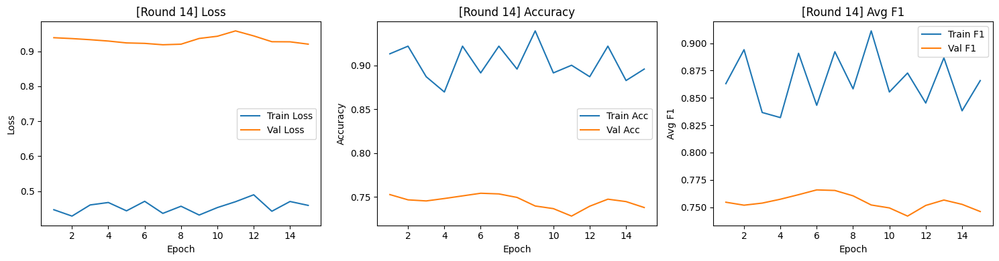


[AL Round 15/20] — Labeled samples: 240



Epoch 15/15
Train — Loss: 0.3948 | Acc: 0.9292 | Avg F1: 0.8926
Val   — Loss: 0.9119 | Acc: 0.7382 | Avg F1: 0.7470


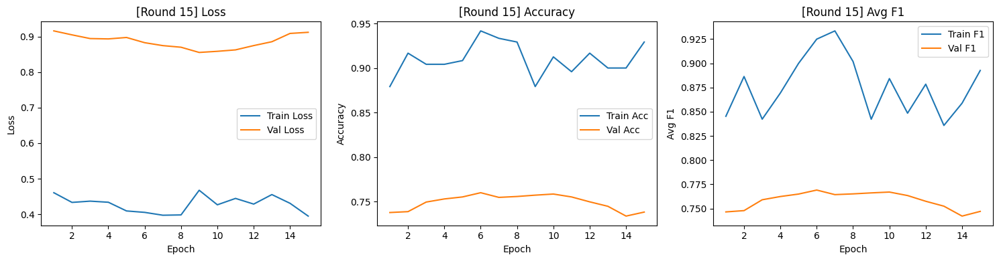


[AL Round 16/20] — Labeled samples: 250



Epoch 15/15
Train — Loss: 0.4152 | Acc: 0.9320 | Avg F1: 0.9120
Val   — Loss: 0.8796 | Acc: 0.7452 | Avg F1: 0.7528


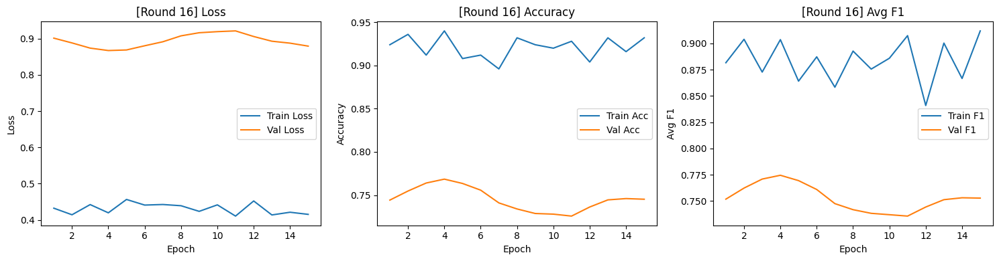


[AL Round 17/20] — Labeled samples: 260



Epoch 15/15
Train — Loss: 0.4163 | Acc: 0.9423 | Avg F1: 0.9248
Val   — Loss: 0.9080 | Acc: 0.7645 | Avg F1: 0.7617


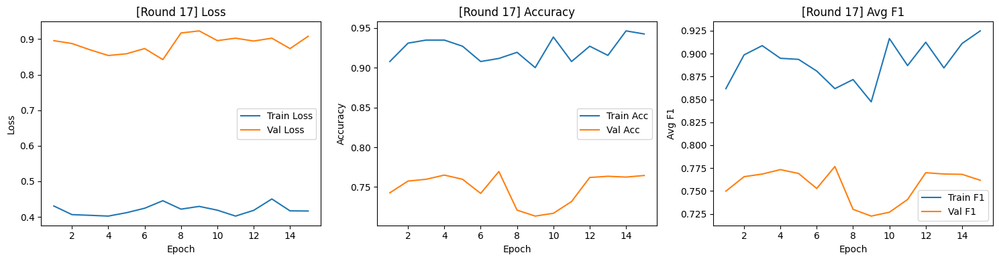


[AL Round 18/20] — Labeled samples: 270



Epoch 15/15
Train — Loss: 0.4196 | Acc: 0.9407 | Avg F1: 0.9031
Val   — Loss: 0.8605 | Acc: 0.7495 | Avg F1: 0.7633


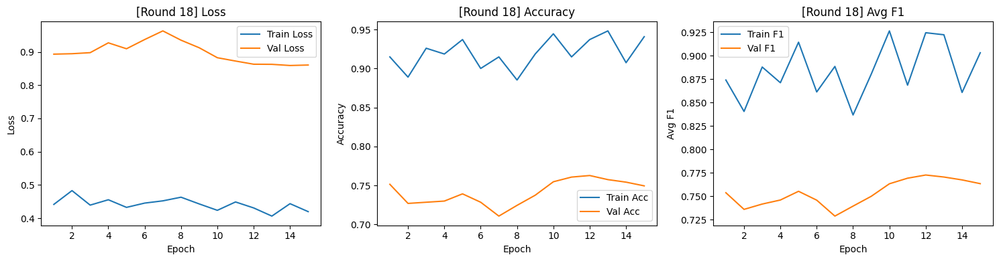


[AL Round 19/20] — Labeled samples: 280



Epoch 15/15
Train — Loss: 0.3883 | Acc: 0.9429 | Avg F1: 0.9202
Val   — Loss: 0.8349 | Acc: 0.7438 | Avg F1: 0.7558


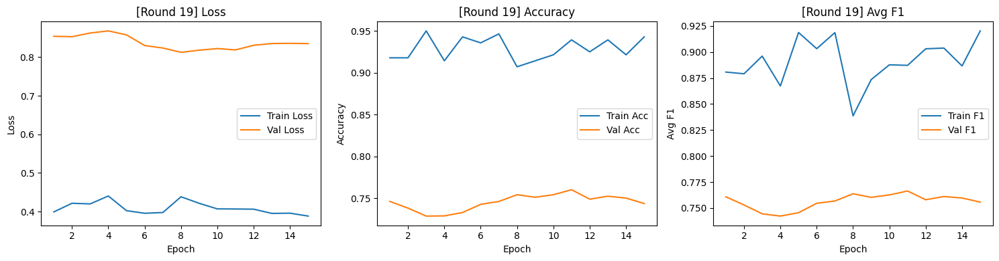


[AL Round 20/20] — Labeled samples: 290



Epoch 15/15
Train — Loss: 0.4109 | Acc: 0.9276 | Avg F1: 0.8940
Val   — Loss: 0.8062 | Acc: 0.7660 | Avg F1: 0.7727


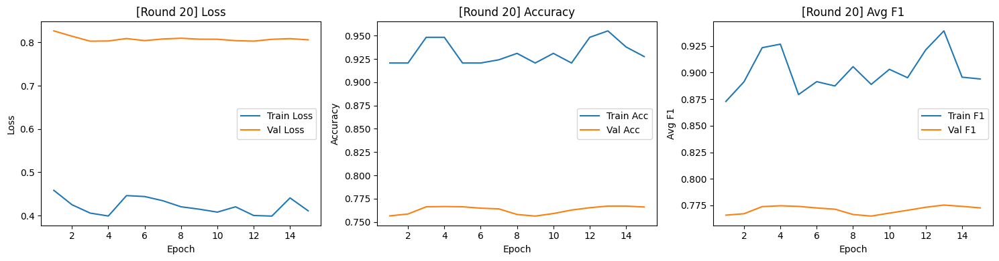

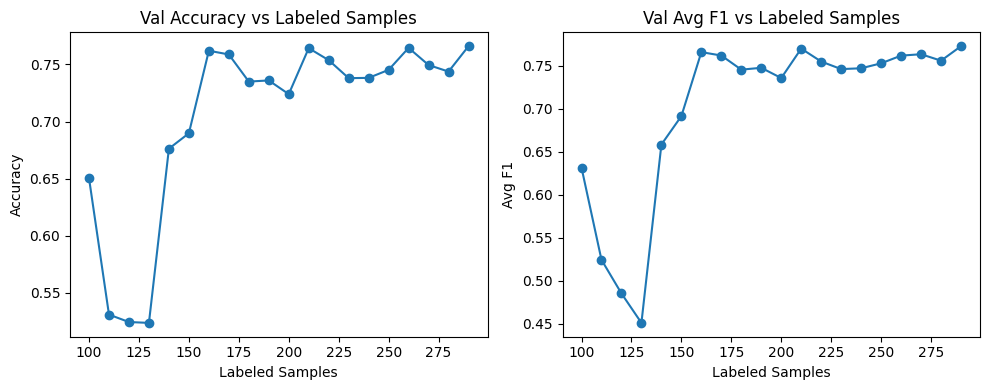

X_labeled shape: (300, 6, 28)
y_labeled shape: (300,)
X_unlabeled shape: (15700, 6, 28)
y_unlabeled shape: (15700,)

=== Running strategy: RANDOM ===

[AL Round 1/20] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.8761 | Acc: 0.5367 | Avg F1: 0.5255
Val   — Loss: 1.9985 | Acc: 0.6035 | Avg F1: 0.5862


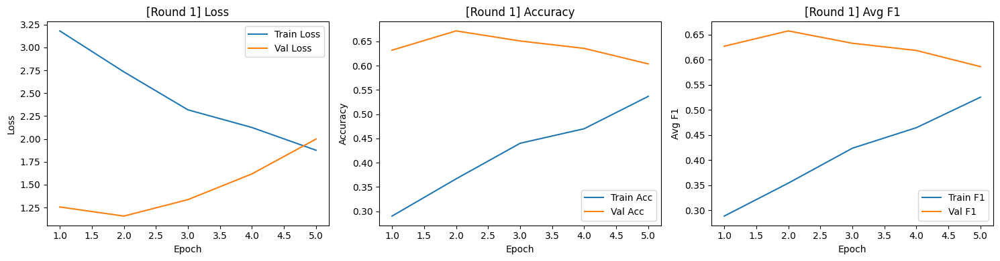


[AL Round 2/20] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.3741 | Acc: 0.6839 | Avg F1: 0.6699
Val   — Loss: 1.4697 | Acc: 0.7730 | Avg F1: 0.7545


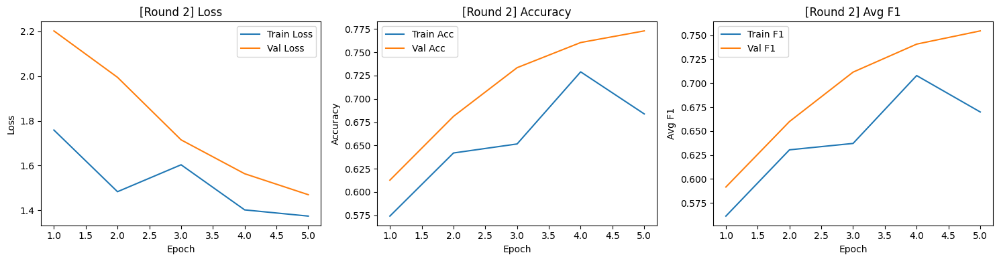


[AL Round 3/20] — Labeled samples: 320



Epoch 5/5
Train — Loss: 1.1129 | Acc: 0.7562 | Avg F1: 0.7344
Val   — Loss: 1.3795 | Acc: 0.7552 | Avg F1: 0.7388


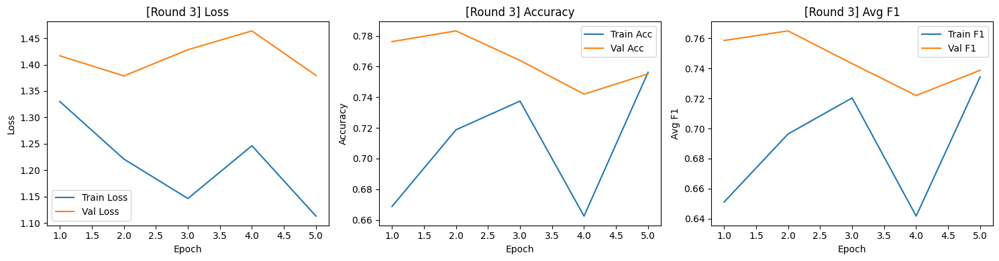


[AL Round 4/20] — Labeled samples: 330



Epoch 5/5
Train — Loss: 0.9663 | Acc: 0.7758 | Avg F1: 0.7708
Val   — Loss: 1.1669 | Acc: 0.7953 | Avg F1: 0.7799


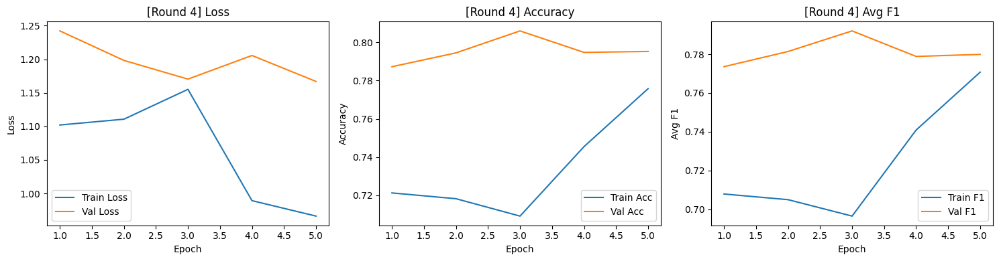


[AL Round 5/20] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.8409 | Acc: 0.7412 | Avg F1: 0.7280
Val   — Loss: 0.9759 | Acc: 0.8003 | Avg F1: 0.7955


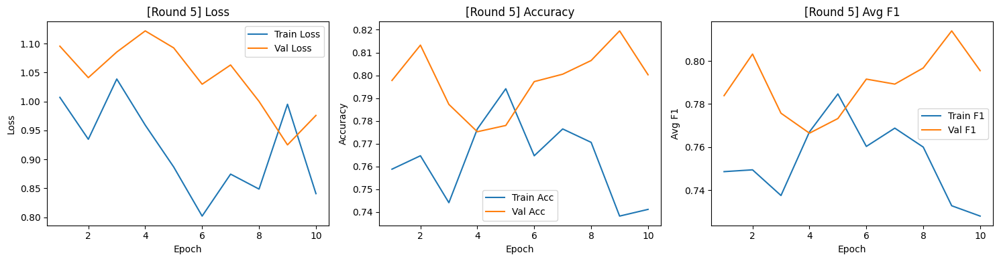


[AL Round 6/20] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.7029 | Acc: 0.8114 | Avg F1: 0.8035
Val   — Loss: 0.8679 | Acc: 0.8173 | Avg F1: 0.8189


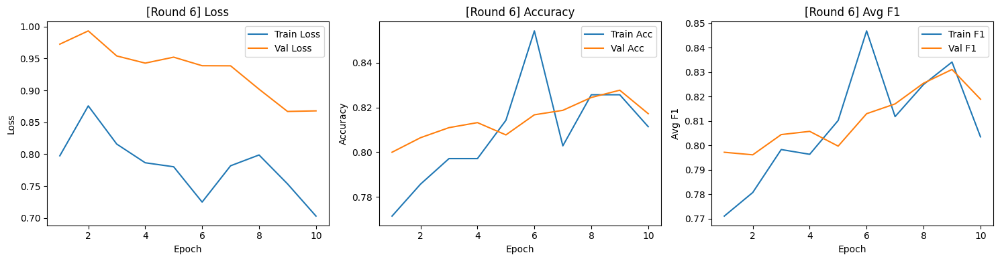


[AL Round 7/20] — Labeled samples: 360



Epoch 10/10
Train — Loss: 0.6618 | Acc: 0.8389 | Avg F1: 0.8376
Val   — Loss: 0.8261 | Acc: 0.8147 | Avg F1: 0.8142


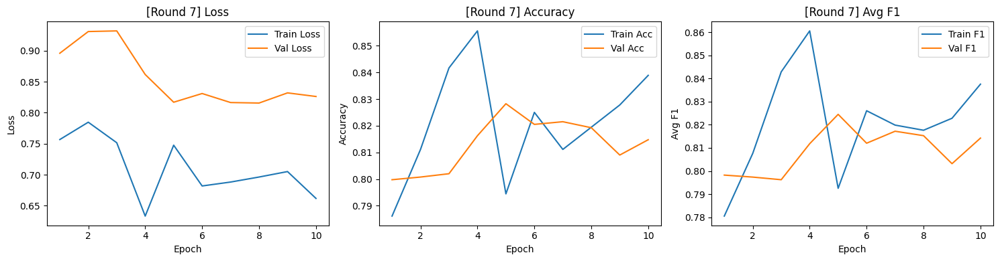


[AL Round 8/20] — Labeled samples: 370



Epoch 10/10
Train — Loss: 0.6661 | Acc: 0.8432 | Avg F1: 0.8562
Val   — Loss: 0.8258 | Acc: 0.8140 | Avg F1: 0.8179


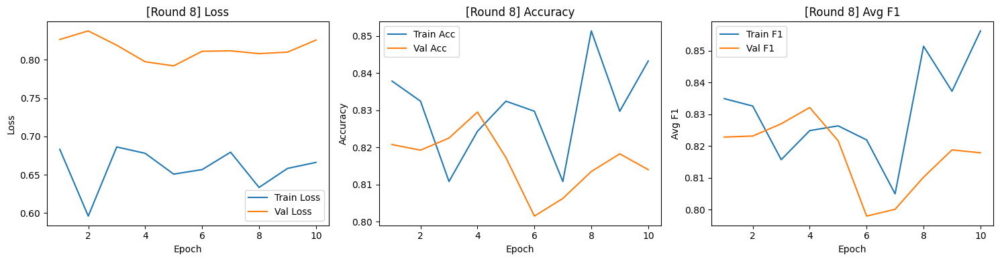


[AL Round 9/20] — Labeled samples: 380



Epoch 10/10
Train — Loss: 0.6207 | Acc: 0.8500 | Avg F1: 0.8376
Val   — Loss: 0.8356 | Acc: 0.8065 | Avg F1: 0.8156


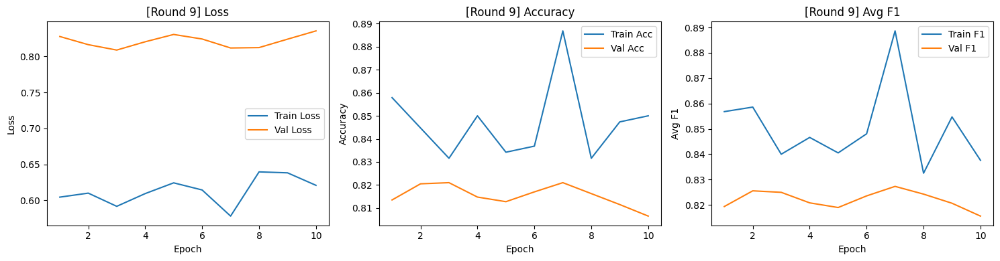


[AL Round 10/20] — Labeled samples: 390



Epoch 10/10
Train — Loss: 0.5836 | Acc: 0.8487 | Avg F1: 0.8550
Val   — Loss: 0.7830 | Acc: 0.8165 | Avg F1: 0.8243


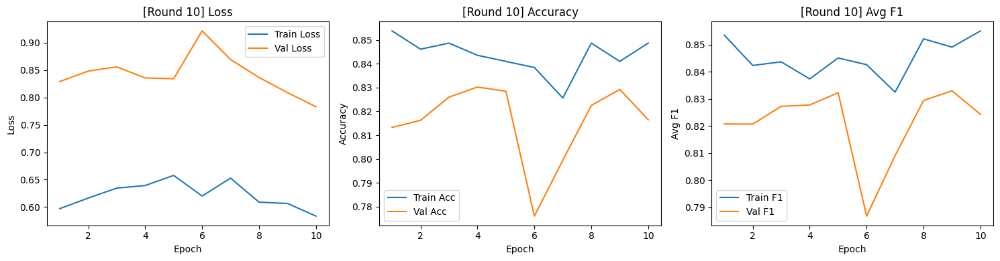


[AL Round 11/20] — Labeled samples: 400



Epoch 10/10
Train — Loss: 0.6080 | Acc: 0.8475 | Avg F1: 0.8589
Val   — Loss: 0.7967 | Acc: 0.8275 | Avg F1: 0.8312


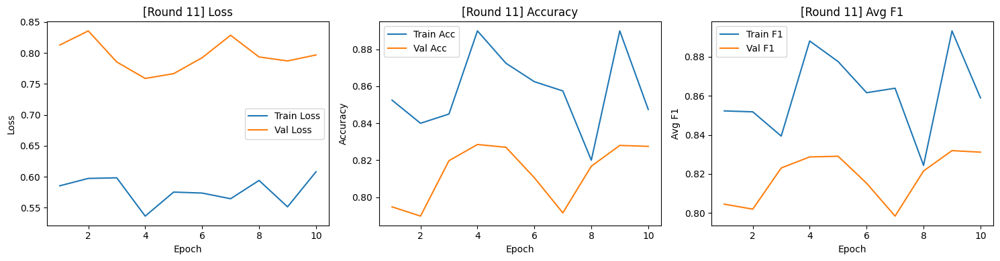


[AL Round 12/20] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.5397 | Acc: 0.8902 | Avg F1: 0.8877
Val   — Loss: 0.7477 | Acc: 0.8303 | Avg F1: 0.8358


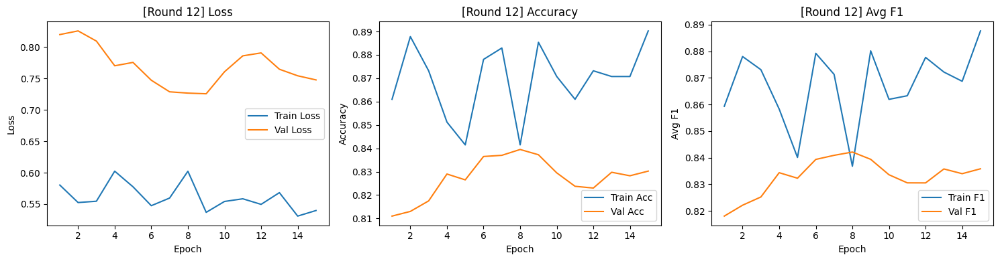


[AL Round 13/20] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.5556 | Acc: 0.8690 | Avg F1: 0.8828
Val   — Loss: 0.7327 | Acc: 0.8420 | Avg F1: 0.8439


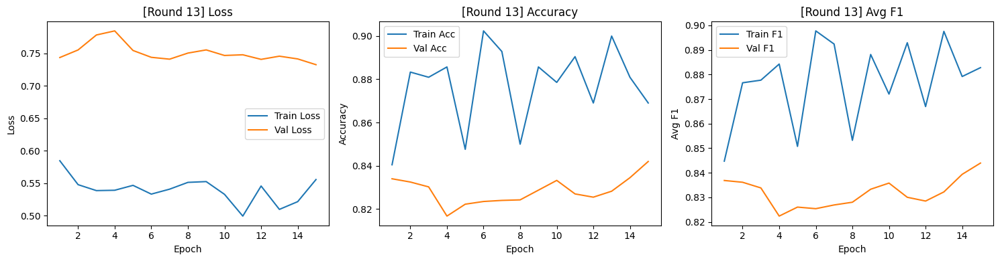


[AL Round 14/20] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.4842 | Acc: 0.9093 | Avg F1: 0.9040
Val   — Loss: 0.7602 | Acc: 0.8137 | Avg F1: 0.8199


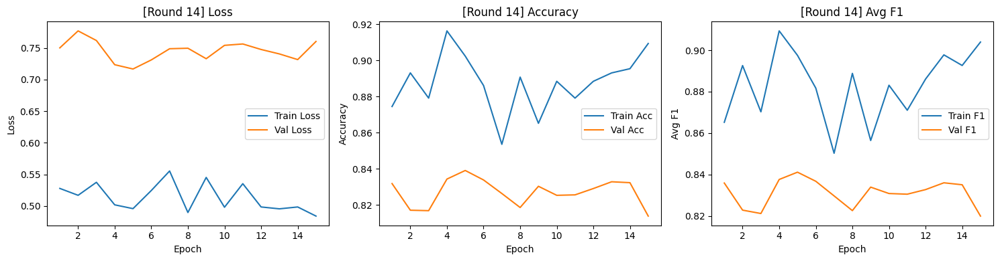


[AL Round 15/20] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.4786 | Acc: 0.9045 | Avg F1: 0.8986
Val   — Loss: 0.7385 | Acc: 0.8355 | Avg F1: 0.8386


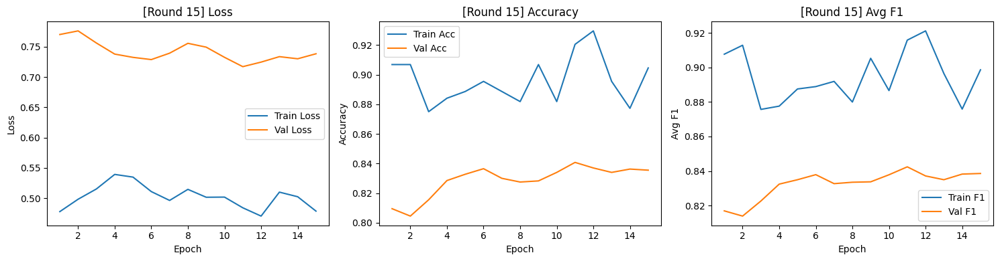


[AL Round 16/20] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.5548 | Acc: 0.8622 | Avg F1: 0.8627
Val   — Loss: 0.7271 | Acc: 0.8117 | Avg F1: 0.8186


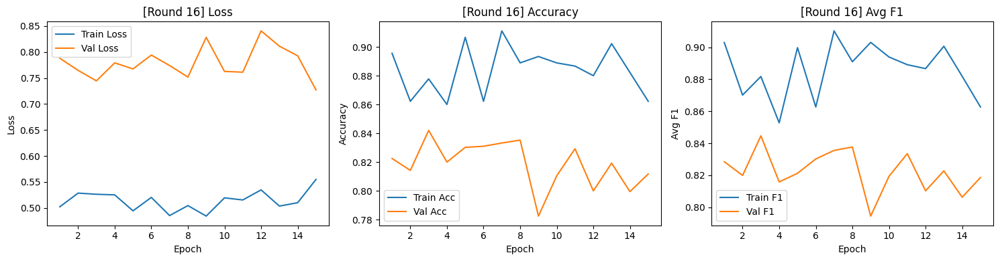


[AL Round 17/20] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.4613 | Acc: 0.9152 | Avg F1: 0.9165
Val   — Loss: 0.7488 | Acc: 0.8410 | Avg F1: 0.8424


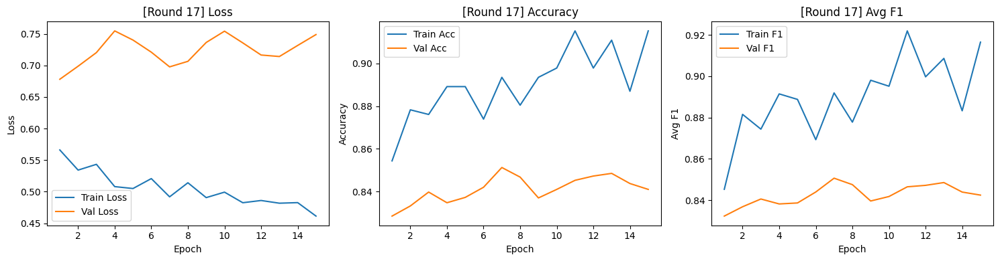


[AL Round 18/20] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.4876 | Acc: 0.8936 | Avg F1: 0.8914
Val   — Loss: 0.7477 | Acc: 0.8317 | Avg F1: 0.8339


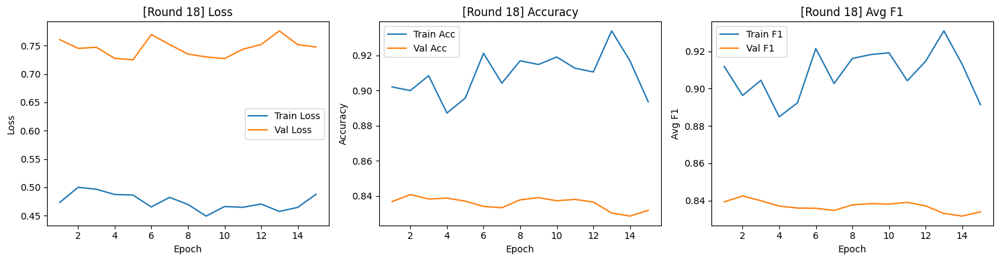


[AL Round 19/20] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.4701 | Acc: 0.9313 | Avg F1: 0.9324
Val   — Loss: 0.7345 | Acc: 0.8400 | Avg F1: 0.8402


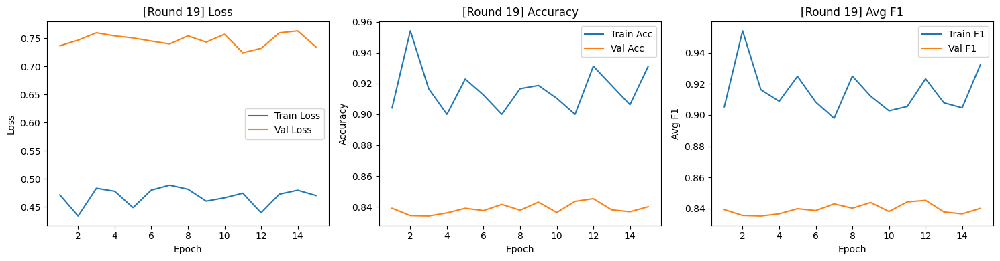


[AL Round 20/20] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.4633 | Acc: 0.9286 | Avg F1: 0.9172
Val   — Loss: 0.7774 | Acc: 0.8353 | Avg F1: 0.8354


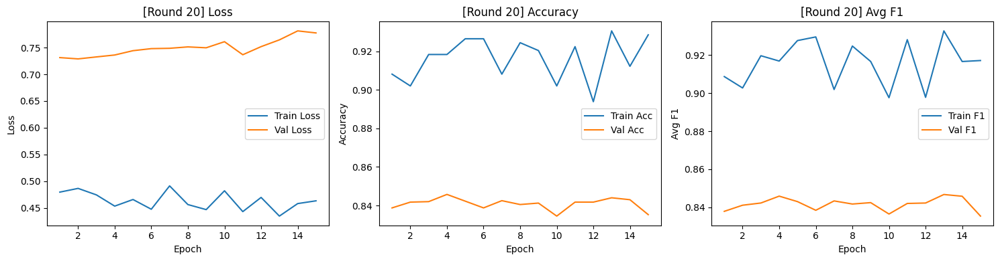

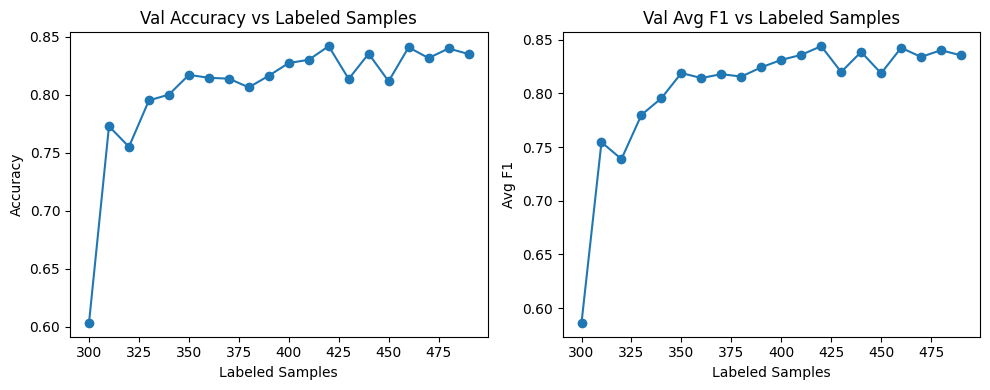


=== Running strategy: MARGIN ===

[AL Round 1/20] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.7297 | Acc: 0.5167 | Avg F1: 0.5066
Val   — Loss: 1.8943 | Acc: 0.5567 | Avg F1: 0.5529


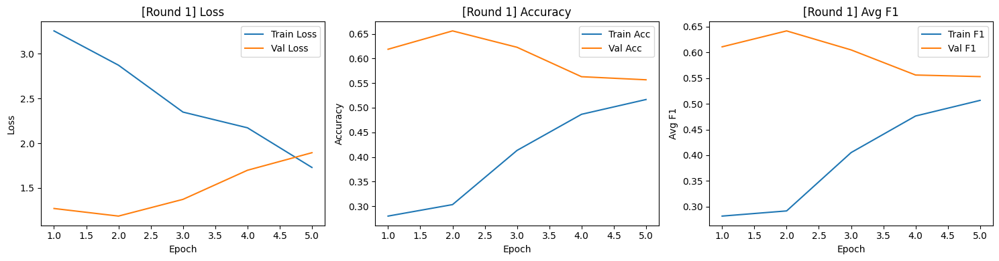


[AL Round 2/20] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.2404 | Acc: 0.7065 | Avg F1: 0.6878
Val   — Loss: 1.2866 | Acc: 0.7935 | Avg F1: 0.7862


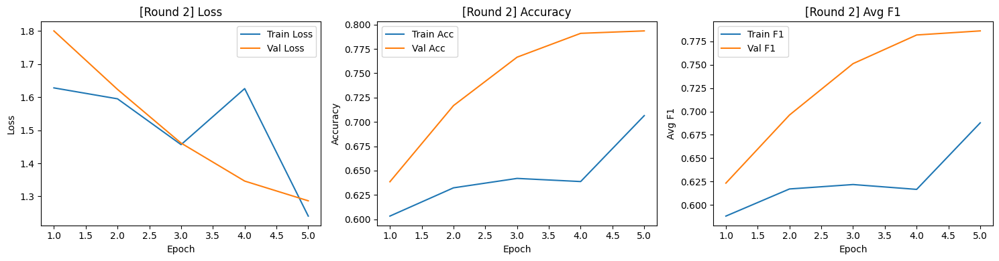


[AL Round 3/20] — Labeled samples: 320



Epoch 5/5
Train — Loss: 1.1808 | Acc: 0.6969 | Avg F1: 0.6765
Val   — Loss: 1.1698 | Acc: 0.8057 | Avg F1: 0.7988


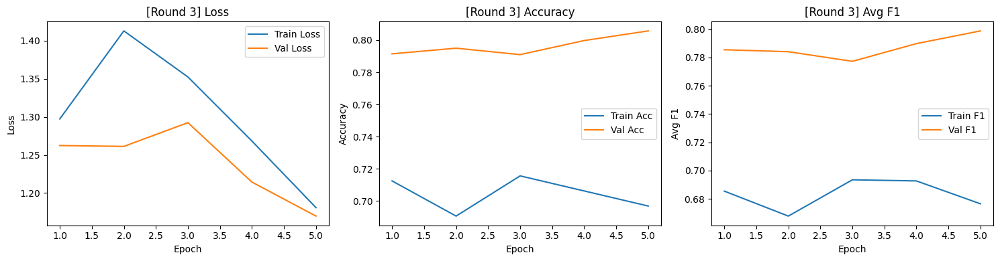


[AL Round 4/20] — Labeled samples: 330



Epoch 5/5
Train — Loss: 1.1112 | Acc: 0.6848 | Avg F1: 0.6685
Val   — Loss: 1.1556 | Acc: 0.8083 | Avg F1: 0.7951


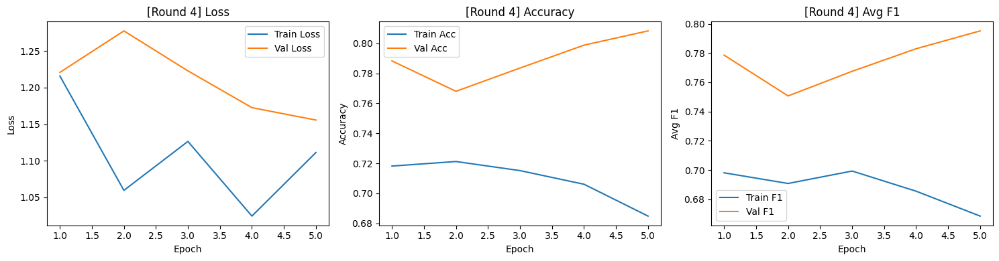


[AL Round 5/20] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.9098 | Acc: 0.7559 | Avg F1: 0.7546
Val   — Loss: 0.9584 | Acc: 0.8267 | Avg F1: 0.8277


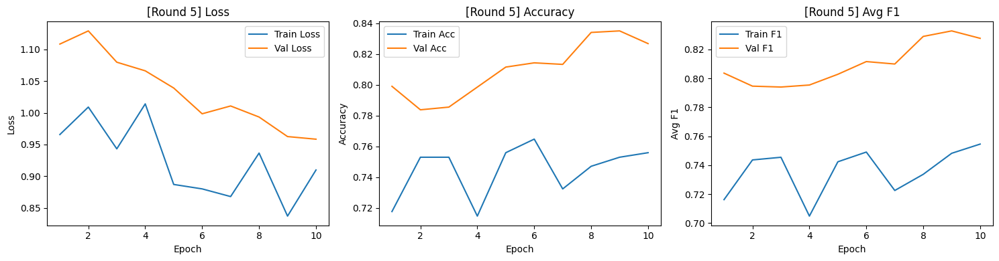


[AL Round 6/20] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.7456 | Acc: 0.7971 | Avg F1: 0.7874
Val   — Loss: 0.8923 | Acc: 0.8133 | Avg F1: 0.8113


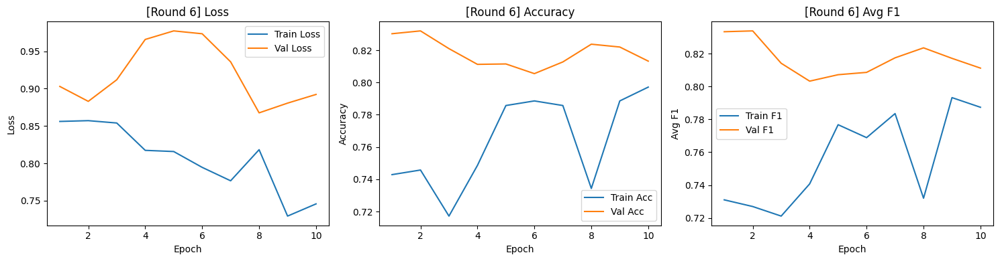


[AL Round 7/20] — Labeled samples: 360



Epoch 10/10
Train — Loss: 0.7434 | Acc: 0.7694 | Avg F1: 0.7857
Val   — Loss: 0.8145 | Acc: 0.8225 | Avg F1: 0.8230


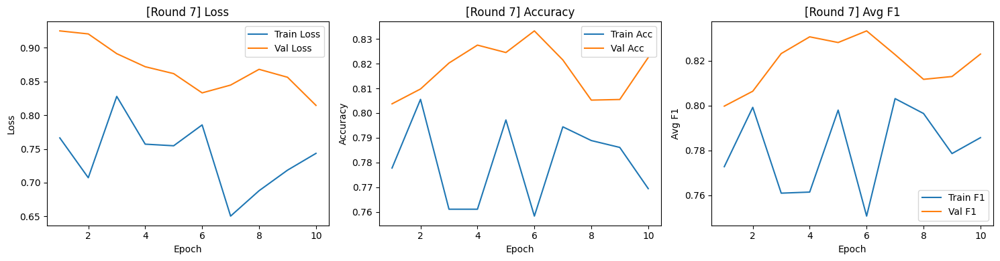


[AL Round 8/20] — Labeled samples: 370



Epoch 10/10
Train — Loss: 0.7124 | Acc: 0.7865 | Avg F1: 0.7877
Val   — Loss: 0.7663 | Acc: 0.8395 | Avg F1: 0.8445


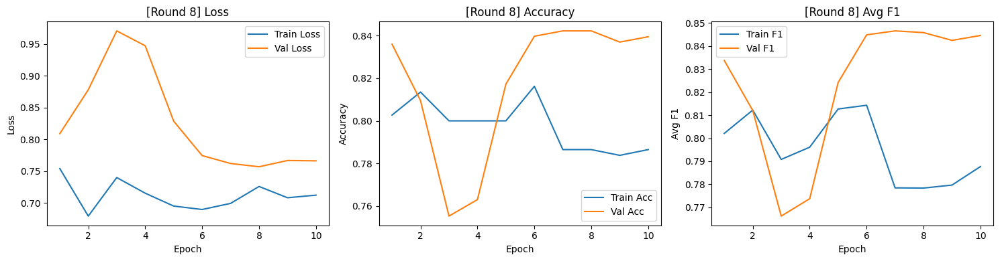


[AL Round 9/20] — Labeled samples: 380



Epoch 10/10
Train — Loss: 0.6396 | Acc: 0.8026 | Avg F1: 0.8092
Val   — Loss: 0.7307 | Acc: 0.8427 | Avg F1: 0.8468


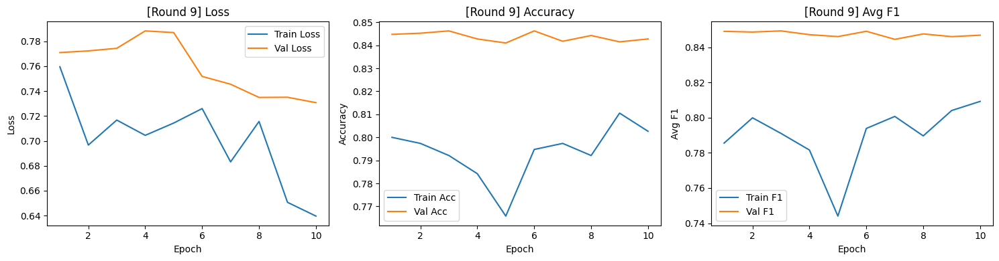


[AL Round 10/20] — Labeled samples: 390



Epoch 10/10
Train — Loss: 0.6402 | Acc: 0.8205 | Avg F1: 0.8161
Val   — Loss: 0.7430 | Acc: 0.8562 | Avg F1: 0.8583


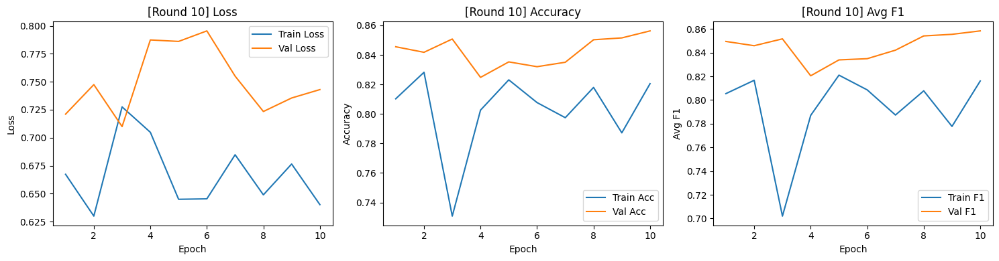


[AL Round 11/20] — Labeled samples: 400



Epoch 10/10
Train — Loss: 0.5665 | Acc: 0.8450 | Avg F1: 0.8558
Val   — Loss: 0.7020 | Acc: 0.8540 | Avg F1: 0.8571


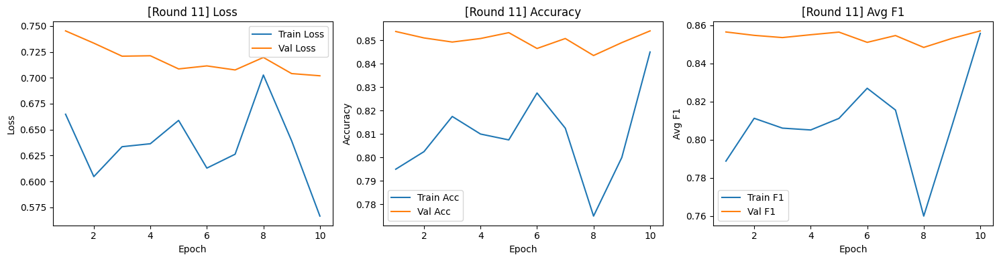


[AL Round 12/20] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.6117 | Acc: 0.8244 | Avg F1: 0.8269
Val   — Loss: 0.7217 | Acc: 0.8515 | Avg F1: 0.8537


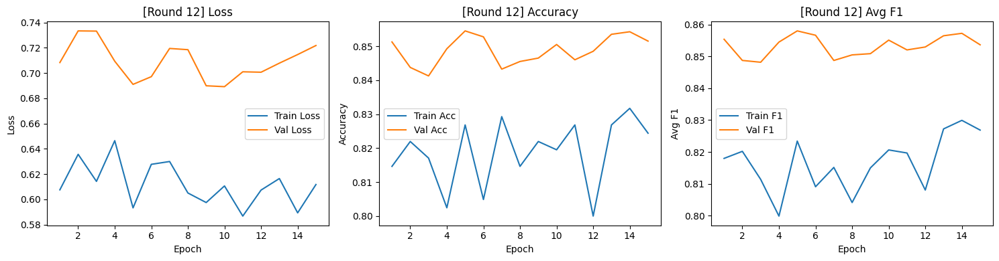


[AL Round 13/20] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.5794 | Acc: 0.8286 | Avg F1: 0.8252
Val   — Loss: 0.7016 | Acc: 0.8555 | Avg F1: 0.8602


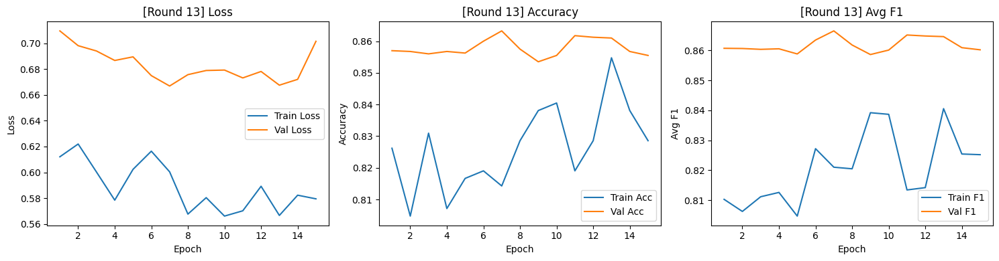


[AL Round 14/20] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.5707 | Acc: 0.8442 | Avg F1: 0.8399
Val   — Loss: 0.6620 | Acc: 0.8640 | Avg F1: 0.8663


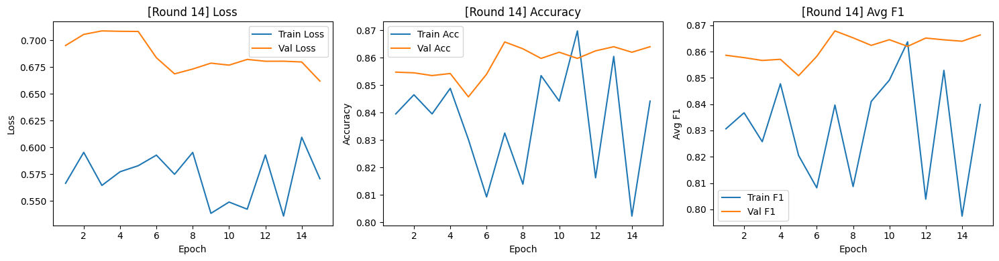


[AL Round 15/20] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.5127 | Acc: 0.8705 | Avg F1: 0.8723
Val   — Loss: 0.6773 | Acc: 0.8558 | Avg F1: 0.8587


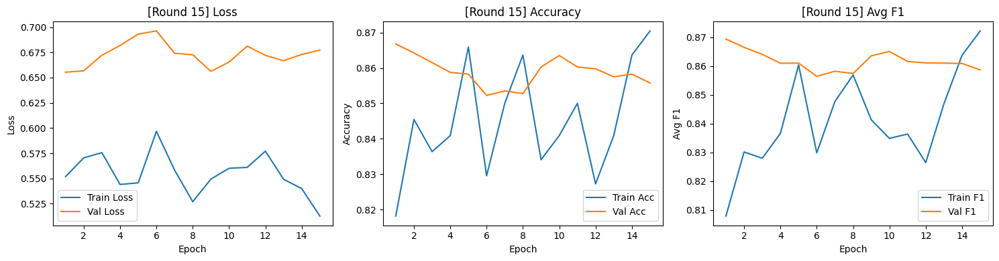


[AL Round 16/20] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.6212 | Acc: 0.8111 | Avg F1: 0.7849
Val   — Loss: 0.6796 | Acc: 0.8435 | Avg F1: 0.8448


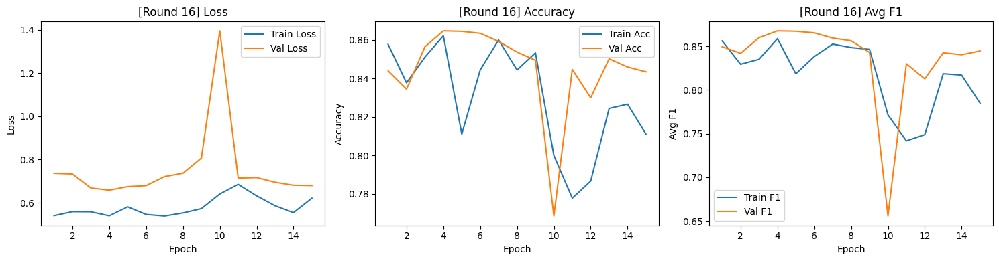


[AL Round 17/20] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.5577 | Acc: 0.8239 | Avg F1: 0.8107
Val   — Loss: 0.6246 | Acc: 0.8622 | Avg F1: 0.8631


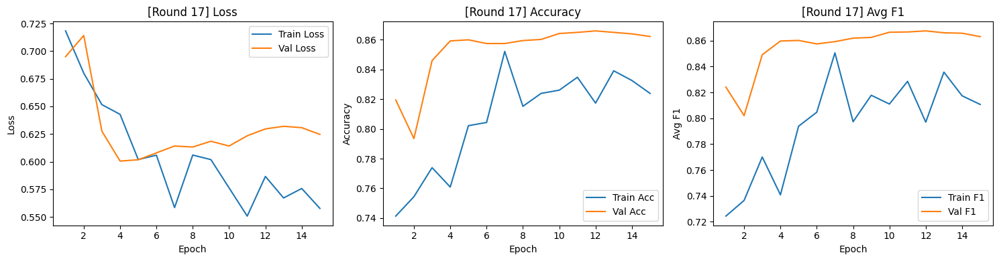


[AL Round 18/20] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.5402 | Acc: 0.8596 | Avg F1: 0.8475
Val   — Loss: 0.6436 | Acc: 0.8625 | Avg F1: 0.8642


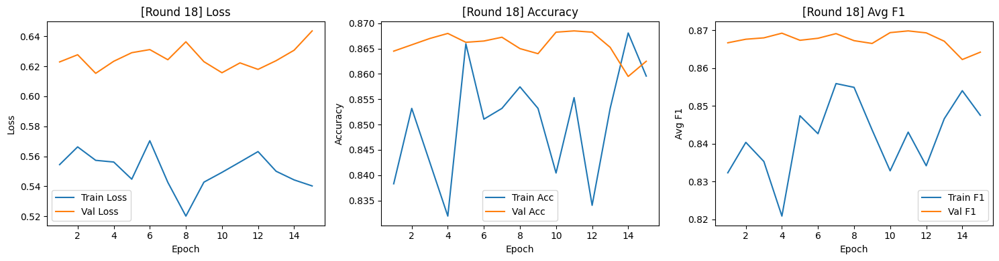


[AL Round 19/20] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.5476 | Acc: 0.8500 | Avg F1: 0.8416
Val   — Loss: 0.6155 | Acc: 0.8668 | Avg F1: 0.8671


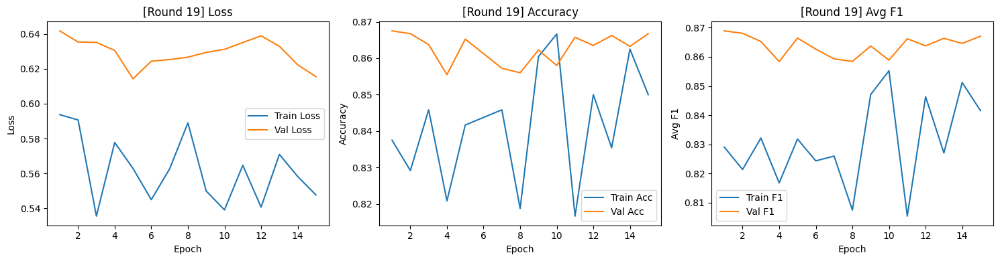


[AL Round 20/20] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.5319 | Acc: 0.8449 | Avg F1: 0.8482
Val   — Loss: 0.6325 | Acc: 0.8642 | Avg F1: 0.8647


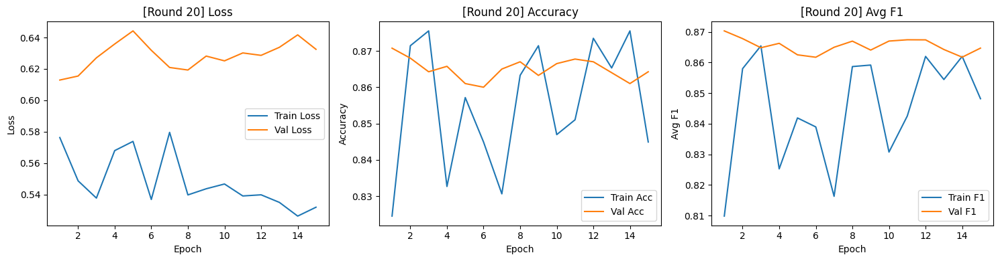

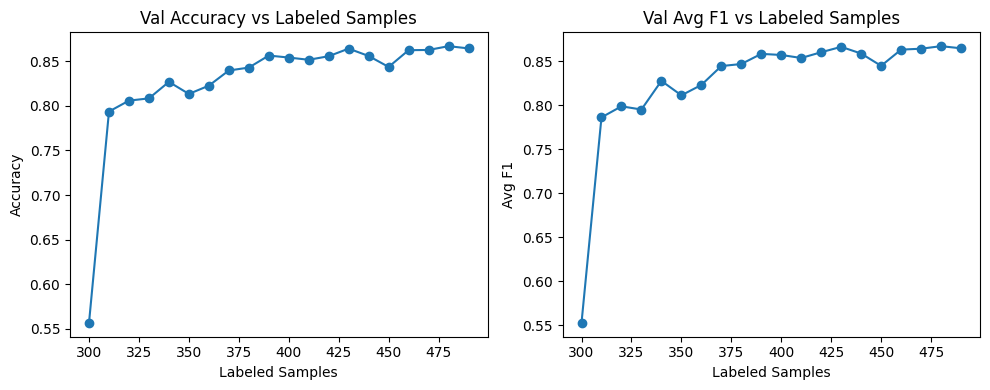


=== Running strategy: LEAST_CONFIDENT ===

[AL Round 1/20] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.8219 | Acc: 0.5467 | Avg F1: 0.5355
Val   — Loss: 1.7171 | Acc: 0.6455 | Avg F1: 0.6280


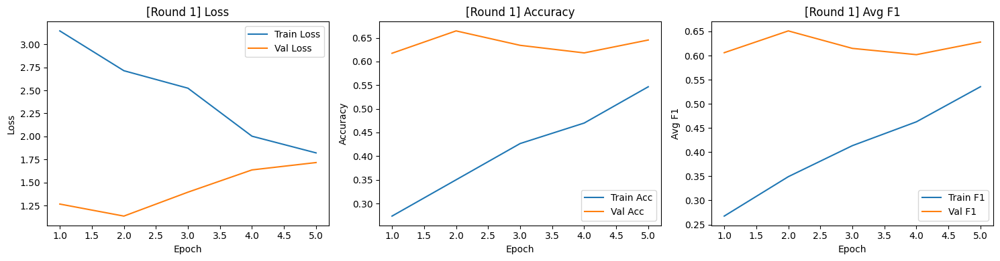


[AL Round 2/20] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.2900 | Acc: 0.6742 | Avg F1: 0.6586
Val   — Loss: 1.8440 | Acc: 0.7312 | Avg F1: 0.7082


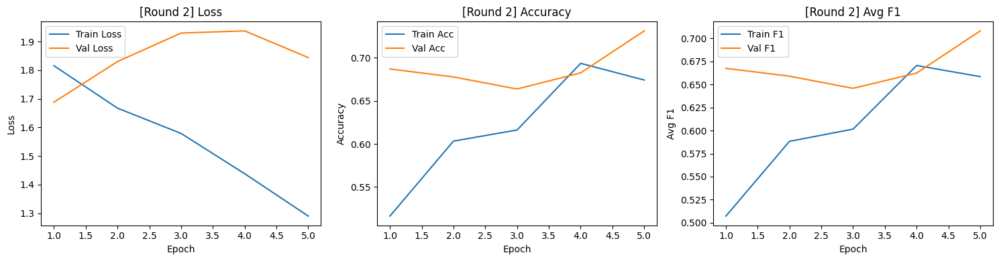


[AL Round 3/20] — Labeled samples: 320



Epoch 5/5
Train — Loss: 1.0930 | Acc: 0.7219 | Avg F1: 0.7004
Val   — Loss: 1.3278 | Acc: 0.7725 | Avg F1: 0.7694


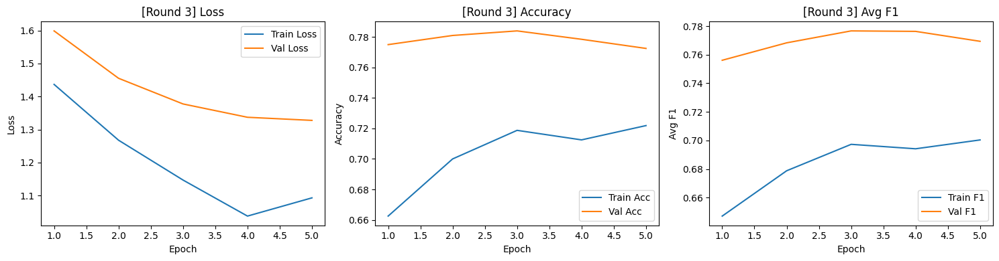


[AL Round 4/20] — Labeled samples: 330



Epoch 5/5
Train — Loss: 0.9537 | Acc: 0.7333 | Avg F1: 0.7288
Val   — Loss: 1.0422 | Acc: 0.8185 | Avg F1: 0.8066


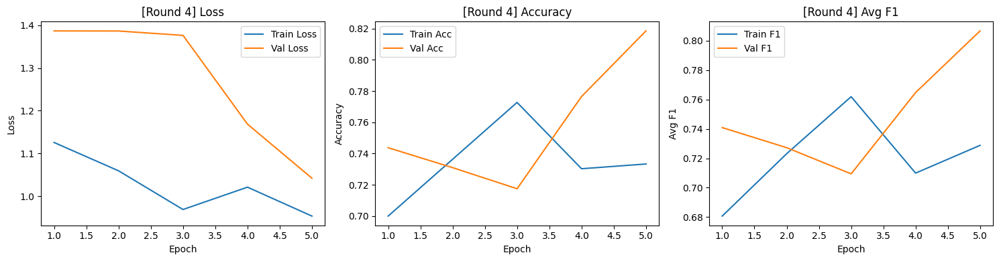


[AL Round 5/20] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.7815 | Acc: 0.7618 | Avg F1: 0.7646
Val   — Loss: 1.0969 | Acc: 0.7077 | Avg F1: 0.7146


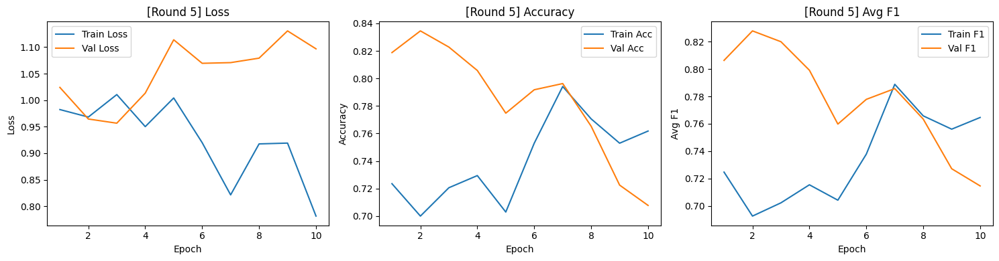


[AL Round 6/20] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.7955 | Acc: 0.7771 | Avg F1: 0.7784
Val   — Loss: 0.8963 | Acc: 0.8267 | Avg F1: 0.8259


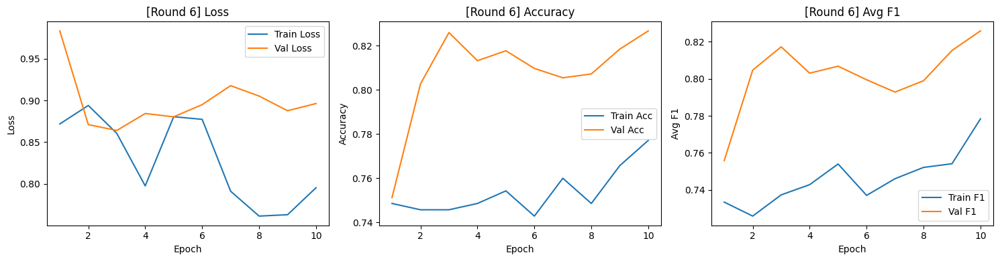


[AL Round 7/20] — Labeled samples: 360



Epoch 10/10
Train — Loss: 0.7301 | Acc: 0.7861 | Avg F1: 0.7793
Val   — Loss: 0.8513 | Acc: 0.8073 | Avg F1: 0.8059


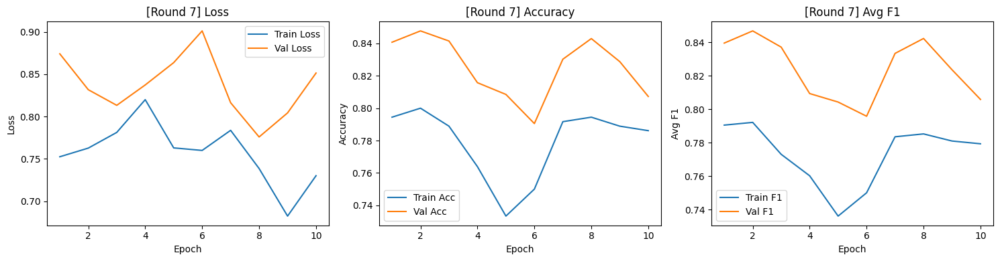


[AL Round 8/20] — Labeled samples: 370



Epoch 10/10
Train — Loss: 0.6335 | Acc: 0.8081 | Avg F1: 0.8018
Val   — Loss: 0.8428 | Acc: 0.8180 | Avg F1: 0.8194


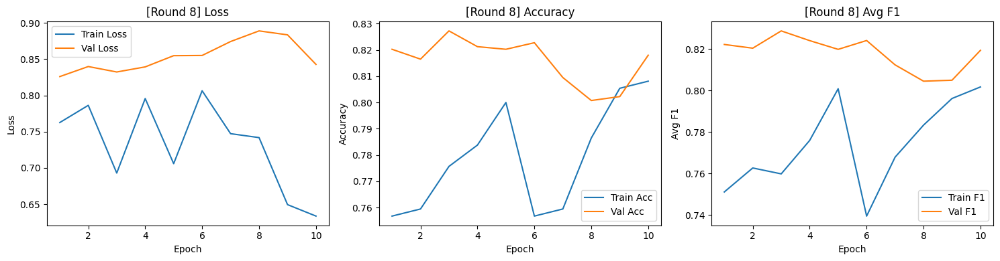


[AL Round 9/20] — Labeled samples: 380



Epoch 10/10
Train — Loss: 0.6758 | Acc: 0.7684 | Avg F1: 0.7594
Val   — Loss: 0.7982 | Acc: 0.8177 | Avg F1: 0.8245


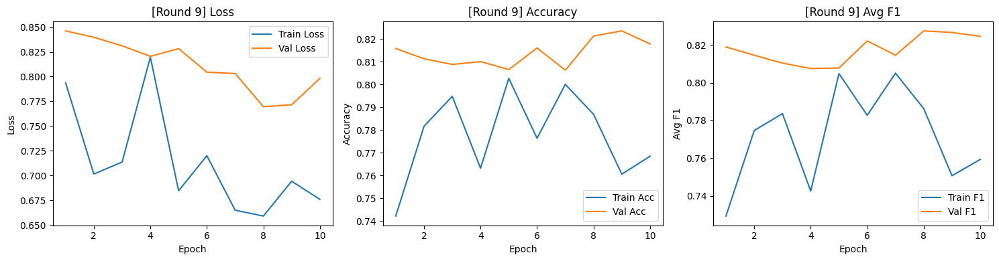


[AL Round 10/20] — Labeled samples: 390



Epoch 10/10
Train — Loss: 0.6288 | Acc: 0.8231 | Avg F1: 0.8175
Val   — Loss: 0.7831 | Acc: 0.8265 | Avg F1: 0.8351


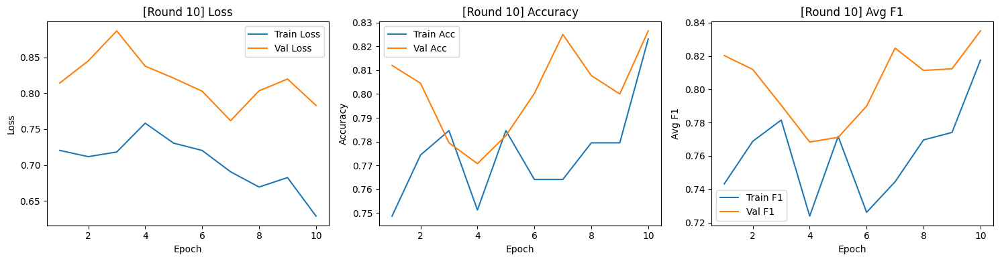


[AL Round 11/20] — Labeled samples: 400



Epoch 10/10
Train — Loss: 0.5957 | Acc: 0.8350 | Avg F1: 0.8208
Val   — Loss: 0.7842 | Acc: 0.8157 | Avg F1: 0.8240


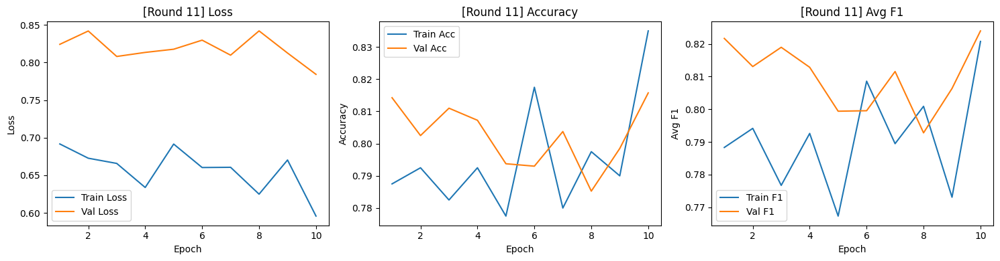


[AL Round 12/20] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.6408 | Acc: 0.8024 | Avg F1: 0.7993
Val   — Loss: 0.7775 | Acc: 0.8180 | Avg F1: 0.8249


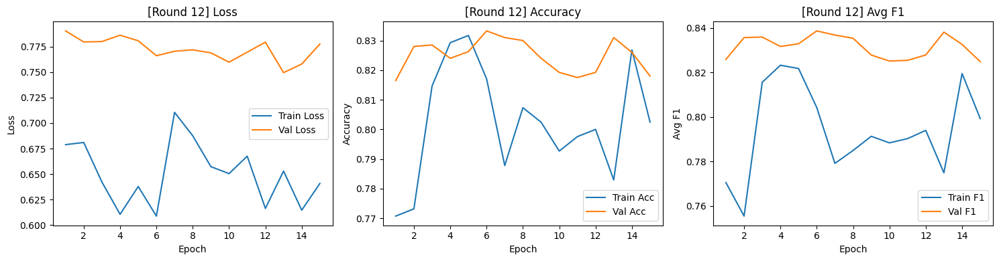


[AL Round 13/20] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.5832 | Acc: 0.8381 | Avg F1: 0.8278
Val   — Loss: 0.7550 | Acc: 0.8353 | Avg F1: 0.8388


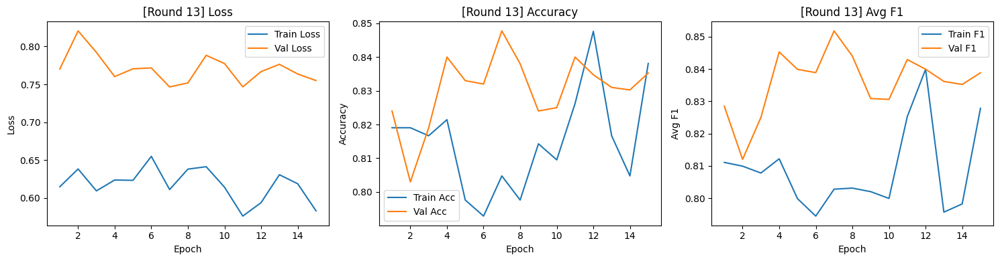


[AL Round 14/20] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.5766 | Acc: 0.8581 | Avg F1: 0.8487
Val   — Loss: 0.7738 | Acc: 0.8333 | Avg F1: 0.8408


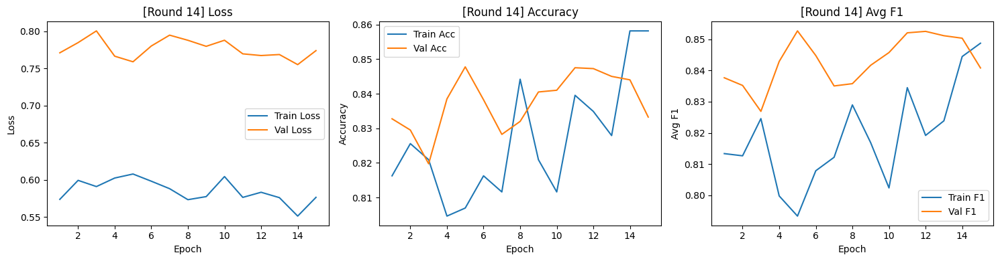


[AL Round 15/20] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.5706 | Acc: 0.8614 | Avg F1: 0.8554
Val   — Loss: 0.7867 | Acc: 0.8270 | Avg F1: 0.8344


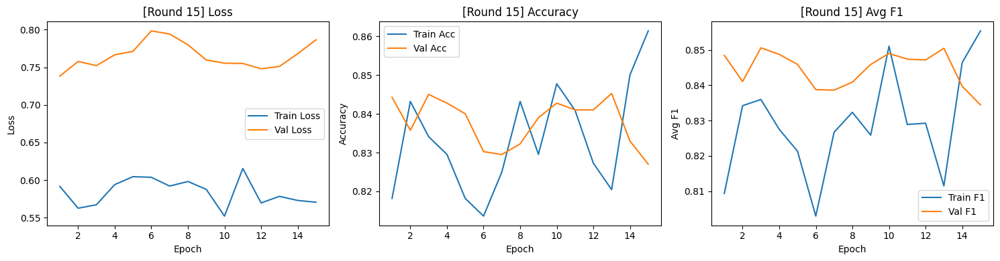


[AL Round 16/20] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.6166 | Acc: 0.8422 | Avg F1: 0.8362
Val   — Loss: 0.7637 | Acc: 0.8455 | Avg F1: 0.8516


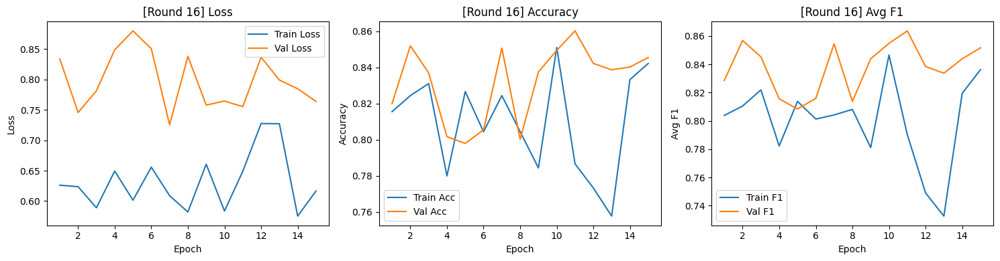


[AL Round 17/20] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.5849 | Acc: 0.8261 | Avg F1: 0.8233
Val   — Loss: 0.7878 | Acc: 0.8345 | Avg F1: 0.8422


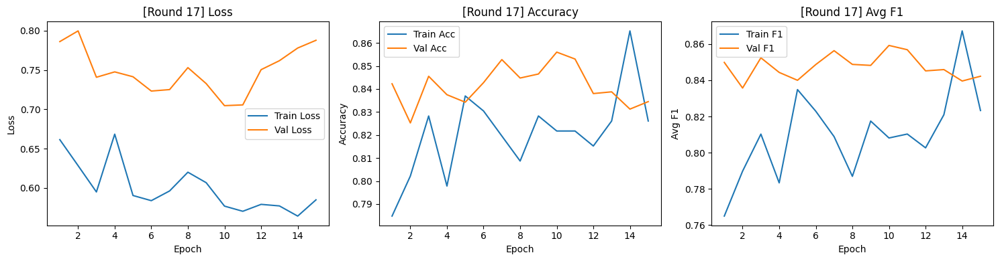


[AL Round 18/20] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.5761 | Acc: 0.8319 | Avg F1: 0.8195
Val   — Loss: 0.7600 | Acc: 0.8400 | Avg F1: 0.8458


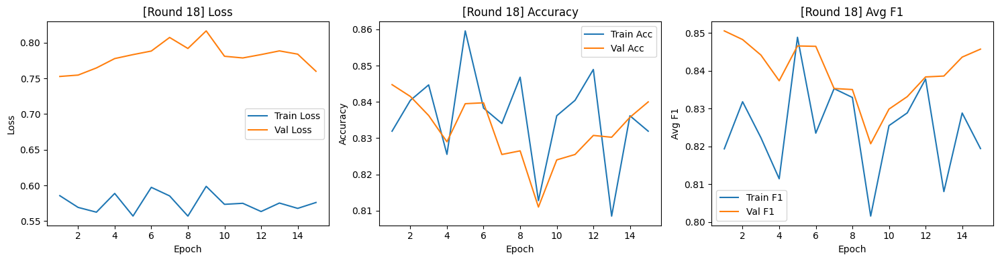


[AL Round 19/20] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.5708 | Acc: 0.8458 | Avg F1: 0.8422
Val   — Loss: 0.7794 | Acc: 0.8478 | Avg F1: 0.8523


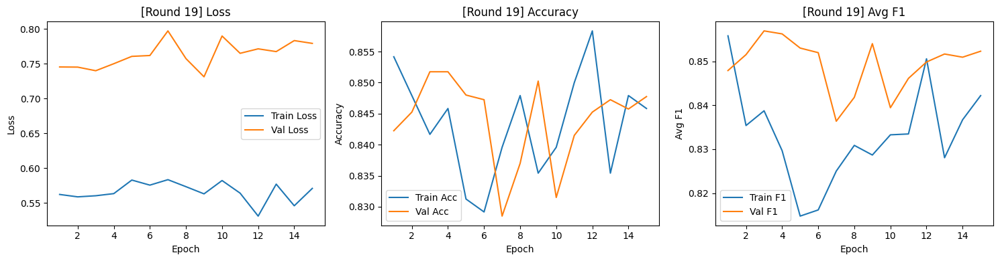


[AL Round 20/20] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.5485 | Acc: 0.8571 | Avg F1: 0.8358
Val   — Loss: 0.7600 | Acc: 0.8452 | Avg F1: 0.8500


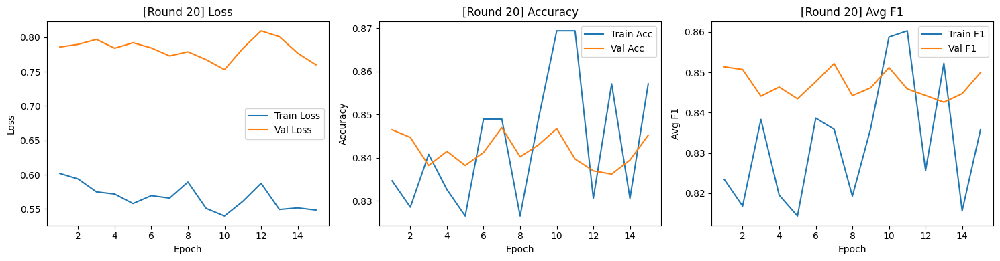

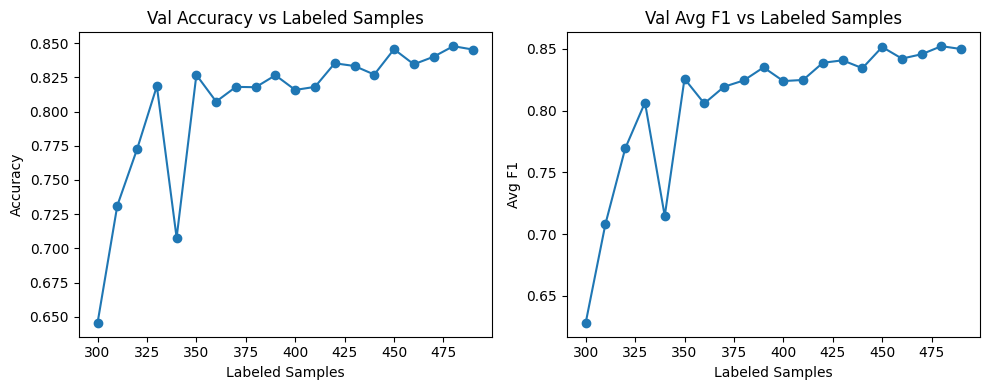


=== Running strategy: DENSITY ===

[AL Round 1/20] — Labeled samples: 300



Epoch 5/5
Train — Loss: 1.8733 | Acc: 0.5200 | Avg F1: 0.5114
Val   — Loss: 1.8353 | Acc: 0.6078 | Avg F1: 0.5963


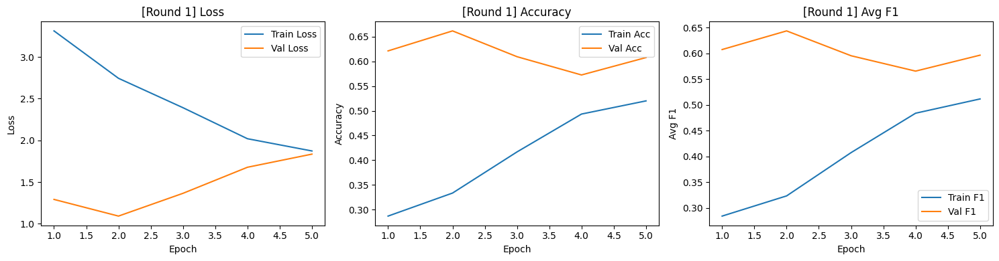


[AL Round 2/20] — Labeled samples: 310



Epoch 5/5
Train — Loss: 1.3159 | Acc: 0.7258 | Avg F1: 0.7048
Val   — Loss: 1.5194 | Acc: 0.7582 | Avg F1: 0.7349


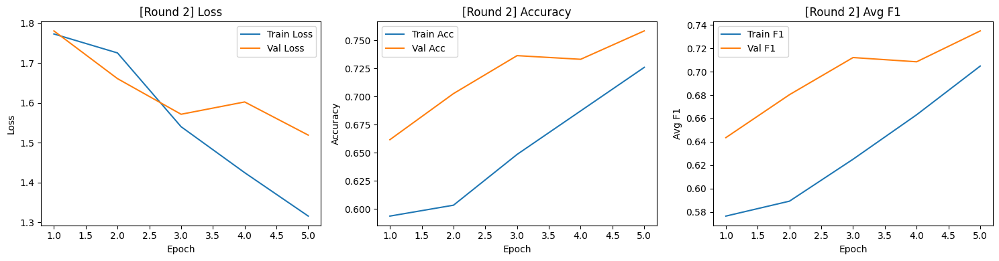


[AL Round 3/20] — Labeled samples: 320



Epoch 5/5
Train — Loss: 1.1846 | Acc: 0.7156 | Avg F1: 0.6878
Val   — Loss: 1.2054 | Acc: 0.8033 | Avg F1: 0.7977


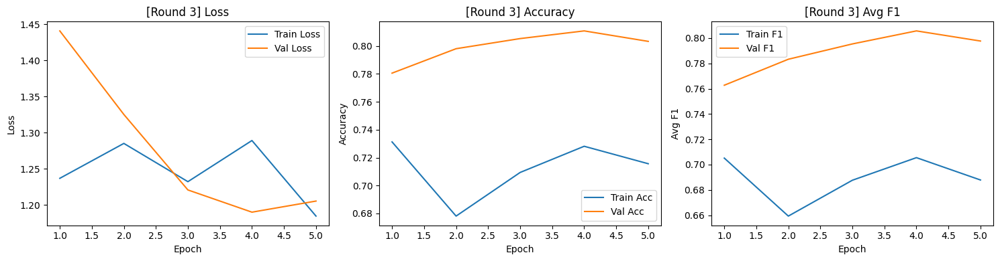


[AL Round 4/20] — Labeled samples: 330



Epoch 5/5
Train — Loss: 0.9002 | Acc: 0.7727 | Avg F1: 0.7479
Val   — Loss: 1.0862 | Acc: 0.8140 | Avg F1: 0.8086


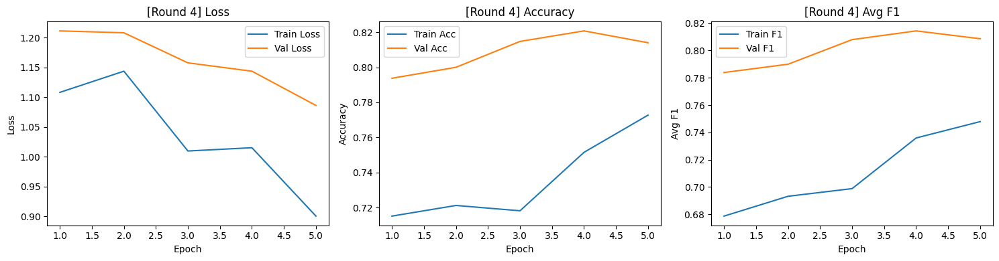


[AL Round 5/20] — Labeled samples: 340



Epoch 10/10
Train — Loss: 0.7546 | Acc: 0.8088 | Avg F1: 0.8053
Val   — Loss: 0.9707 | Acc: 0.8150 | Avg F1: 0.8122


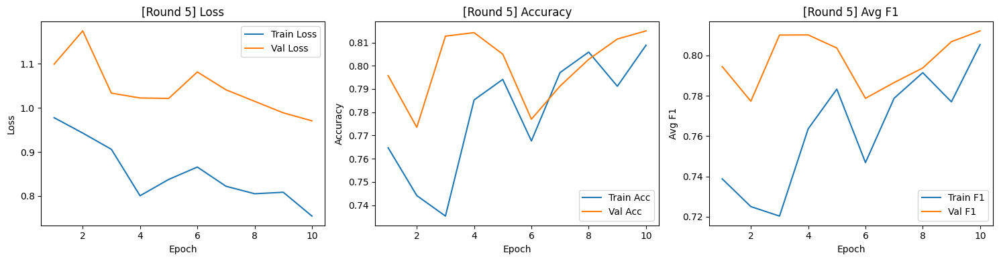


[AL Round 6/20] — Labeled samples: 350



Epoch 10/10
Train — Loss: 0.6842 | Acc: 0.8200 | Avg F1: 0.8114
Val   — Loss: 0.8725 | Acc: 0.8115 | Avg F1: 0.8195


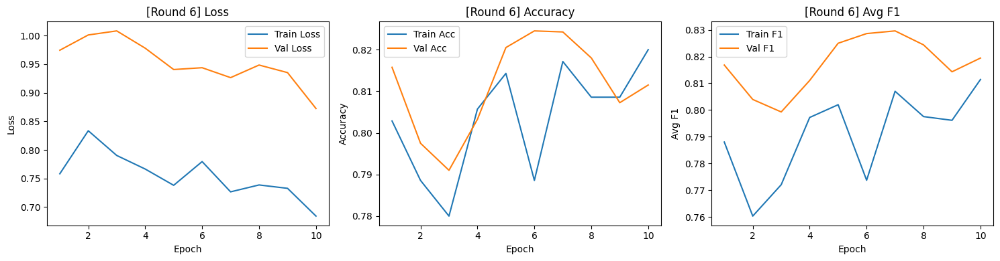


[AL Round 7/20] — Labeled samples: 360



Epoch 10/10
Train — Loss: 0.5836 | Acc: 0.8583 | Avg F1: 0.8520
Val   — Loss: 0.9567 | Acc: 0.7708 | Avg F1: 0.7793


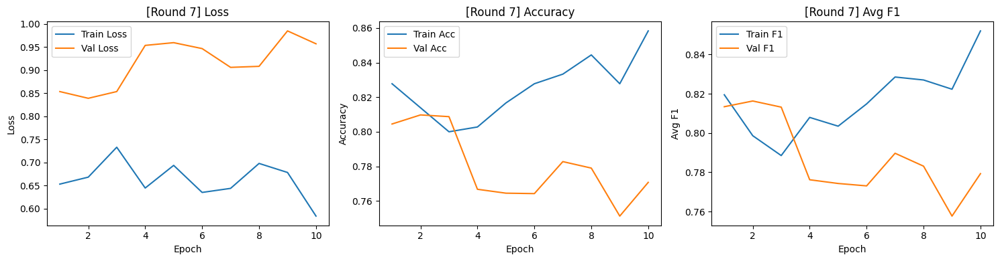


[AL Round 8/20] — Labeled samples: 370



Epoch 10/10
Train — Loss: 0.6241 | Acc: 0.8405 | Avg F1: 0.8333
Val   — Loss: 1.0003 | Acc: 0.7535 | Avg F1: 0.7652


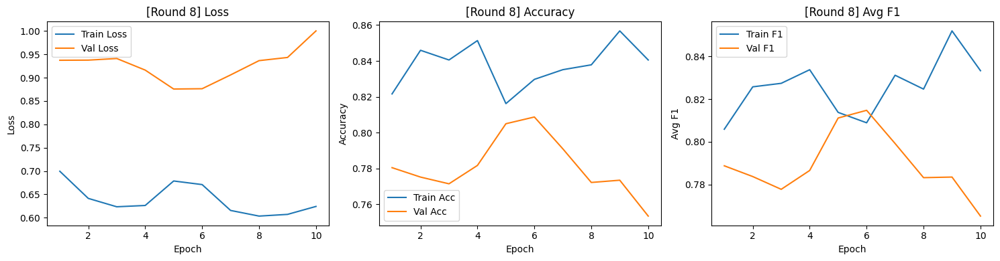


[AL Round 9/20] — Labeled samples: 380



Epoch 10/10
Train — Loss: 0.5873 | Acc: 0.8632 | Avg F1: 0.8488
Val   — Loss: 0.8670 | Acc: 0.7995 | Avg F1: 0.8049


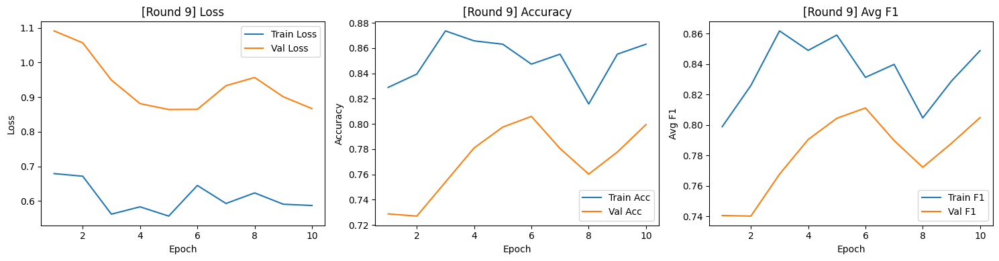


[AL Round 10/20] — Labeled samples: 390



Epoch 10/10
Train — Loss: 0.5838 | Acc: 0.8487 | Avg F1: 0.8427
Val   — Loss: 0.9329 | Acc: 0.7442 | Avg F1: 0.7532


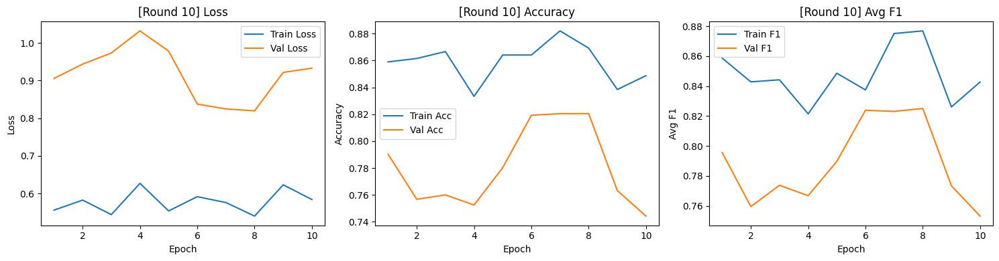


[AL Round 11/20] — Labeled samples: 400



Epoch 10/10
Train — Loss: 0.5405 | Acc: 0.8725 | Avg F1: 0.8647
Val   — Loss: 0.7786 | Acc: 0.8043 | Avg F1: 0.8055


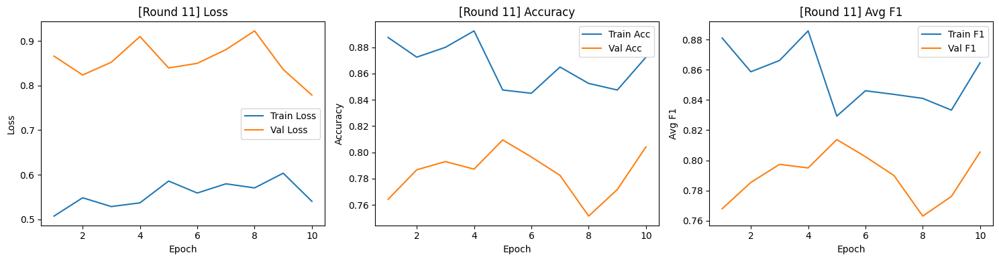


[AL Round 12/20] — Labeled samples: 410



Epoch 15/15
Train — Loss: 0.5688 | Acc: 0.8732 | Avg F1: 0.8475
Val   — Loss: 0.7744 | Acc: 0.8203 | Avg F1: 0.8211


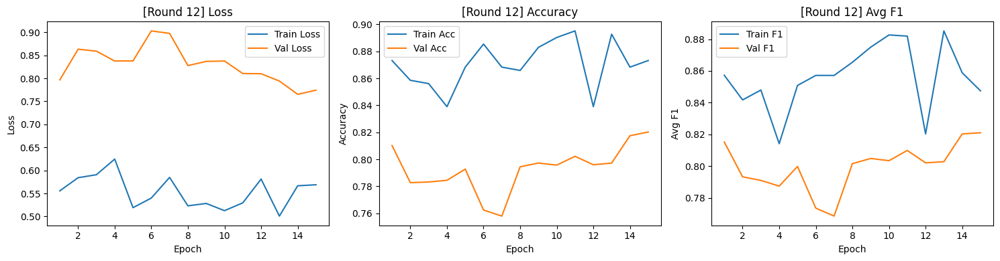


[AL Round 13/20] — Labeled samples: 420



Epoch 15/15
Train — Loss: 0.5193 | Acc: 0.8738 | Avg F1: 0.8551
Val   — Loss: 0.7419 | Acc: 0.8313 | Avg F1: 0.8347


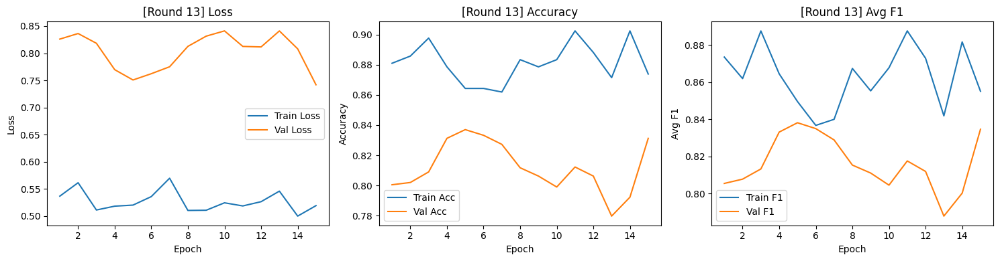


[AL Round 14/20] — Labeled samples: 430



Epoch 15/15
Train — Loss: 0.4996 | Acc: 0.8953 | Avg F1: 0.8853
Val   — Loss: 0.7833 | Acc: 0.8153 | Avg F1: 0.8171


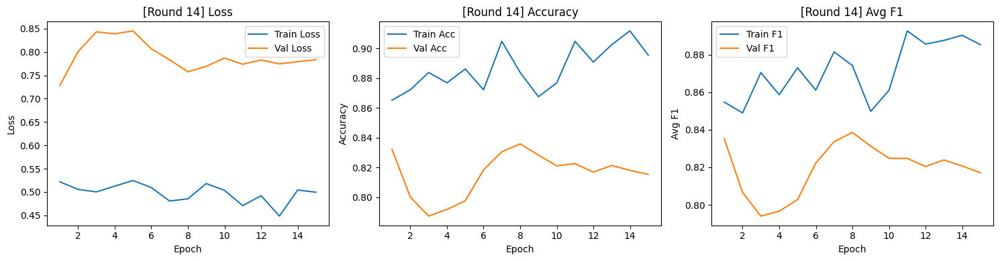


[AL Round 15/20] — Labeled samples: 440



Epoch 15/15
Train — Loss: 0.4717 | Acc: 0.9068 | Avg F1: 0.8912
Val   — Loss: 0.7880 | Acc: 0.8187 | Avg F1: 0.8232


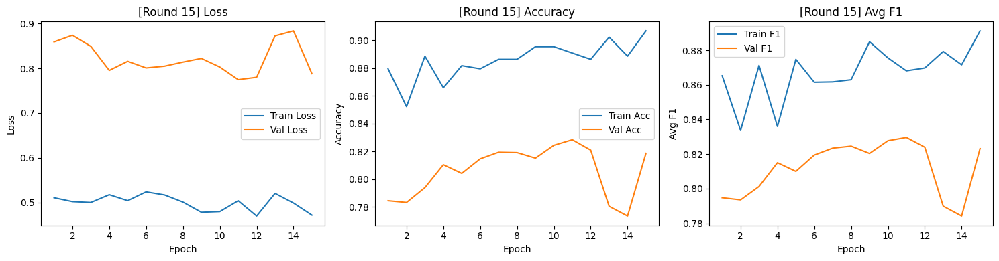


[AL Round 16/20] — Labeled samples: 450



Epoch 15/15
Train — Loss: 0.5213 | Acc: 0.8822 | Avg F1: 0.8470
Val   — Loss: 0.8277 | Acc: 0.7923 | Avg F1: 0.7955


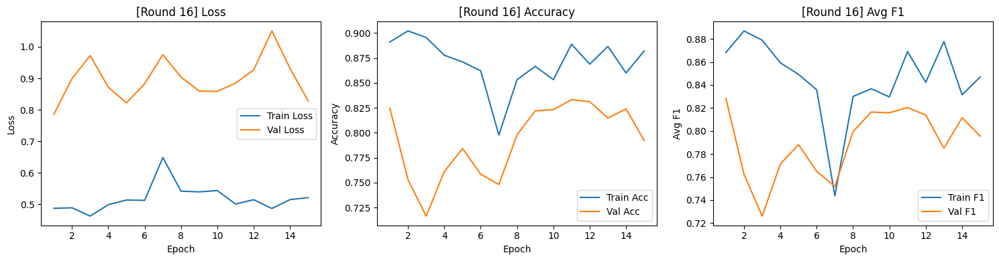


[AL Round 17/20] — Labeled samples: 460



Epoch 15/15
Train — Loss: 0.4955 | Acc: 0.8935 | Avg F1: 0.8808
Val   — Loss: 0.8569 | Acc: 0.7913 | Avg F1: 0.7984


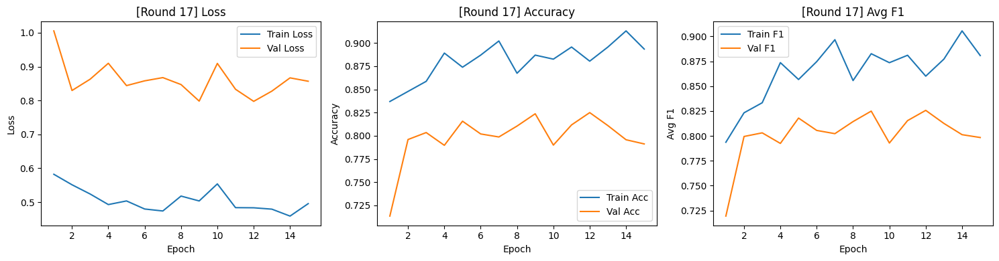


[AL Round 18/20] — Labeled samples: 470



Epoch 15/15
Train — Loss: 0.4635 | Acc: 0.8957 | Avg F1: 0.8852
Val   — Loss: 0.8191 | Acc: 0.8097 | Avg F1: 0.8172


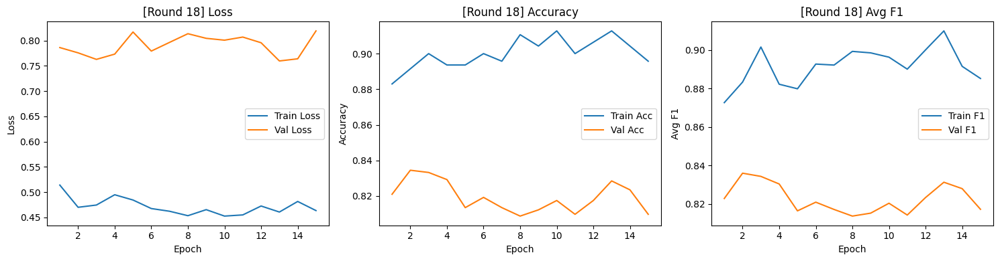


[AL Round 19/20] — Labeled samples: 480



Epoch 15/15
Train — Loss: 0.4461 | Acc: 0.9083 | Avg F1: 0.9028
Val   — Loss: 0.8173 | Acc: 0.8080 | Avg F1: 0.8117


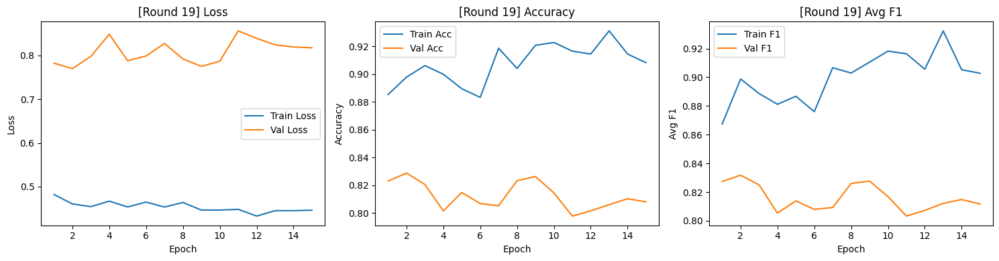


[AL Round 20/20] — Labeled samples: 490



Epoch 15/15
Train — Loss: 0.4163 | Acc: 0.9347 | Avg F1: 0.9338
Val   — Loss: 0.8231 | Acc: 0.8133 | Avg F1: 0.8172


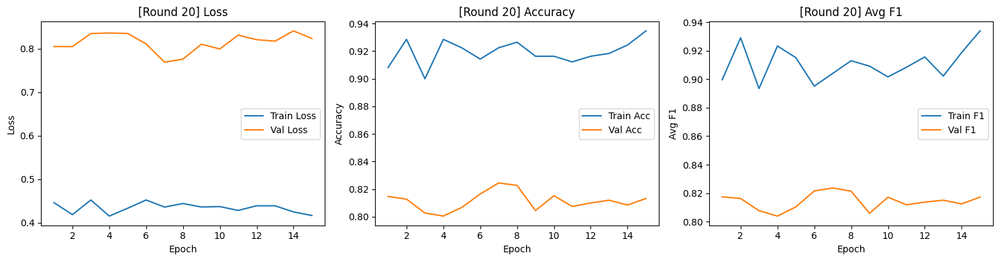

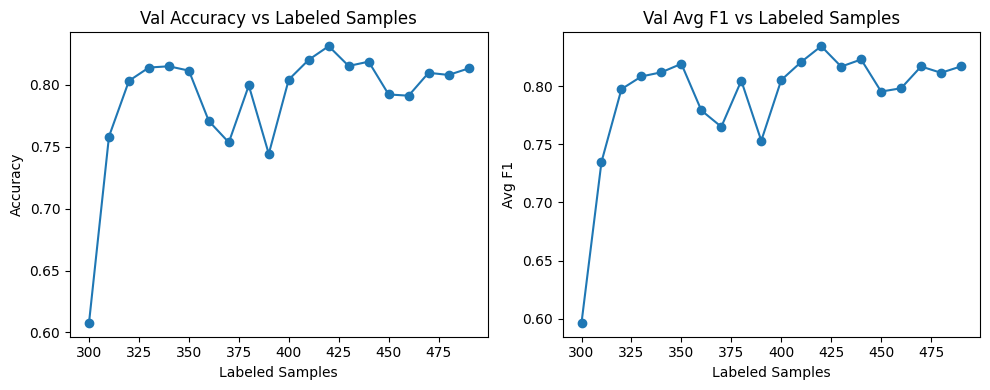

X_labeled shape: (500, 6, 28)
y_labeled shape: (500,)
X_unlabeled shape: (15500, 6, 28)
y_unlabeled shape: (15500,)

=== Running strategy: RANDOM ===

[AL Round 1/20] — Labeled samples: 500



Epoch 5/5
Train — Loss: 1.7452 | Acc: 0.5840 | Avg F1: 0.5683
Val   — Loss: 1.6242 | Acc: 0.7328 | Avg F1: 0.7092


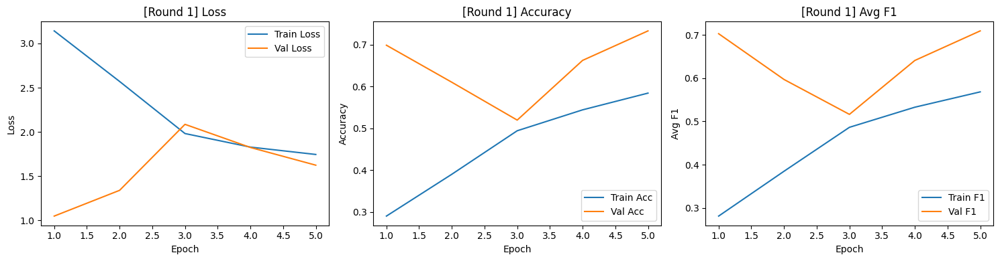


[AL Round 2/20] — Labeled samples: 510



Epoch 5/5
Train — Loss: 1.1816 | Acc: 0.7137 | Avg F1: 0.6905
Val   — Loss: 1.2271 | Acc: 0.8125 | Avg F1: 0.7990


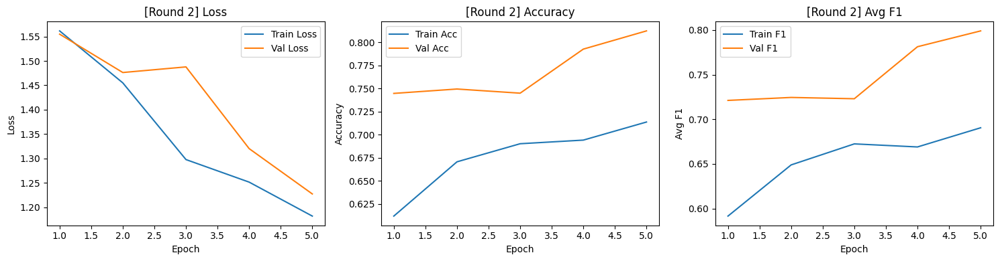


[AL Round 3/20] — Labeled samples: 520



Epoch 5/5
Train — Loss: 0.9775 | Acc: 0.7346 | Avg F1: 0.7097
Val   — Loss: 1.0629 | Acc: 0.8163 | Avg F1: 0.8068


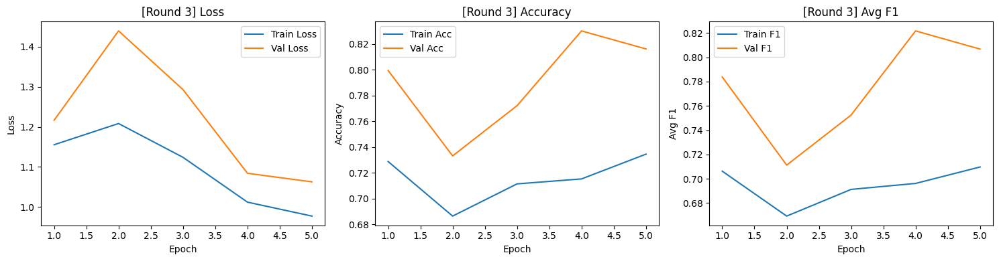


[AL Round 4/20] — Labeled samples: 530



Epoch 5/5
Train — Loss: 0.8197 | Acc: 0.7887 | Avg F1: 0.7723
Val   — Loss: 0.9759 | Acc: 0.8093 | Avg F1: 0.7978


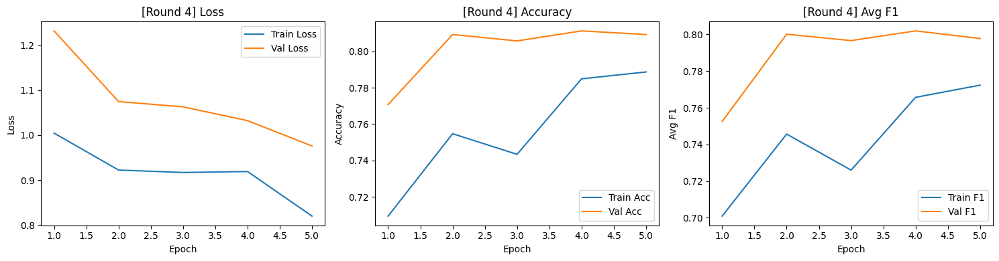


[AL Round 5/20] — Labeled samples: 540



Epoch 10/10
Train — Loss: 0.7038 | Acc: 0.8222 | Avg F1: 0.8185
Val   — Loss: 0.8397 | Acc: 0.8393 | Avg F1: 0.8449


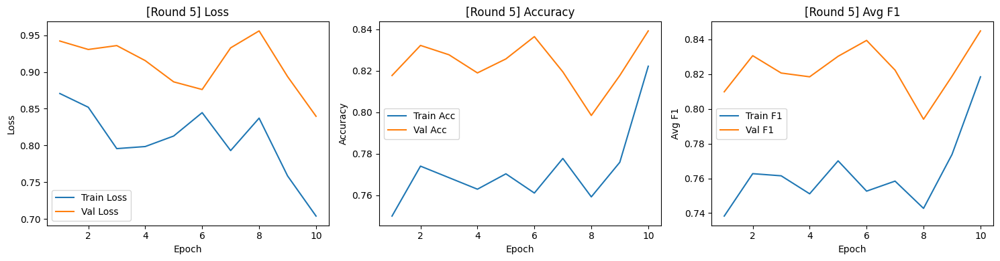


[AL Round 6/20] — Labeled samples: 550



Epoch 10/10
Train — Loss: 0.6620 | Acc: 0.8091 | Avg F1: 0.7985
Val   — Loss: 0.7598 | Acc: 0.8237 | Avg F1: 0.8317


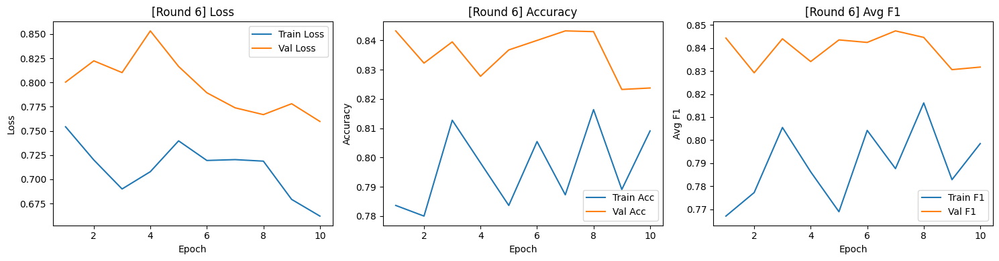


[AL Round 7/20] — Labeled samples: 560



Epoch 10/10
Train — Loss: 0.6297 | Acc: 0.8214 | Avg F1: 0.8219
Val   — Loss: 0.7501 | Acc: 0.8317 | Avg F1: 0.8411


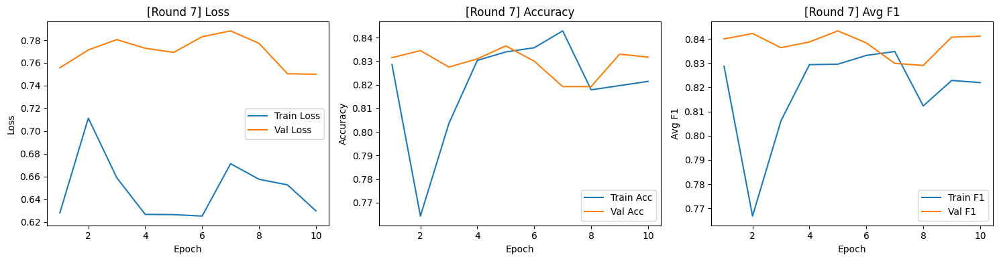


[AL Round 8/20] — Labeled samples: 570



Epoch 10/10
Train — Loss: 0.6164 | Acc: 0.8351 | Avg F1: 0.8343
Val   — Loss: 0.7123 | Acc: 0.8400 | Avg F1: 0.8443


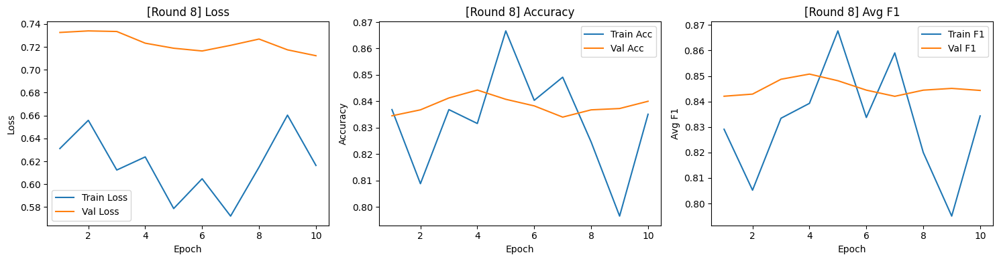


[AL Round 9/20] — Labeled samples: 580



Epoch 10/10
Train — Loss: 0.5702 | Acc: 0.8379 | Avg F1: 0.8300
Val   — Loss: 0.7146 | Acc: 0.8297 | Avg F1: 0.8365


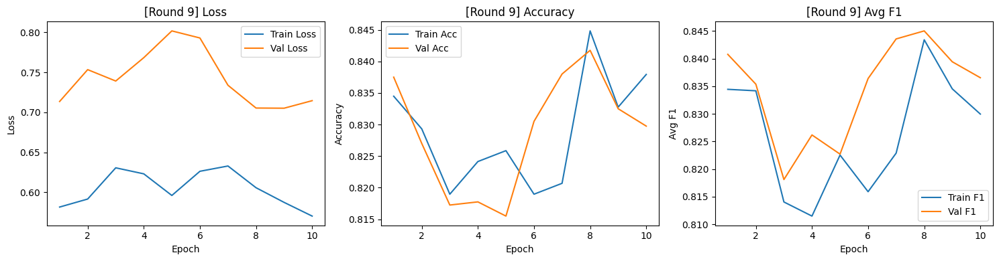


[AL Round 10/20] — Labeled samples: 590



Epoch 10/10
Train — Loss: 0.5501 | Acc: 0.8627 | Avg F1: 0.8635
Val   — Loss: 0.7098 | Acc: 0.8290 | Avg F1: 0.8366


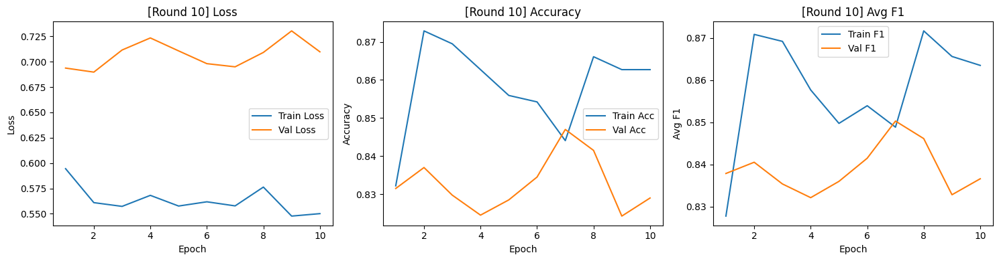


[AL Round 11/20] — Labeled samples: 600



Epoch 10/10
Train — Loss: 0.5396 | Acc: 0.8600 | Avg F1: 0.8558
Val   — Loss: 0.7023 | Acc: 0.8297 | Avg F1: 0.8376


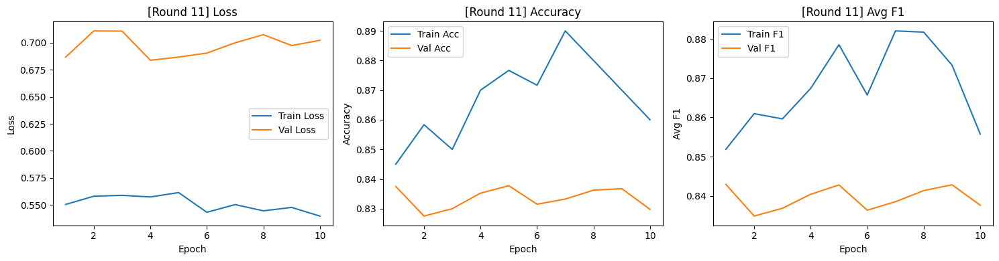


[AL Round 12/20] — Labeled samples: 610



Epoch 15/15
Train — Loss: 0.4998 | Acc: 0.8869 | Avg F1: 0.8867
Val   — Loss: 0.7119 | Acc: 0.8325 | Avg F1: 0.8361


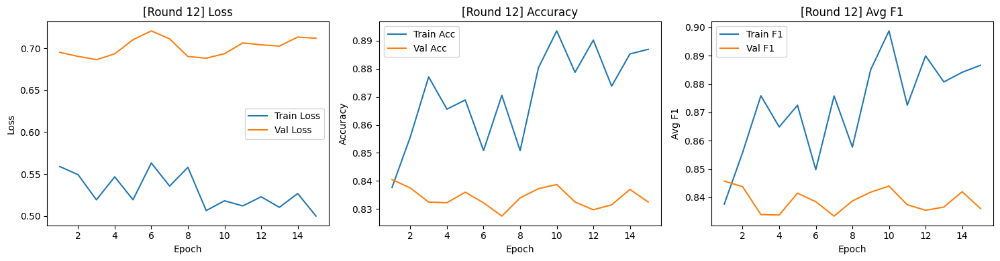


[AL Round 13/20] — Labeled samples: 620



Epoch 15/15
Train — Loss: 0.5070 | Acc: 0.8742 | Avg F1: 0.8750
Val   — Loss: 0.6817 | Acc: 0.8397 | Avg F1: 0.8427


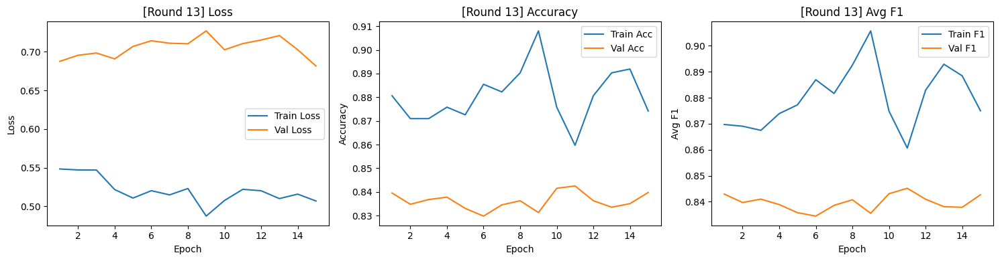


[AL Round 14/20] — Labeled samples: 630



Epoch 15/15
Train — Loss: 0.4974 | Acc: 0.8889 | Avg F1: 0.8926
Val   — Loss: 0.6629 | Acc: 0.8502 | Avg F1: 0.8502


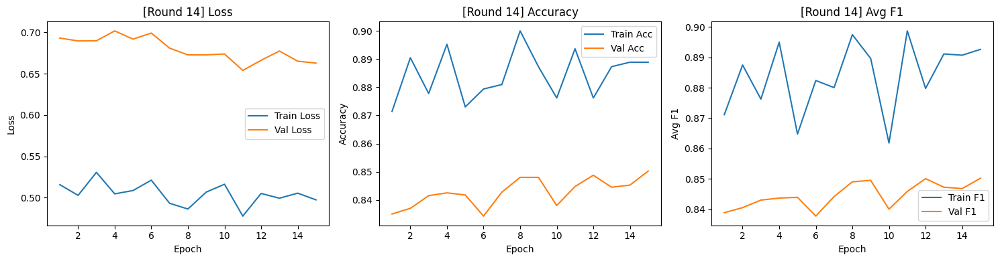


[AL Round 15/20] — Labeled samples: 640



Epoch 15/15
Train — Loss: 0.4871 | Acc: 0.9000 | Avg F1: 0.8979
Val   — Loss: 0.6589 | Acc: 0.8520 | Avg F1: 0.8533


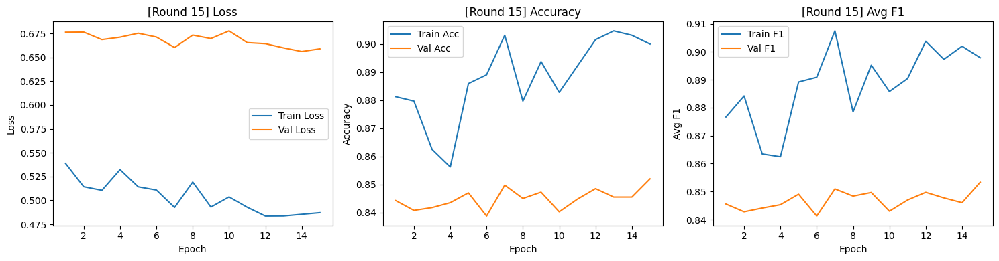


[AL Round 16/20] — Labeled samples: 650



Epoch 15/15
Train — Loss: 0.5070 | Acc: 0.8846 | Avg F1: 0.8853
Val   — Loss: 0.6705 | Acc: 0.8442 | Avg F1: 0.8479


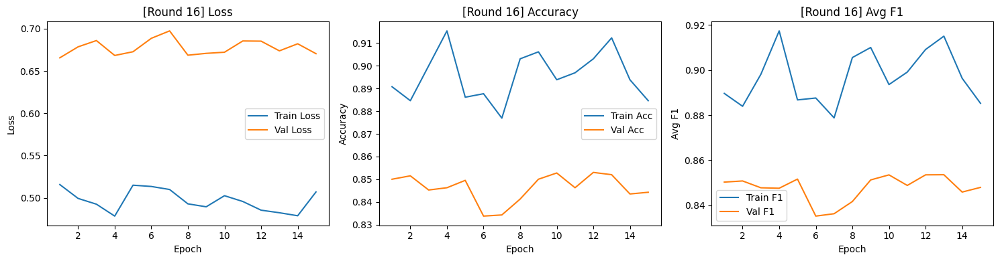


[AL Round 17/20] — Labeled samples: 660



Epoch 15/15
Train — Loss: 0.4702 | Acc: 0.9061 | Avg F1: 0.9050
Val   — Loss: 0.6759 | Acc: 0.8478 | Avg F1: 0.8497


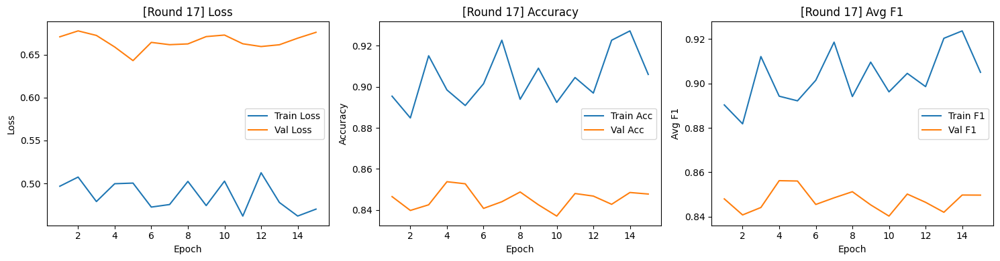


[AL Round 18/20] — Labeled samples: 670



Epoch 15/15
Train — Loss: 0.4666 | Acc: 0.9194 | Avg F1: 0.9213
Val   — Loss: 0.6796 | Acc: 0.8505 | Avg F1: 0.8517


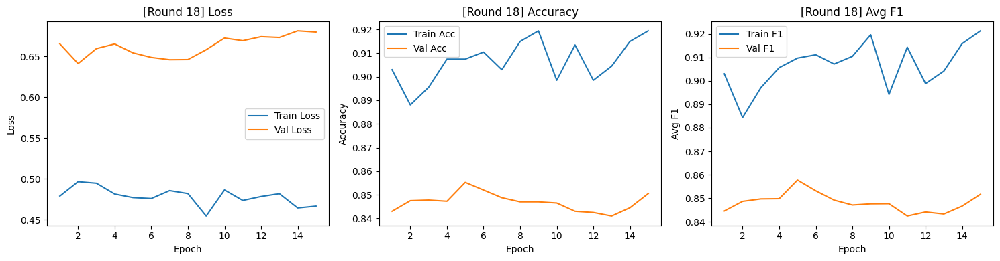


[AL Round 19/20] — Labeled samples: 680



Epoch 15/15
Train — Loss: 0.4612 | Acc: 0.9235 | Avg F1: 0.9214
Val   — Loss: 0.6542 | Acc: 0.8500 | Avg F1: 0.8510


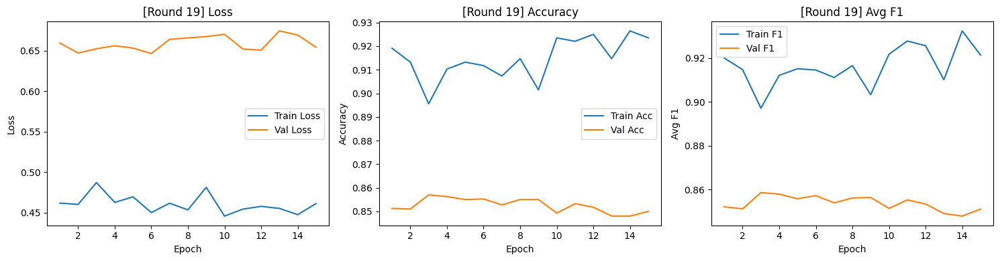


[AL Round 20/20] — Labeled samples: 690



Epoch 15/15
Train — Loss: 0.4388 | Acc: 0.9261 | Avg F1: 0.9237
Val   — Loss: 0.6732 | Acc: 0.8478 | Avg F1: 0.8473


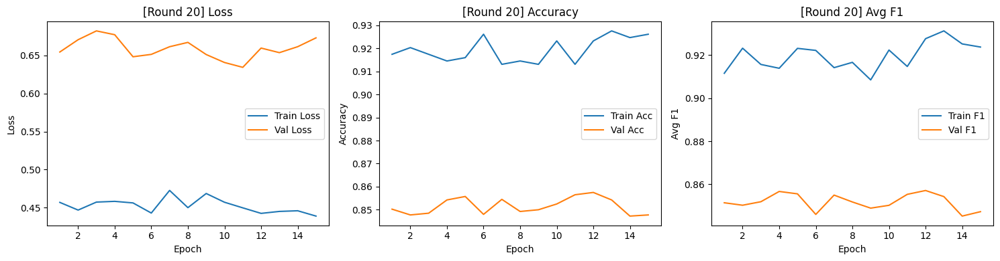

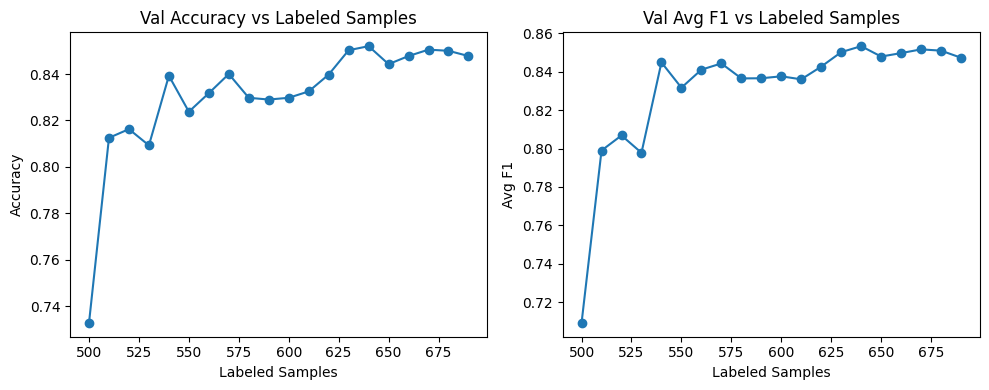


=== Running strategy: MARGIN ===

[AL Round 1/20] — Labeled samples: 500



Epoch 5/5
Train — Loss: 1.6205 | Acc: 0.5920 | Avg F1: 0.5770
Val   — Loss: 1.5820 | Acc: 0.7083 | Avg F1: 0.6867


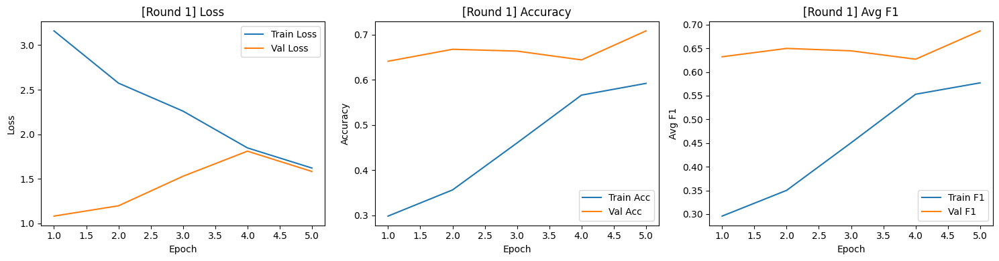


[AL Round 2/20] — Labeled samples: 510



Epoch 5/5
Train — Loss: 1.2338 | Acc: 0.6745 | Avg F1: 0.6512
Val   — Loss: 1.2915 | Acc: 0.7923 | Avg F1: 0.7724


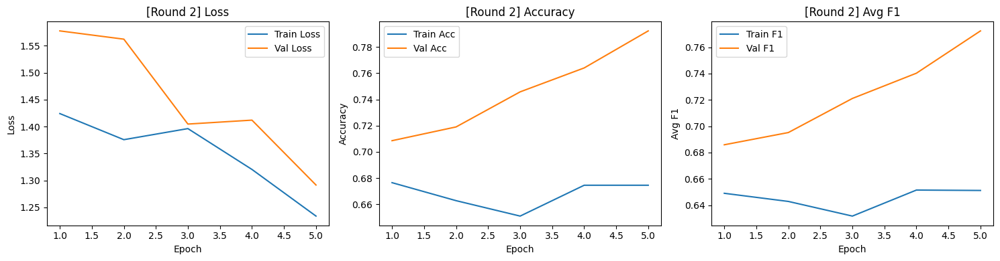


[AL Round 3/20] — Labeled samples: 520



Epoch 5/5
Train — Loss: 0.9991 | Acc: 0.7077 | Avg F1: 0.7021
Val   — Loss: 1.0691 | Acc: 0.8037 | Avg F1: 0.7886


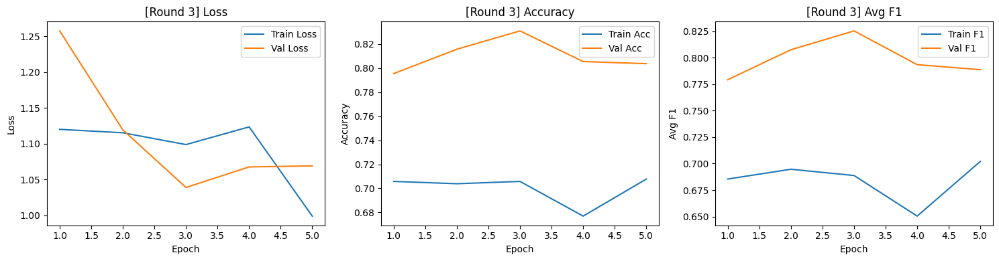


[AL Round 4/20] — Labeled samples: 530



Epoch 5/5
Train — Loss: 0.8346 | Acc: 0.7321 | Avg F1: 0.7189
Val   — Loss: 0.8874 | Acc: 0.8180 | Avg F1: 0.8183


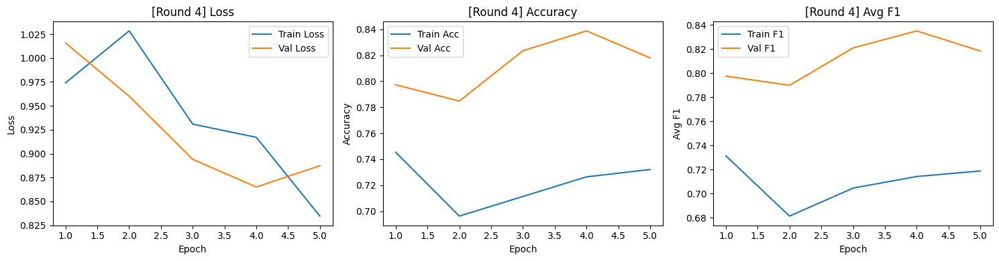


[AL Round 5/20] — Labeled samples: 540



Epoch 10/10
Train — Loss: 0.7714 | Acc: 0.7704 | Avg F1: 0.7616
Val   — Loss: 0.7915 | Acc: 0.8355 | Avg F1: 0.8407


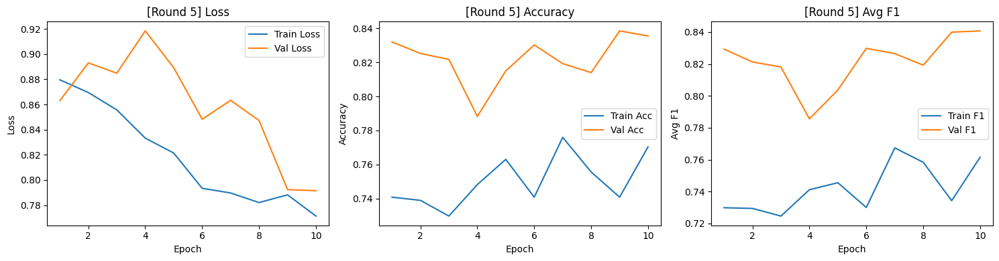


[AL Round 6/20] — Labeled samples: 550



Epoch 10/10
Train — Loss: 0.6433 | Acc: 0.7945 | Avg F1: 0.7993
Val   — Loss: 0.7284 | Acc: 0.8440 | Avg F1: 0.8487


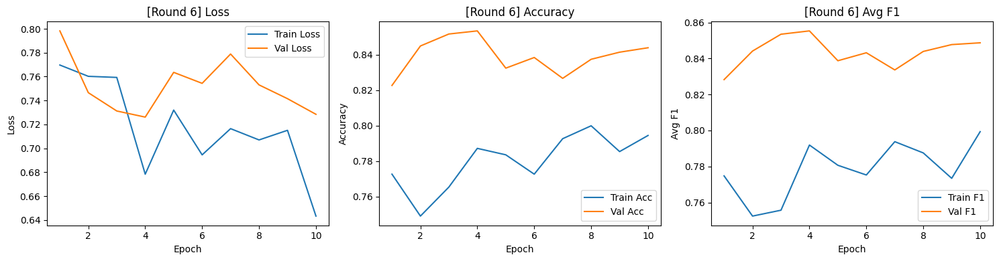


[AL Round 7/20] — Labeled samples: 560



Epoch 10/10
Train — Loss: 0.6451 | Acc: 0.8107 | Avg F1: 0.8105
Val   — Loss: 0.6781 | Acc: 0.8472 | Avg F1: 0.8511


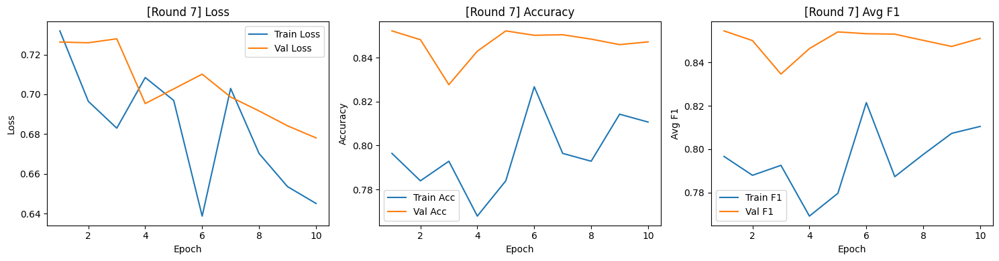


[AL Round 8/20] — Labeled samples: 570



Epoch 10/10
Train — Loss: 0.6236 | Acc: 0.8211 | Avg F1: 0.8197
Val   — Loss: 0.6789 | Acc: 0.8403 | Avg F1: 0.8460


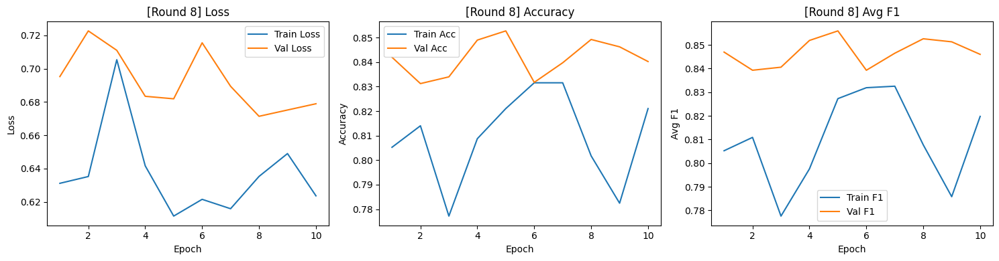


[AL Round 9/20] — Labeled samples: 580



Epoch 10/10
Train — Loss: 0.6237 | Acc: 0.8345 | Avg F1: 0.8403
Val   — Loss: 0.7513 | Acc: 0.8093 | Avg F1: 0.8181


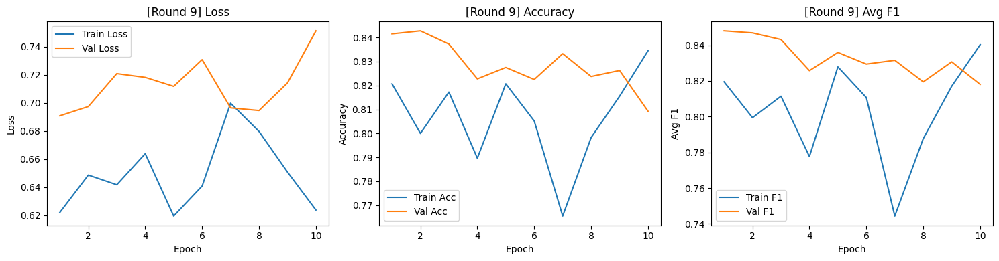


[AL Round 10/20] — Labeled samples: 590



Epoch 10/10
Train — Loss: 0.6322 | Acc: 0.8153 | Avg F1: 0.8093
Val   — Loss: 0.6721 | Acc: 0.8452 | Avg F1: 0.8483


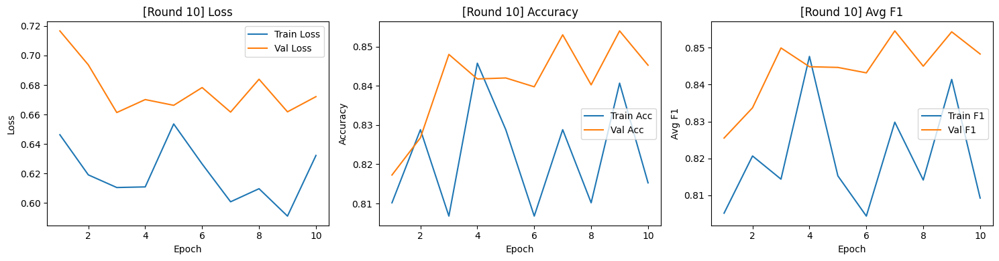


[AL Round 11/20] — Labeled samples: 600



Epoch 10/10
Train — Loss: 0.5819 | Acc: 0.8350 | Avg F1: 0.8341
Val   — Loss: 0.6704 | Acc: 0.8468 | Avg F1: 0.8490


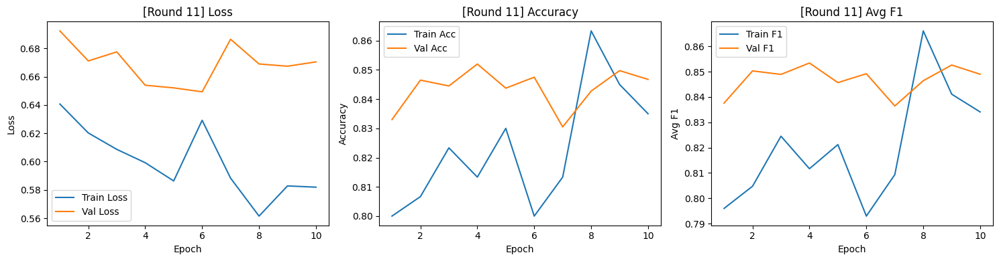


[AL Round 12/20] — Labeled samples: 610



Epoch 15/15
Train — Loss: 0.5511 | Acc: 0.8705 | Avg F1: 0.8705
Val   — Loss: 0.6733 | Acc: 0.8430 | Avg F1: 0.8456


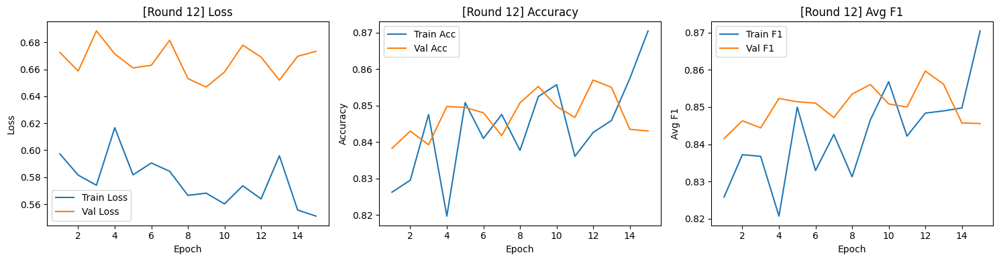


[AL Round 13/20] — Labeled samples: 620



Epoch 15/15
Train — Loss: 0.5479 | Acc: 0.8516 | Avg F1: 0.8521
Val   — Loss: 0.6706 | Acc: 0.8470 | Avg F1: 0.8498


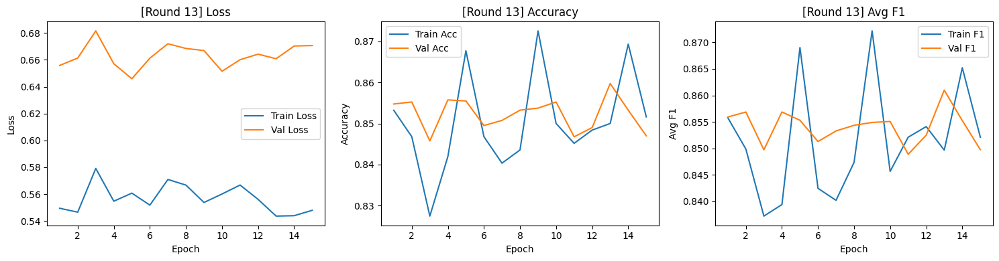


[AL Round 14/20] — Labeled samples: 630



Epoch 15/15
Train — Loss: 0.5534 | Acc: 0.8524 | Avg F1: 0.8504
Val   — Loss: 0.6542 | Acc: 0.8510 | Avg F1: 0.8525


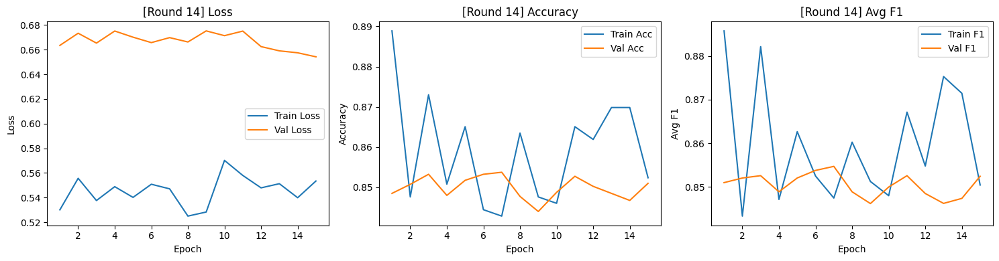


[AL Round 15/20] — Labeled samples: 640



Epoch 15/15
Train — Loss: 0.5167 | Acc: 0.8719 | Avg F1: 0.8742
Val   — Loss: 0.6649 | Acc: 0.8545 | Avg F1: 0.8514


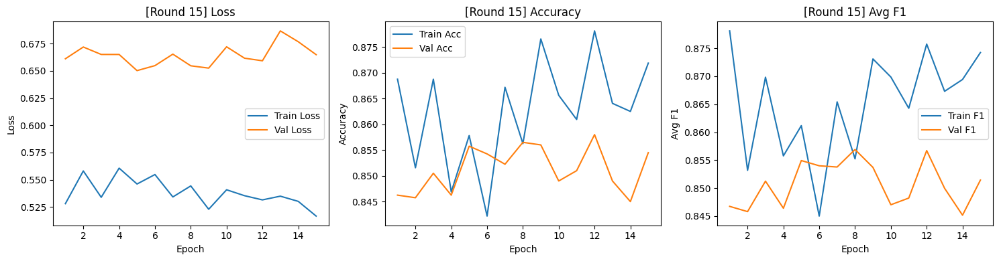


[AL Round 16/20] — Labeled samples: 650



Epoch 15/15
Train — Loss: 0.5267 | Acc: 0.8538 | Avg F1: 0.8529
Val   — Loss: 0.6615 | Acc: 0.8625 | Avg F1: 0.8612


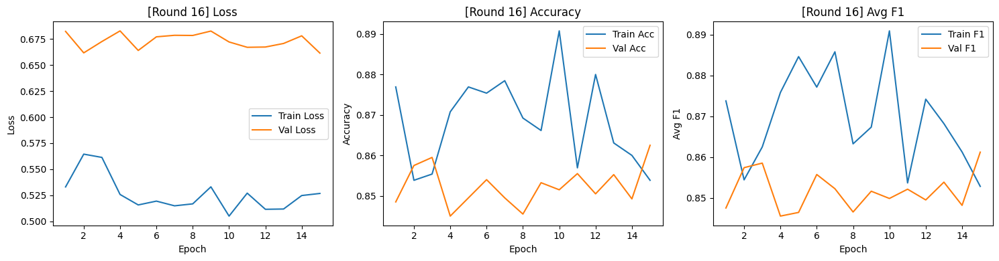


[AL Round 17/20] — Labeled samples: 660



Epoch 15/15
Train — Loss: 0.5082 | Acc: 0.8803 | Avg F1: 0.8787
Val   — Loss: 0.6479 | Acc: 0.8528 | Avg F1: 0.8504


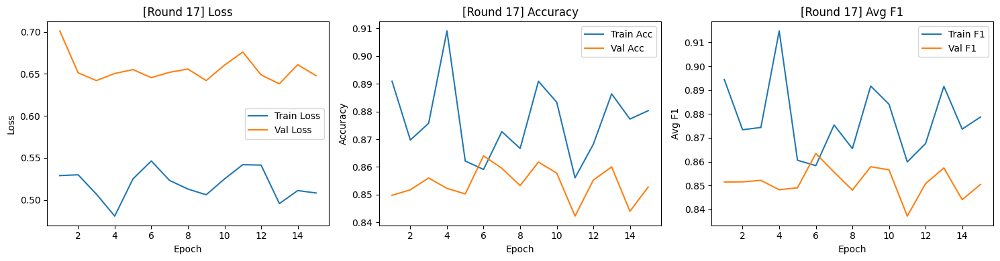


[AL Round 18/20] — Labeled samples: 670



Epoch 15/15
Train — Loss: 0.5142 | Acc: 0.8761 | Avg F1: 0.8766
Val   — Loss: 0.6411 | Acc: 0.8585 | Avg F1: 0.8573


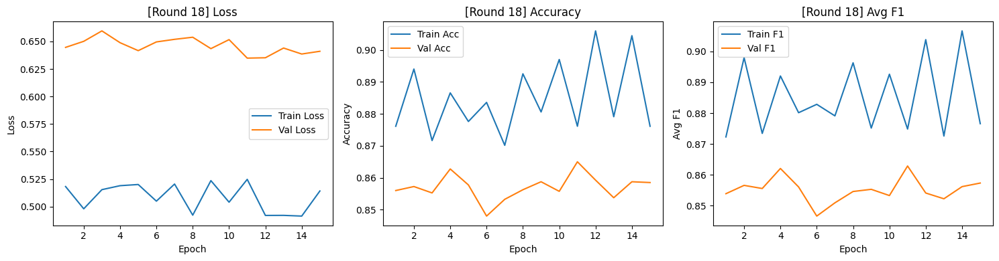


[AL Round 19/20] — Labeled samples: 680



Epoch 15/15
Train — Loss: 0.4899 | Acc: 0.8926 | Avg F1: 0.8973
Val   — Loss: 0.6516 | Acc: 0.8622 | Avg F1: 0.8587


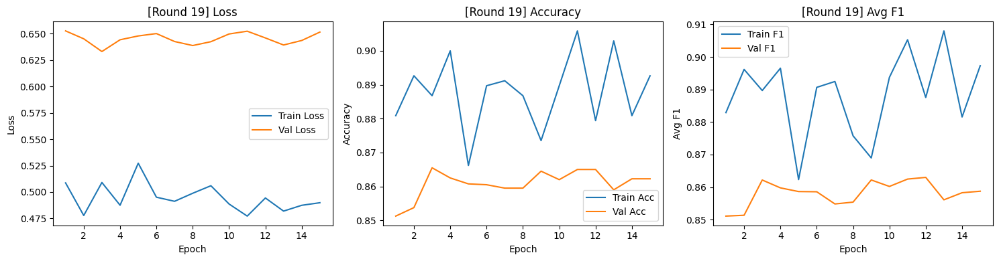


[AL Round 20/20] — Labeled samples: 690



Epoch 15/15
Train — Loss: 0.4796 | Acc: 0.8986 | Avg F1: 0.8985
Val   — Loss: 0.6556 | Acc: 0.8535 | Avg F1: 0.8461


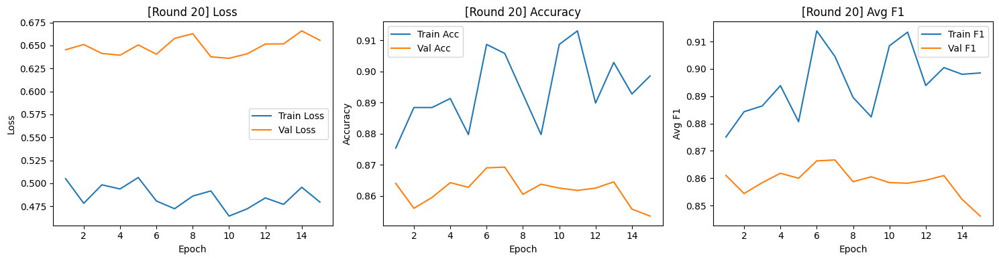

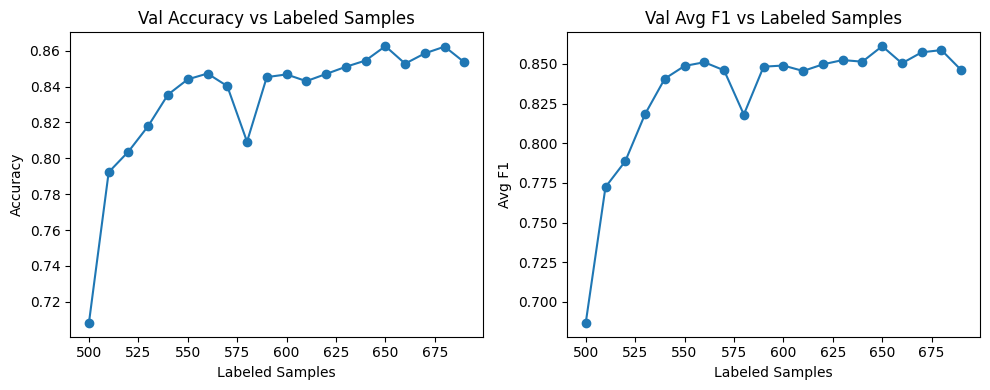


=== Running strategy: LEAST_CONFIDENT ===

[AL Round 1/20] — Labeled samples: 500



Epoch 5/5
Train — Loss: 1.7238 | Acc: 0.6040 | Avg F1: 0.5870
Val   — Loss: 1.7217 | Acc: 0.7027 | Avg F1: 0.6813


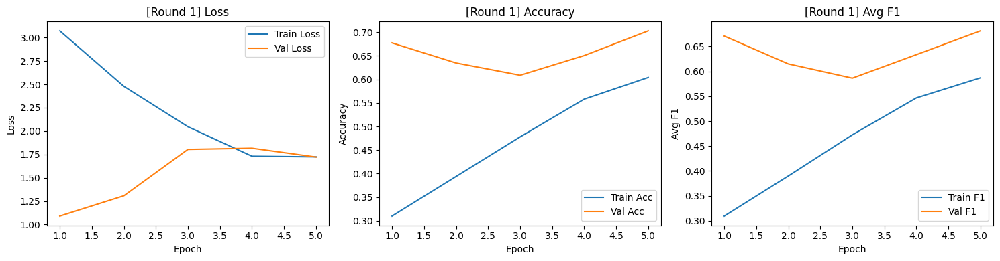


[AL Round 2/20] — Labeled samples: 510



Epoch 5/5
Train — Loss: 1.2986 | Acc: 0.6686 | Avg F1: 0.6484
Val   — Loss: 1.2388 | Acc: 0.8030 | Avg F1: 0.8098


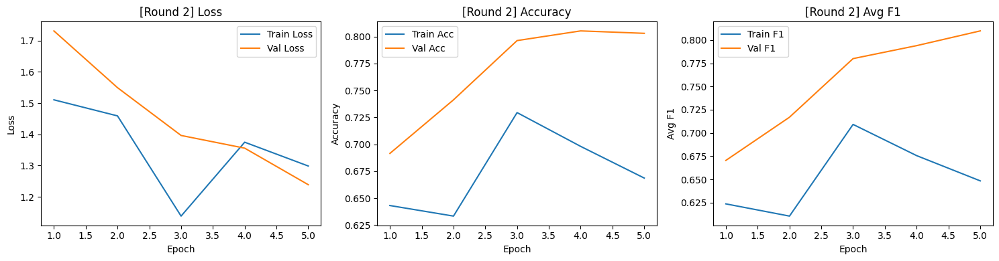


[AL Round 3/20] — Labeled samples: 520



Epoch 5/5
Train — Loss: 0.9268 | Acc: 0.7327 | Avg F1: 0.7224
Val   — Loss: 0.9401 | Acc: 0.8297 | Avg F1: 0.8183


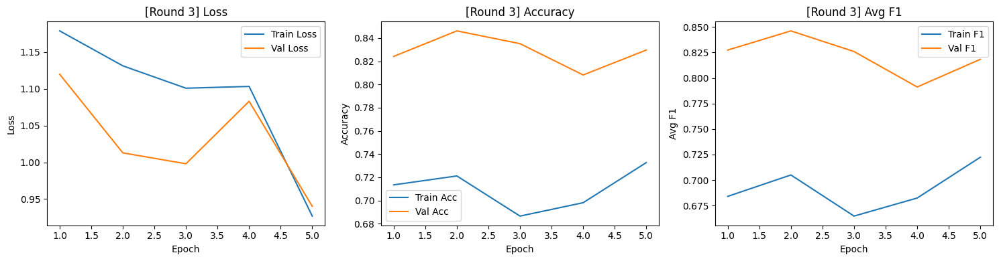


[AL Round 4/20] — Labeled samples: 530



Epoch 5/5
Train — Loss: 0.8997 | Acc: 0.7226 | Avg F1: 0.7056
Val   — Loss: 0.9397 | Acc: 0.8277 | Avg F1: 0.8252


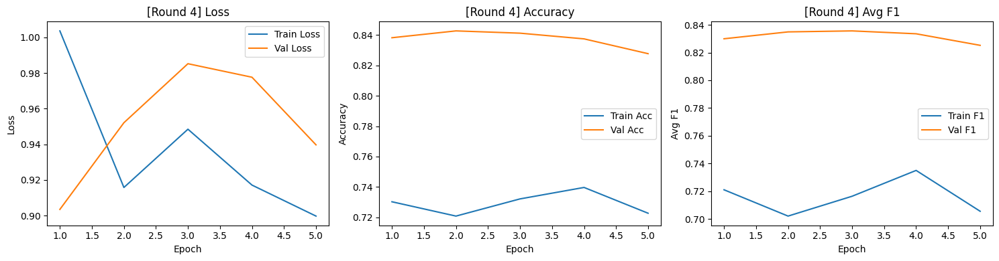


[AL Round 5/20] — Labeled samples: 540



Epoch 10/10
Train — Loss: 0.7801 | Acc: 0.7759 | Avg F1: 0.7667
Val   — Loss: 0.8235 | Acc: 0.8347 | Avg F1: 0.8416


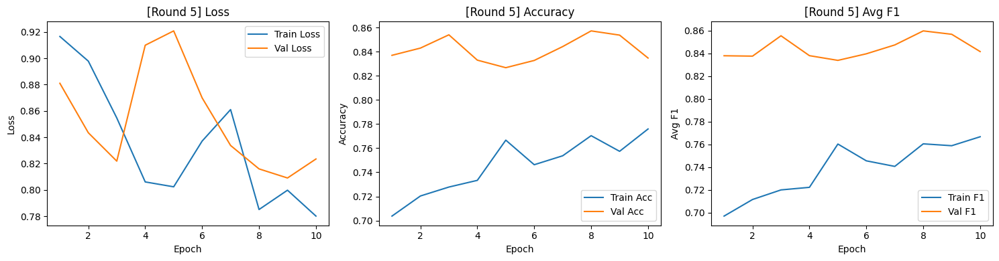


[AL Round 6/20] — Labeled samples: 550



Epoch 10/10
Train — Loss: 0.6973 | Acc: 0.7655 | Avg F1: 0.7682
Val   — Loss: 0.8227 | Acc: 0.8173 | Avg F1: 0.8215


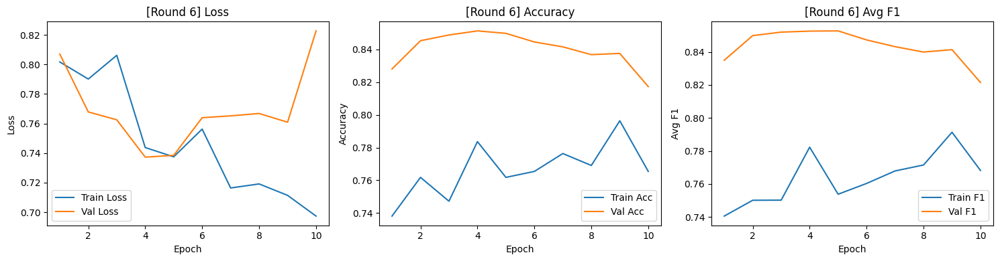


[AL Round 7/20] — Labeled samples: 560



Epoch 10/10
Train — Loss: 0.6751 | Acc: 0.7893 | Avg F1: 0.7818
Val   — Loss: 0.8009 | Acc: 0.8060 | Avg F1: 0.8155


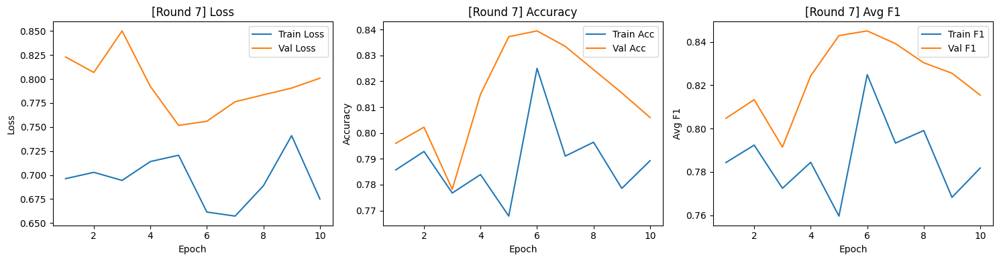


[AL Round 8/20] — Labeled samples: 570



Epoch 10/10
Train — Loss: 0.6736 | Acc: 0.8035 | Avg F1: 0.8002
Val   — Loss: 0.7597 | Acc: 0.8115 | Avg F1: 0.8221


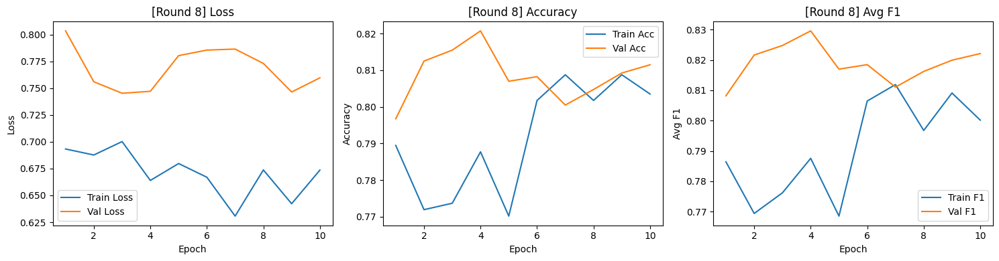


[AL Round 9/20] — Labeled samples: 580



Epoch 10/10
Train — Loss: 0.6118 | Acc: 0.8121 | Avg F1: 0.8047
Val   — Loss: 0.8224 | Acc: 0.7668 | Avg F1: 0.7793


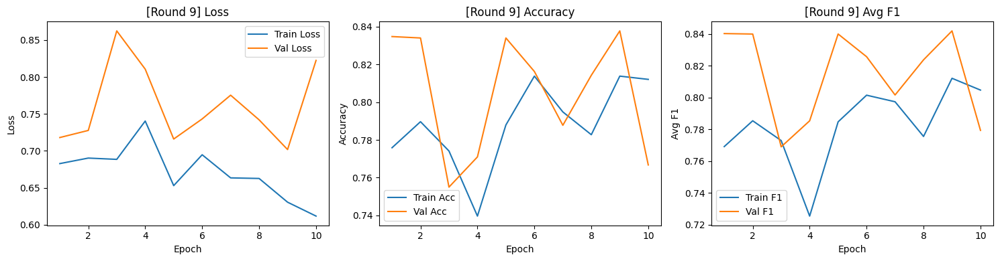


[AL Round 10/20] — Labeled samples: 590



Epoch 10/10
Train — Loss: 0.6381 | Acc: 0.7932 | Avg F1: 0.7904
Val   — Loss: 0.7275 | Acc: 0.8203 | Avg F1: 0.8304


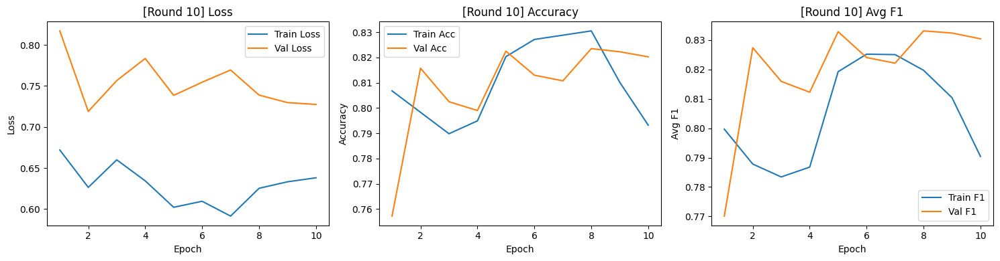


[AL Round 11/20] — Labeled samples: 600



Epoch 10/10
Train — Loss: 0.5960 | Acc: 0.8333 | Avg F1: 0.8221
Val   — Loss: 0.7408 | Acc: 0.8157 | Avg F1: 0.8256


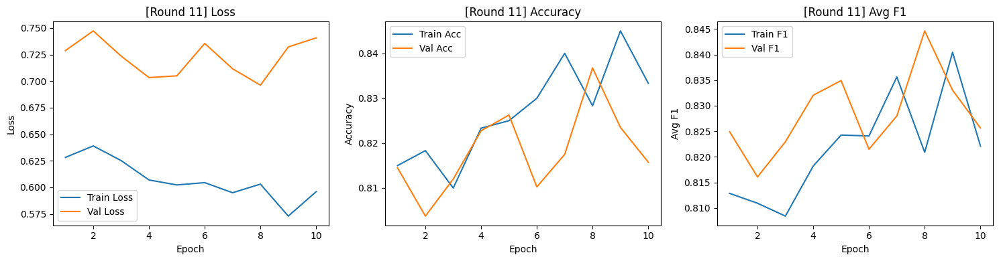


[AL Round 12/20] — Labeled samples: 610



Epoch 15/15
Train — Loss: 0.6141 | Acc: 0.8262 | Avg F1: 0.8205
Val   — Loss: 0.6916 | Acc: 0.8377 | Avg F1: 0.8441


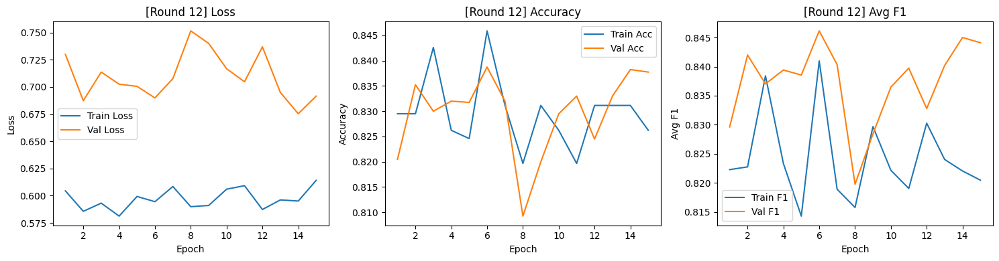


[AL Round 13/20] — Labeled samples: 620



Epoch 15/15
Train — Loss: 0.5503 | Acc: 0.8435 | Avg F1: 0.8425
Val   — Loss: 0.7173 | Acc: 0.8357 | Avg F1: 0.8411


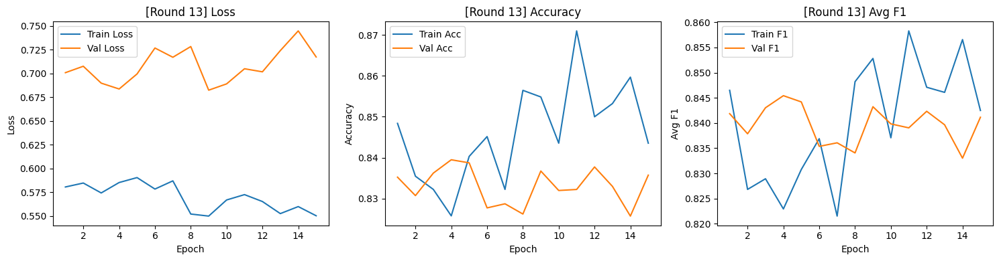


[AL Round 14/20] — Labeled samples: 630



Epoch 15/15
Train — Loss: 0.5529 | Acc: 0.8746 | Avg F1: 0.8618
Val   — Loss: 0.7262 | Acc: 0.8333 | Avg F1: 0.8402


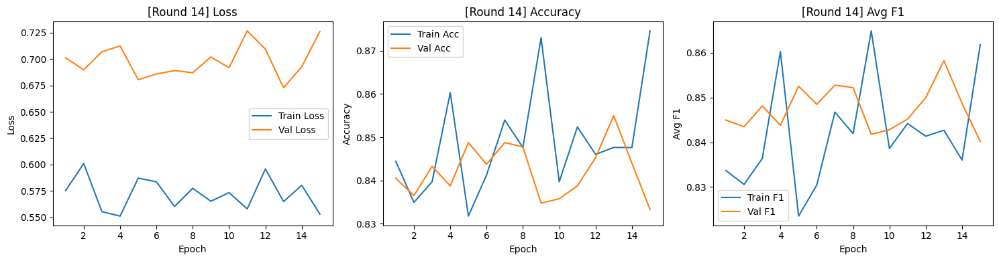


[AL Round 15/20] — Labeled samples: 640



Epoch 15/15
Train — Loss: 0.5699 | Acc: 0.8547 | Avg F1: 0.8424
Val   — Loss: 0.6759 | Acc: 0.8542 | Avg F1: 0.8573


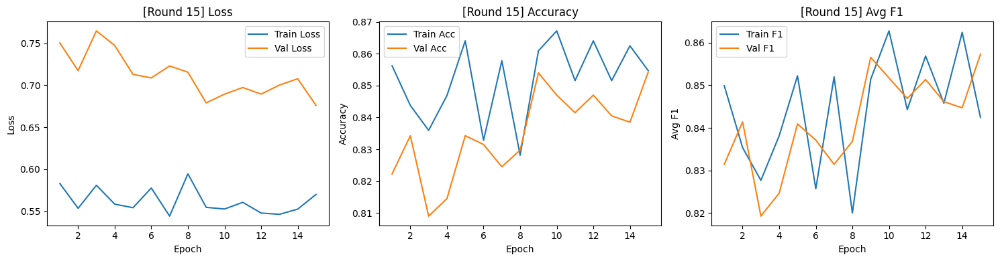


[AL Round 16/20] — Labeled samples: 650



Epoch 15/15
Train — Loss: 0.5277 | Acc: 0.8708 | Avg F1: 0.8691
Val   — Loss: 0.7389 | Acc: 0.8413 | Avg F1: 0.8454


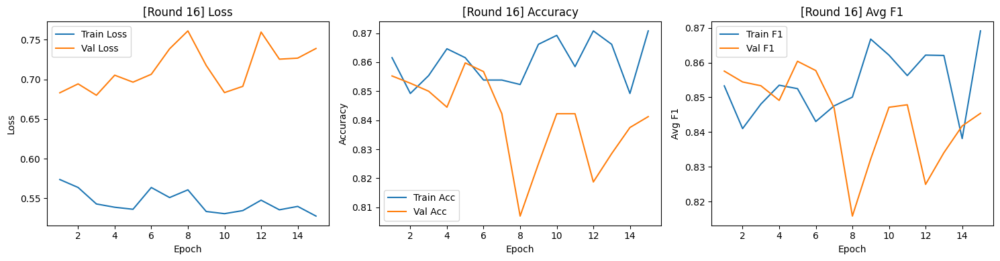


[AL Round 17/20] — Labeled samples: 660



Epoch 15/15
Train — Loss: 0.5357 | Acc: 0.8500 | Avg F1: 0.8468
Val   — Loss: 0.7032 | Acc: 0.8550 | Avg F1: 0.8580


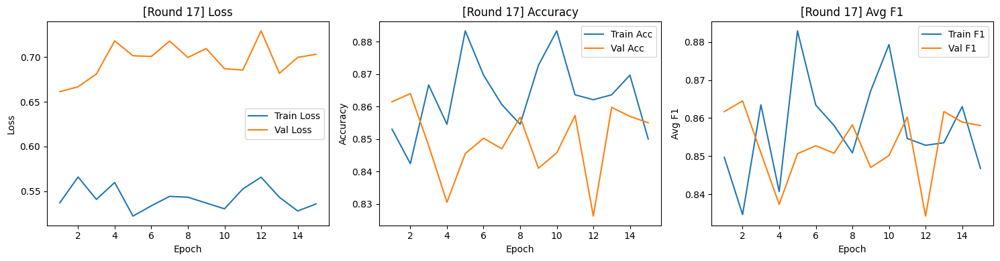


[AL Round 18/20] — Labeled samples: 670



Epoch 15/15
Train — Loss: 0.5367 | Acc: 0.8612 | Avg F1: 0.8564
Val   — Loss: 0.7047 | Acc: 0.8578 | Avg F1: 0.8599


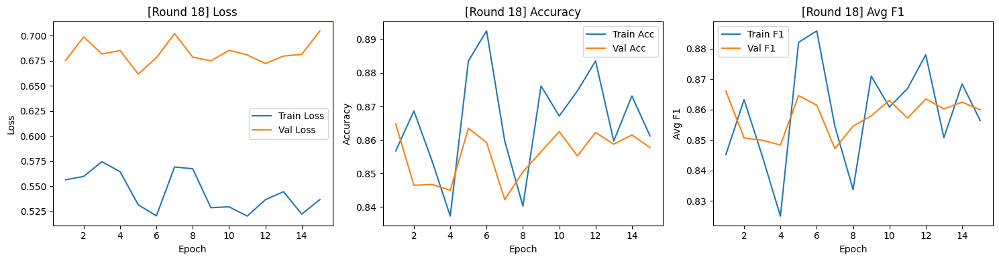


[AL Round 19/20] — Labeled samples: 680



Epoch 15/15
Train — Loss: 0.5473 | Acc: 0.8559 | Avg F1: 0.8497
Val   — Loss: 0.6769 | Acc: 0.8580 | Avg F1: 0.8584


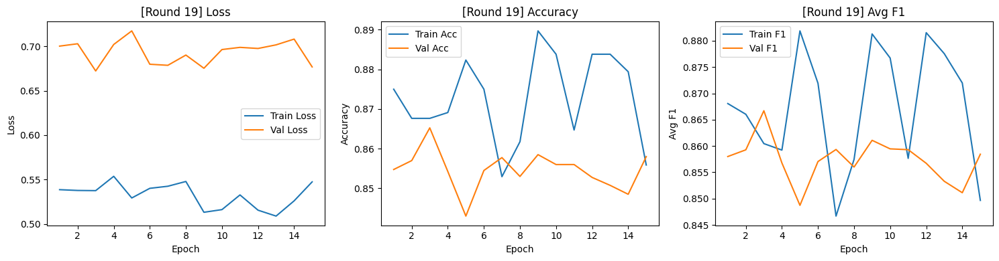


[AL Round 20/20] — Labeled samples: 690



Epoch 15/15
Train — Loss: 0.5140 | Acc: 0.8884 | Avg F1: 0.8814
Val   — Loss: 0.6861 | Acc: 0.8542 | Avg F1: 0.8557


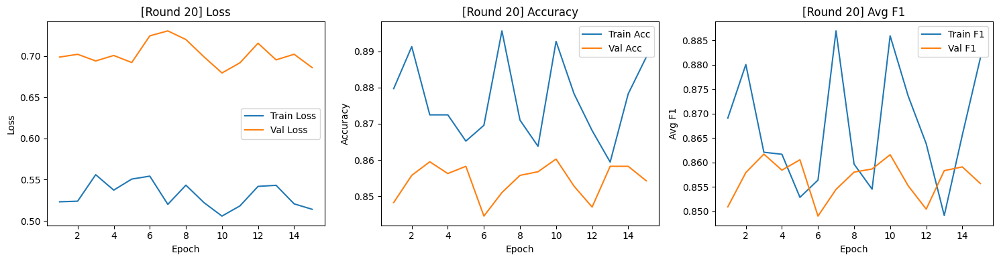

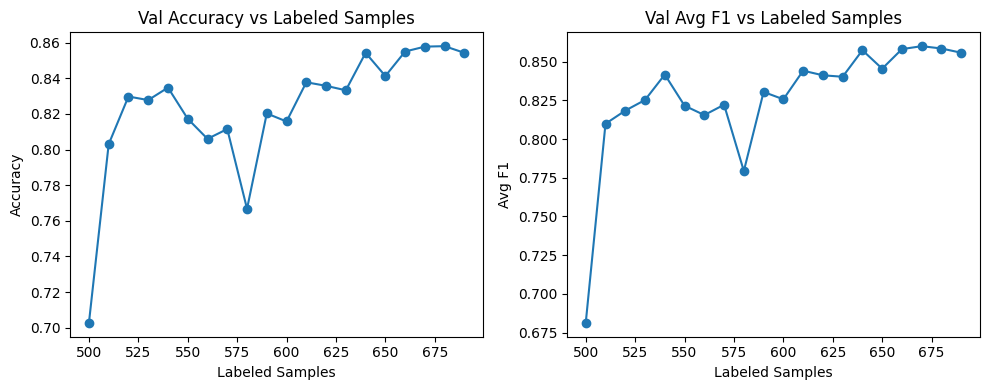


=== Running strategy: DENSITY ===

[AL Round 1/20] — Labeled samples: 500



Epoch 5/5
Train — Loss: 1.5282 | Acc: 0.6320 | Avg F1: 0.6122
Val   — Loss: 1.7954 | Acc: 0.6915 | Avg F1: 0.6708


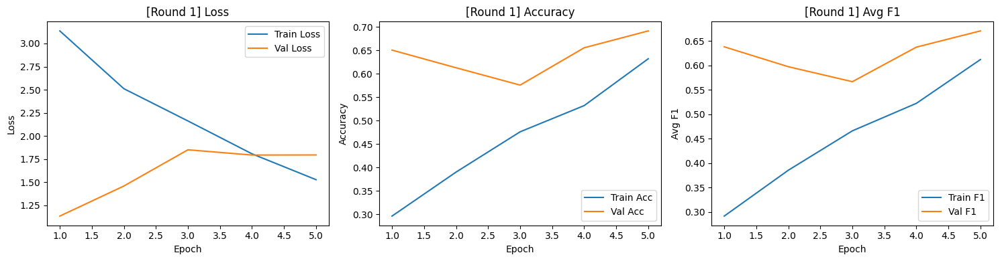


[AL Round 2/20] — Labeled samples: 510



Epoch 5/5
Train — Loss: 1.1722 | Acc: 0.7176 | Avg F1: 0.6989
Val   — Loss: 1.5784 | Acc: 0.7080 | Avg F1: 0.6861


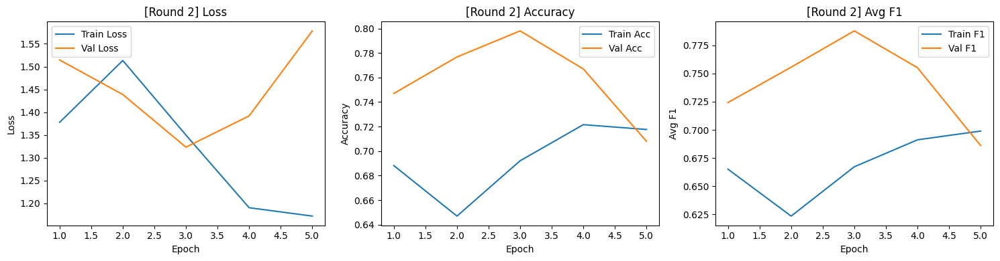


[AL Round 3/20] — Labeled samples: 520



Epoch 5/5
Train — Loss: 1.0495 | Acc: 0.7481 | Avg F1: 0.7395
Val   — Loss: 1.0607 | Acc: 0.8097 | Avg F1: 0.8158


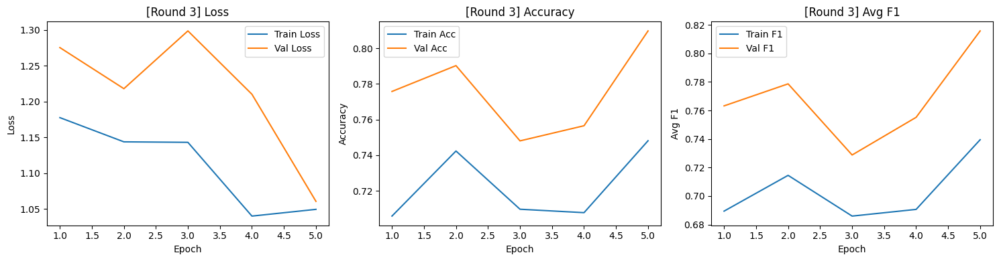


[AL Round 4/20] — Labeled samples: 530



Epoch 5/5
Train — Loss: 0.8628 | Acc: 0.7792 | Avg F1: 0.7664
Val   — Loss: 1.0310 | Acc: 0.7812 | Avg F1: 0.7886


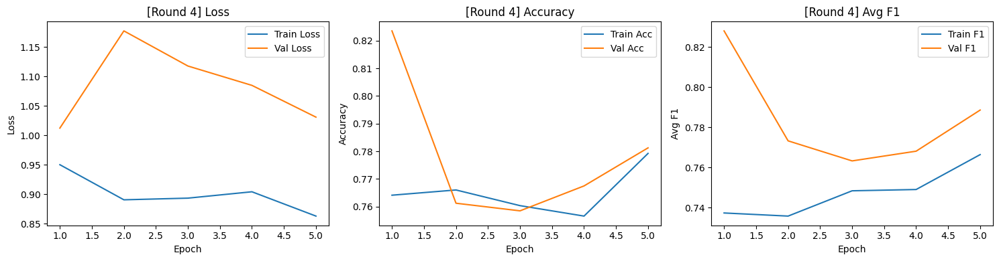


[AL Round 5/20] — Labeled samples: 540



Epoch 10/10
Train — Loss: 0.8012 | Acc: 0.7593 | Avg F1: 0.7414
Val   — Loss: 0.8387 | Acc: 0.8197 | Avg F1: 0.8149


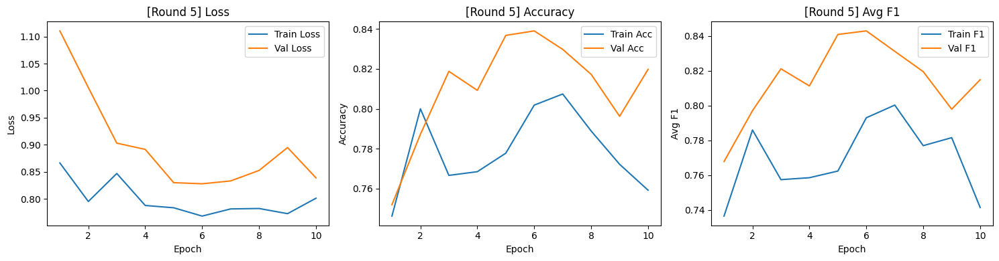


[AL Round 6/20] — Labeled samples: 550



Epoch 10/10
Train — Loss: 0.6900 | Acc: 0.8018 | Avg F1: 0.7954
Val   — Loss: 0.7803 | Acc: 0.8013 | Avg F1: 0.8058


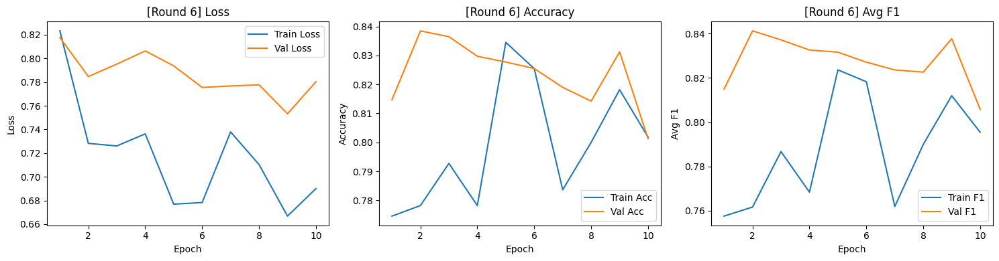


[AL Round 7/20] — Labeled samples: 560



Epoch 10/10
Train — Loss: 0.5803 | Acc: 0.8464 | Avg F1: 0.8466
Val   — Loss: 0.7253 | Acc: 0.8230 | Avg F1: 0.8338


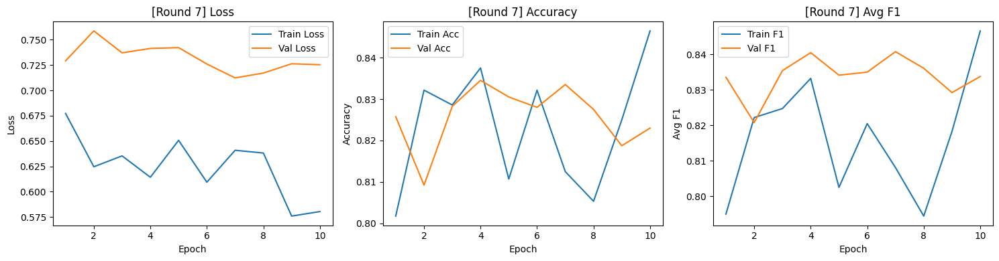


[AL Round 8/20] — Labeled samples: 570



Epoch 10/10
Train — Loss: 0.5778 | Acc: 0.8737 | Avg F1: 0.8720
Val   — Loss: 0.7143 | Acc: 0.8183 | Avg F1: 0.8284


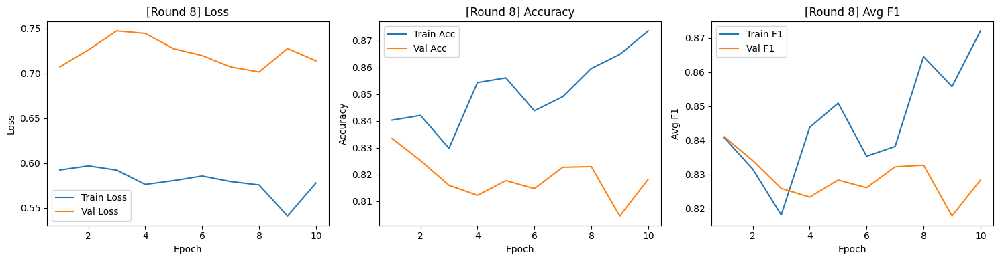


[AL Round 9/20] — Labeled samples: 580



Epoch 10/10
Train — Loss: 0.5497 | Acc: 0.8603 | Avg F1: 0.8556
Val   — Loss: 0.7139 | Acc: 0.8245 | Avg F1: 0.8332


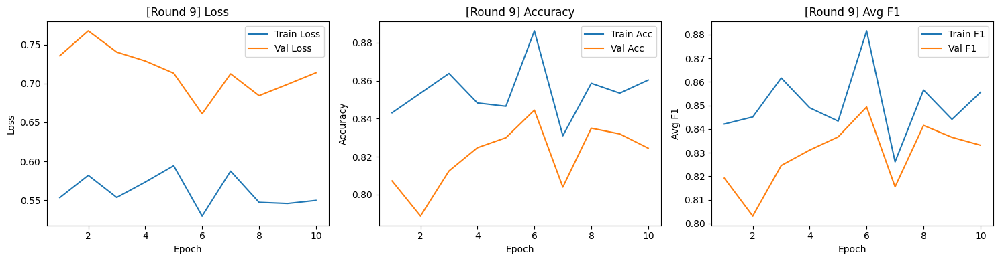


[AL Round 10/20] — Labeled samples: 590



Epoch 10/10
Train — Loss: 0.5568 | Acc: 0.8424 | Avg F1: 0.8272
Val   — Loss: 0.7348 | Acc: 0.8145 | Avg F1: 0.8261


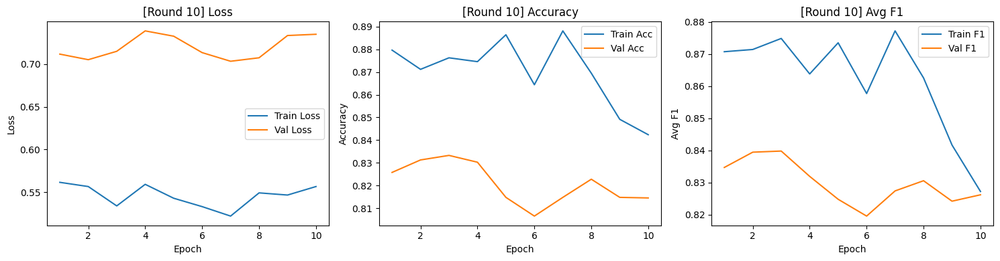


[AL Round 11/20] — Labeled samples: 600



Epoch 10/10
Train — Loss: 0.4905 | Acc: 0.9050 | Avg F1: 0.8983
Val   — Loss: 0.7382 | Acc: 0.8125 | Avg F1: 0.8207


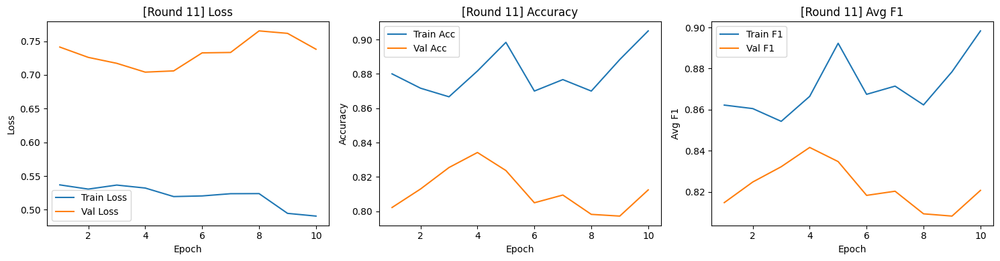


[AL Round 12/20] — Labeled samples: 610



Epoch 15/15
Train — Loss: 0.4804 | Acc: 0.9000 | Avg F1: 0.8947
Val   — Loss: 0.7415 | Acc: 0.8153 | Avg F1: 0.8249


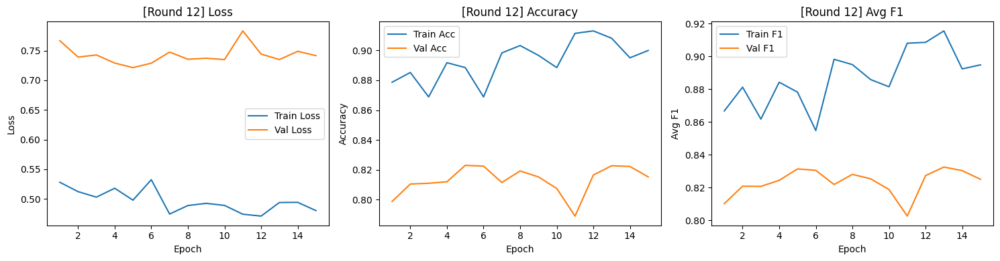


[AL Round 13/20] — Labeled samples: 620



Epoch 15/15
Train — Loss: 0.4645 | Acc: 0.9113 | Avg F1: 0.9023
Val   — Loss: 0.7318 | Acc: 0.8195 | Avg F1: 0.8277


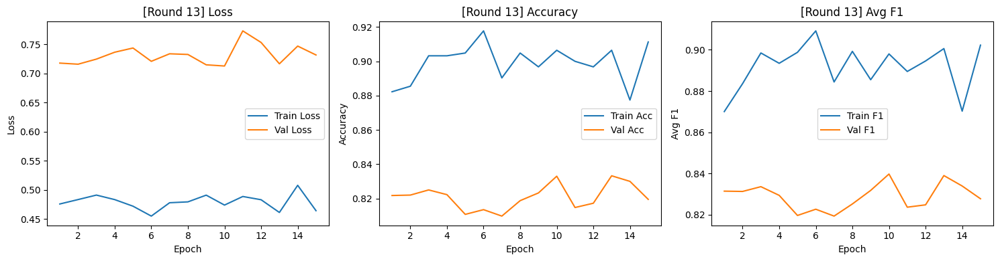


[AL Round 14/20] — Labeled samples: 630



Epoch 15/15
Train — Loss: 0.4591 | Acc: 0.9111 | Avg F1: 0.9071
Val   — Loss: 0.7309 | Acc: 0.8325 | Avg F1: 0.8375


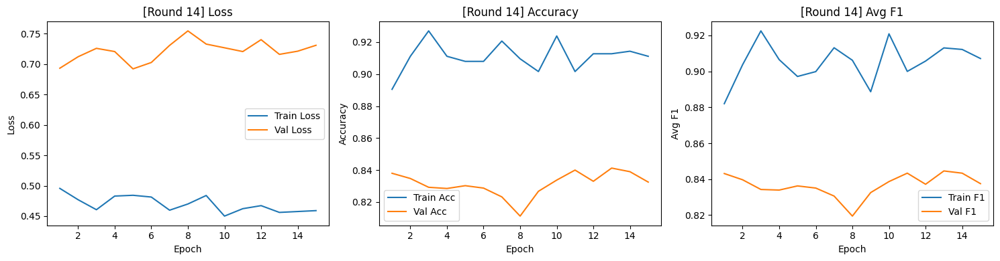


[AL Round 15/20] — Labeled samples: 640



Epoch 15/15
Train — Loss: 0.4360 | Acc: 0.9328 | Avg F1: 0.9282
Val   — Loss: 0.7132 | Acc: 0.8343 | Avg F1: 0.8384


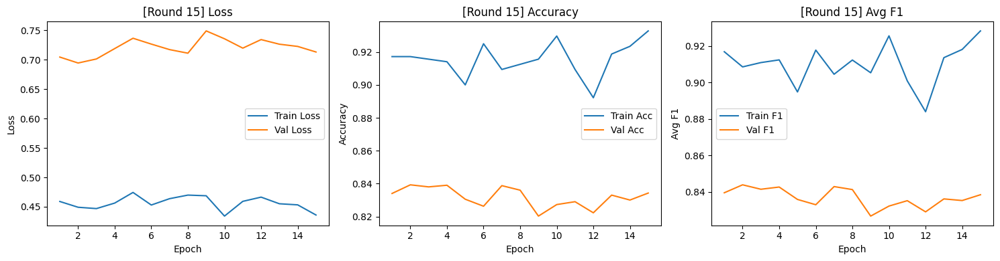


[AL Round 16/20] — Labeled samples: 650



Epoch 15/15
Train — Loss: 0.4431 | Acc: 0.9277 | Avg F1: 0.9264
Val   — Loss: 0.7086 | Acc: 0.8435 | Avg F1: 0.8444


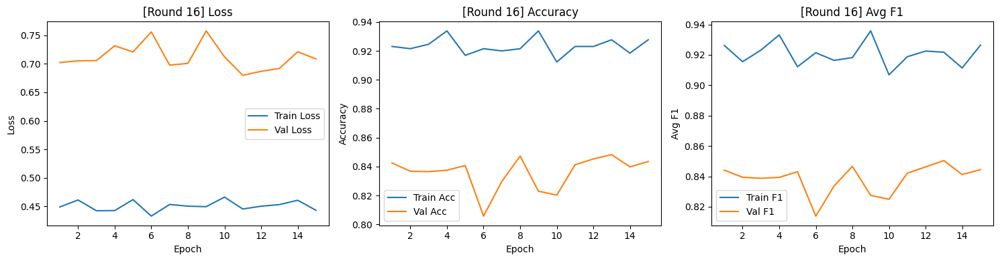


[AL Round 17/20] — Labeled samples: 660



Epoch 15/15
Train — Loss: 0.4334 | Acc: 0.9379 | Avg F1: 0.9324
Val   — Loss: 0.6958 | Acc: 0.8465 | Avg F1: 0.8476


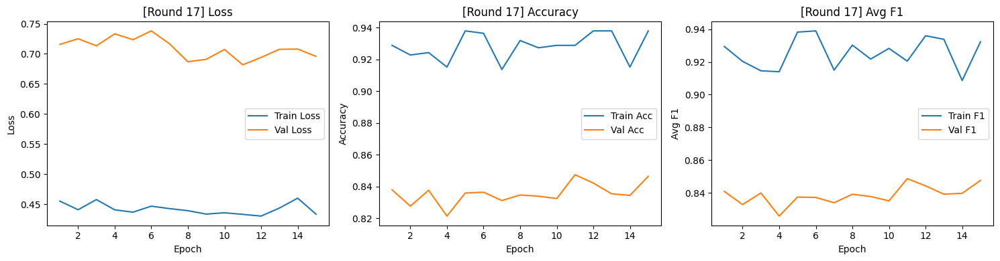


[AL Round 18/20] — Labeled samples: 670



Epoch 15/15
Train — Loss: 0.4176 | Acc: 0.9507 | Avg F1: 0.9480
Val   — Loss: 0.7054 | Acc: 0.8317 | Avg F1: 0.8354


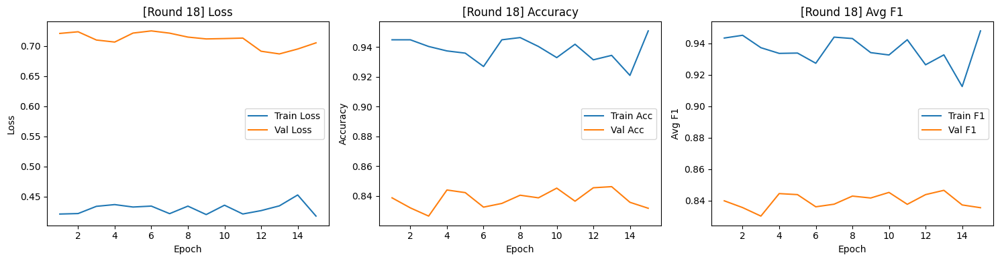


[AL Round 19/20] — Labeled samples: 680



Epoch 15/15
Train — Loss: 0.4197 | Acc: 0.9426 | Avg F1: 0.9425
Val   — Loss: 0.7072 | Acc: 0.8390 | Avg F1: 0.8396


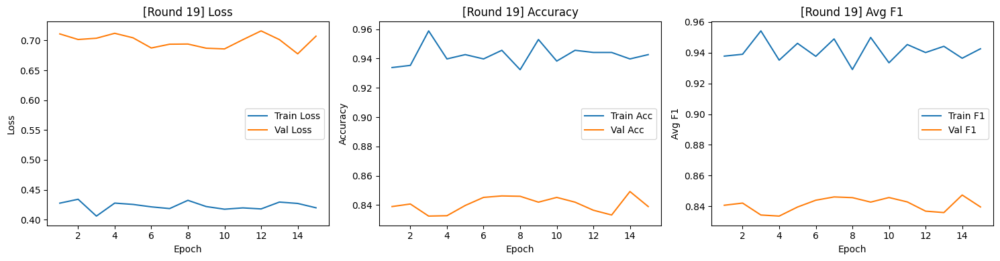


[AL Round 20/20] — Labeled samples: 690



Epoch 15/15
Train — Loss: 0.4234 | Acc: 0.9362 | Avg F1: 0.9339
Val   — Loss: 0.6998 | Acc: 0.8397 | Avg F1: 0.8404


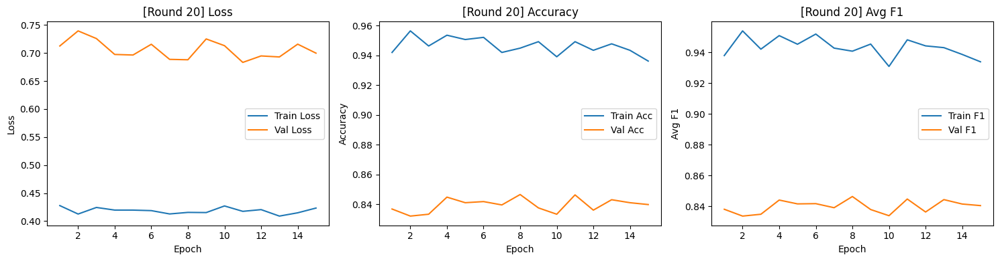

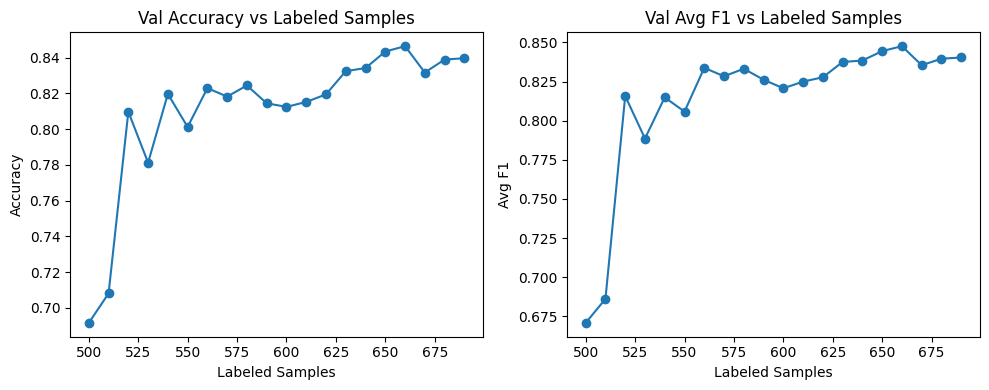

In [13]:

strategies = [ "random",'margin','least_confident','density']
all_histories = {}

data = [(100,20,10), (300,20,10),(500,20,10) ]

for initial_labeled, iters,query_size in data:
    initial_labeled= 1-initial_labeled/len(X_pool)
    X_labeled, X_unlabeled, y_labeled, y_unlabeled = train_test_split(X_pool, y_pool, test_size=initial_labeled, stratify=y_pool, random_state=42)
    print(f"X_labeled shape: {X_labeled.shape}")
    print(f"y_labeled shape: {y_labeled.shape}")
    print(f"X_unlabeled shape: {X_unlabeled.shape}")
    print(f"y_unlabeled shape: {y_unlabeled.shape}")
    
    
    labeled_dataset = Dataset(X_labeled, y_labeled)
    unlabeled_dataset = Dataset(X_unlabeled, y_unlabeled)
    val_dataset = Dataset(X_val, y_val)
    
    for strat in strategies:
        print(f"\n=== Running strategy: {strat.upper()} ===")
        
        # Reset datasets to initial versions (deepcopy to avoid mutations)
        labeled = copy.deepcopy(labeled_dataset)
        unlabeled = copy.deepcopy(unlabeled_dataset)
    
        model.load_state_dict(copy.deepcopy(initial_state_dict))
        
        hist = active_learning_loop(
            model,
            labeled_dataset=labeled,
            unlabeled_dataset=unlabeled,
            val_dataset=val_dataset,
            strategy=strat,
            device=device,
            iters=iters,
            query_size=query_size,
            final_epochs=15
        )
        
        all_histories[(strat, initial_labeled, iters, query_size)] = hist


with open("/kaggle/working/history_entropy.pkl", "wb") as f:
    pickle.dump(all_histories, f)

# Plotting final result

In [14]:
def best_cumsum(available):
    best = (0, 0, 0, 0)  # (cumsum, init, step, n)
    for init in range(1, available + 1):
        for step in range(1, available + 1):
            # max possible n for this init and step
            max_n = (available - init) // step
            for n in range(1, max_n + 1):
                total = init + n * step
                if total <= available:
                    cumsum = n * init + step * n * (n - 1) // 2
                    if cumsum > best[0]:
                        best = (cumsum, init, step, n)
    return best

available = 100
cumsum, init, step, n = best_cumsum(available)
print(f"Max cumsum = {cumsum} with init={init}, step={step}, n={n}")


example = [ (30,20,1), (60,40,1),(120,40,2),(120,80,1),(180,40,3),(300,40,5) ]

for init,iterations,query in example:
    print(f'Init: {init}, Iters: {iterations}, Query: {query}, Total: {total_labeled_samples(init, iterations, query)}, Effective: {eff_total_labeled_samples(init, iterations, query)}')

Max cumsum = 4950 with init=1, step=1, n=99


NameError: name 'total_labeled_samples' is not defined

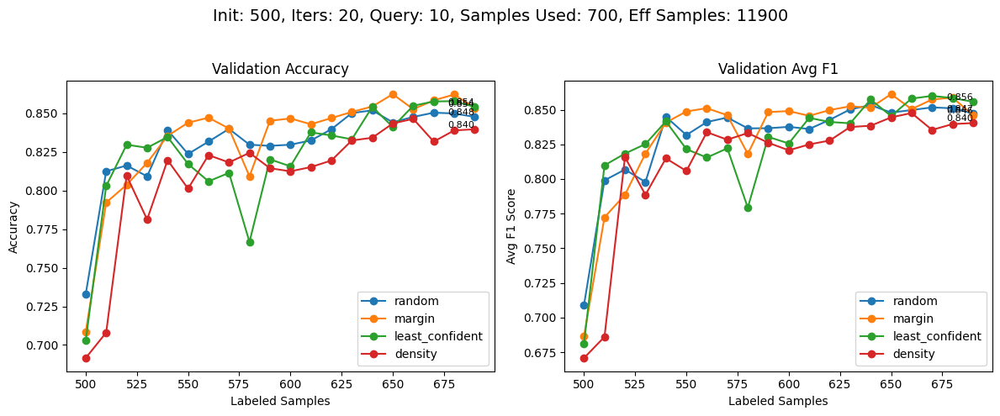

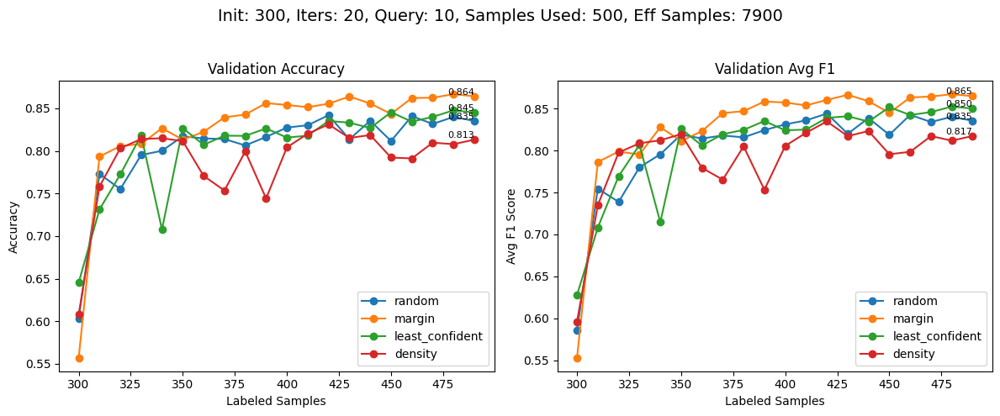

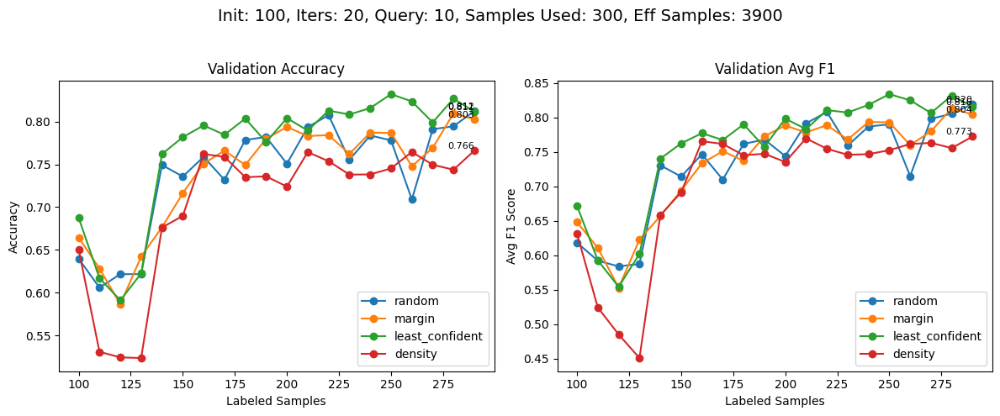

In [16]:
def eff_total_labeled_samples(init, iterations, query):
    return round(iterations * init + query * (iterations * (iterations - 1)) // 2)

def total_labeled_samples(init, iterations, query):
    return init+query*iterations

unique_configs = sorted(set((init_size, iters, query) for (_, init_size, iters, query) in all_histories.keys()))

for init_size, iters, query in unique_configs:
    plt.figure(figsize=(12, 5))
    plt.suptitle(f"Init: {round(len(X_pool)*(1-init_size))}, Iters: {iters}, Query: {query}, Samples Used: {total_labeled_samples(round(len(X_pool)*(1-init_size)), iters, query)}, Eff Samples: {eff_total_labeled_samples(round(len(X_pool)*(1-init_size)), iters, query)}", fontsize=14)
    # Accuracy
    plt.subplot(1, 2, 1)
    for (strat, size, iters_, query_), hist in all_histories.items():
        if (size, iters_, query_) == (init_size, iters, query):
            plt.plot(hist["samples"], hist["round_val_acc"], label=strat, marker='o')
            # Show final accuracy value
            x_final = hist["samples"][-1]
            y_final = hist["round_val_acc"][-1]
            plt.text(x_final, y_final, f"{y_final:.3f}", fontsize=8, ha='right', va='bottom')
    plt.title("Validation Accuracy")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Accuracy")
    plt.legend()

    # F1 Score
    plt.subplot(1, 2, 2)
    for (strat, size, iters_, query_), hist in all_histories.items():
        if (size, iters_, query_) == (init_size, iters, query):
            plt.plot(hist["samples"], hist["round_val_avg_f1"], label=strat, marker='o')
            # Show final F1 value
            x_final = hist["samples"][-1]
            y_final = hist["round_val_avg_f1"][-1]
            plt.text(x_final, y_final, f"{y_final:.3f}", fontsize=8, ha='right', va='bottom')
    plt.title("Validation Avg F1")
    plt.xlabel("Labeled Samples")
    plt.ylabel("Avg F1 Score")
    plt.legend()

    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


In [17]:
import csv
import os

# Create export directory
export_dir = "active_learning_results"
os.makedirs(export_dir, exist_ok=True)

# Combined CSV file
all_csv_path = os.path.join(export_dir, "all_results.csv")
with open(all_csv_path, mode="w", newline='') as all_csv_file:
    writer_all = csv.writer(all_csv_file)
    writer_all.writerow(["strategy", "init", "iterations", "query", "sample_size", "accuracy", "f1_score"])
    print("strategy,init,iterations,query,sample_size,accuracy,f1_score")  # Header for print

    for init_size, iters, query in unique_configs:
        init_abs = round(len(X_pool) * (1 - init_size))
        filename = f"results_init{init_abs}_iters{iters}_query{query}.csv"
        filepath = os.path.join(export_dir, filename)

        with open(filepath, mode="w", newline='') as f:
            writer = csv.writer(f)
            writer.writerow(["strategy", "init", "iterations", "query", "sample_size", "accuracy", "f1_score"])

            for (strat, size, iters_, query_), hist in all_histories.items():
                if (size, iters_, query_) == (init_size, iters, query):
                    for s, acc, f1 in zip(hist["samples"], hist["round_val_acc"], hist["round_val_avg_f1"]):
                        row = [strat, init_abs, iters, query, s, round(acc, 6), round(f1, 6)]
                        print(",".join(map(str, row)))   # Print CSV-style row
                        writer.writerow(row)
                        writer_all.writerow(row)

print(f"\n✅ All results exported to directory: {export_dir}")


strategy,init,iterations,query,sample_size,accuracy,f1_score
random,500,20,10,500,0.73275,0.709187
random,500,20,10,510,0.8125,0.798987
random,500,20,10,520,0.81625,0.806827
random,500,20,10,530,0.80925,0.797802
random,500,20,10,540,0.83925,0.844883
random,500,20,10,550,0.82375,0.831706
random,500,20,10,560,0.83175,0.841095
random,500,20,10,570,0.84,0.844341
random,500,20,10,580,0.82975,0.836544
random,500,20,10,590,0.829,0.836617
random,500,20,10,600,0.82975,0.837633
random,500,20,10,610,0.8325,0.836067
random,500,20,10,620,0.83975,0.842686
random,500,20,10,630,0.85025,0.850223
random,500,20,10,640,0.852,0.853337
random,500,20,10,650,0.84425,0.847932
random,500,20,10,660,0.84775,0.849724
random,500,20,10,670,0.8505,0.851673
random,500,20,10,680,0.85,0.851001
random,500,20,10,690,0.84775,0.847319
margin,500,20,10,500,0.70825,0.686699
margin,500,20,10,510,0.79225,0.77236
margin,500,20,10,520,0.80375,0.788636
margin,500,20,10,530,0.818,0.818314
margin,500,20,10,540,0.8355,0.840716
margin